# SimCLR with Finetuning Classification Benchmarks

This notebook is part of the field boundary detection project. The goal is to evaluate the algorithm using 2D time series of the same h3 hex AND semi-supervised contrastive learning with Graph-based segmentation.

## Summary
[1. Data Processing](#data_processing)

[2. Model Training](#model_training)

[3. Report Generation](#report)

## Load required libraries

In [1]:
import sys

# Install packages required only once
install_packages = False

if install_packages:
    !{sys.executable} -m pip install sklearn
    !{sys.executable} -m pip install seaborn
    !{sys.executable} -m pip install utm
    !{sys.executable} -m pip install selenium

In [2]:
import math
import matplotlib.pyplot as plt
from matplotlib import pyplot

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.preprocessing import StandardScaler

import seaborn.objects as so
import seaborn as sns

import pandas as pd
import numpy as np

import folium
import h3
import uuid

import os

## Hyper-parameters and other constants

In [3]:
temporal_samples = 16
band_features = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09', 'B11', 'B12']
#band_features = ['B02', 'B03', 'B04'] #RGB
number_of_bands = len(band_features)

# Common Hyperparameters
width = 45
AUTOTUNE = tf.data.AUTOTUNE
shuffle_buffer = 50
num_epochs = 200
queue_size = 10000
kernel_size = 3
strides = 1


# SimCLR Hyperparameters
contrastive_augmentation = {"jitter": 0.3}
classification_augmentation = {"jitter": 0.1}
temperature = 0.1 # empirical temperature value
steps_per_epoch = 10


# Sample creation parameters
sampling_method = 'shuffle' # 'shuffle', 'season' 
fills_sample_whentimeseries_navailable = False
train_only_on_accurate_samples = True

visualization_level = 3
# vl = 0 : No visuals at all
# vl = 1 : Just visuals that are proportional to results
# vl = 2 : Visuals that show results and maps
# vl = 3 : All visuals

generate_paper_info = True

folder = f'report_simclr_{width}_{temperature}_{sampling_method}\\'

try:
    os.mkdir(folder)
except Exception as e:
    print(e)
    print('Folder already exists')

<a id='data_processing'></a>

# 1. Data Processing

<div>
<img border="5px" src="../res/dataprocessing.png" width="1000"/>
</div>

## 1.1 Configure the train and test datasets

In [4]:
from pathlib import Path

positive_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA.parquet\\positive_samples\\hex_index_L3=8348b3fffffffff')
negative_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA.parquet\\negative_samples\\hex_index_L3=8348b3fffffffff')

## 1.2 Load all parquet files from the configured folder

In [5]:
# load positive hexes
df_positive = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in positive_samples_folder.rglob('*.parquet')
         )

# load negative hexes
df_negative = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in negative_samples_folder.rglob('*.parquet'))

print('The shape of loaded positive dataframe before dropping duplicates is:', df_positive.shape)
print('The shape of loaded negative dataframe before dropping duplicates is:', df_negative.shape)

df_positive = df_positive.drop_duplicates()
df_negative = df_negative.drop_duplicates()

# create timestamp columns based on scene_id
df_positive['timestamp'] = df_positive.scene_id.str[11:26]
df_negative['timestamp'] = df_negative.scene_id.str[11:26]

print('The shape of loaded positive dataframe before dropping duplicates is:', df_positive.shape)
print('The shape of loaded negative dataframe before dropping duplicates is:', df_negative.shape)

display(df_positive.head(5))
display(df_negative.head(5))


The shape of loaded positive dataframe before dropping duplicates is: (98148, 19)
The shape of loaded negative dataframe before dropping duplicates is: (74163, 19)
The shape of loaded positive dataframe before dropping duplicates is: (98148, 20)
The shape of loaded negative dataframe before dropping duplicates is: (74163, 20)


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,521.0,536.0,1036.0,634.0,1486.0,3316.0,3837.0,3984.0,4040.0,3963.0,2649.0,1518.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c17ff,4,14RPQ,521.0,537.0,1036.0,638.0,1504.0,3390.0,3843.0,3842.0,4074.0,3963.0,2607.0,1495.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c23ff,4,14RPQ,527.0,565.0,849.0,753.0,1390.0,2555.0,2796.0,2536.0,3128.0,3746.0,2583.0,1605.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c27ff,4,14RPQ,556.0,509.0,979.0,736.0,1462.0,2922.0,3187.0,3292.0,3500.0,3856.0,2598.0,1540.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c31ff,4,14RPQ,527.0,536.0,1011.0,660.0,1512.0,3284.0,3733.0,3654.0,3985.0,3746.0,2603.0,1538.0,20181029T170421


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c01ff,5,14RPQ,888.0,1034.0,1458.0,1546.0,1956.0,3277.0,3696.0,4004.0,3844.0,3662.0,3317.0,2241.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c03ff,4,14RPQ,888.0,934.0,1272.0,1340.0,1669.0,2765.0,3081.0,2800.0,3364.0,3662.0,2883.0,1914.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c05ff,4,14RPQ,888.0,1042.0,1458.0,1552.0,1903.0,3050.0,3344.0,3124.0,3636.0,3662.0,3379.0,2425.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c07ff,4,14RPQ,888.0,956.0,1256.0,1370.0,1643.0,2492.0,2738.0,2832.0,3076.0,3662.0,2916.0,2007.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c0bff,4,14RPQ,760.0,916.0,1368.0,1090.0,1844.0,3406.0,3768.0,4232.0,4069.0,3958.0,3155.0,1978.0,20181029T170421


## 1.3 Unique fields in the dataset

In [6]:
print('The number of unique fields is: ', df_positive.FIELD_OPERATION_GUID.nunique())
print(df_positive.FIELD_OPERATION_GUID.unique())

The number of unique fields is:  17
<StringArray>
['1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24',
 '19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17',
 '48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16',
 '492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14',
 '8300721c-a085-4fc0-8520-763f1db45406 2019-02-23',
 '92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16',
 'ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16',
 'c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25',
 'c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25',
 'c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17',
 'ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24',
 'f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16',
 '2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24',
 '76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24',
 'a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02',
 '06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02',
 'a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02']
Length: 17, dtype: string


## 1.4 Remove hexes that are represented in both positive and negative datasets

In [7]:
# I could also just set it to "field" samples, since we know machine was in the 
# position but let's remove for the sake of class balacing

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

positive_l12_hexes = df_positive.hex.unique()
negative_l12_hexes = df_negative.hex.unique()

ambiguous_l12_hexes = set(positive_l12_hexes).intersection(negative_l12_hexes)
print('There are ', len(ambiguous_l12_hexes), ' hexes labeled both as positive and negative')

df_positive = df_positive[~df_positive['hex'].isin(ambiguous_l12_hexes)]
df_negative = df_negative[~df_negative['hex'].isin(ambiguous_l12_hexes)]

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

print('Total number of hexes:', df_positive.hex.unique().size + df_negative.hex.unique().size)

In this dataset there are  4939  different positive hexes
In this dataset there are  3772  different negative hexes
There are  184  hexes labeled both as positive and negative
In this dataset there are  4755  different positive hexes
In this dataset there are  3588  different negative hexes
Total number of hexes: 8343


There are hexes with temporal samples from 16 to 37


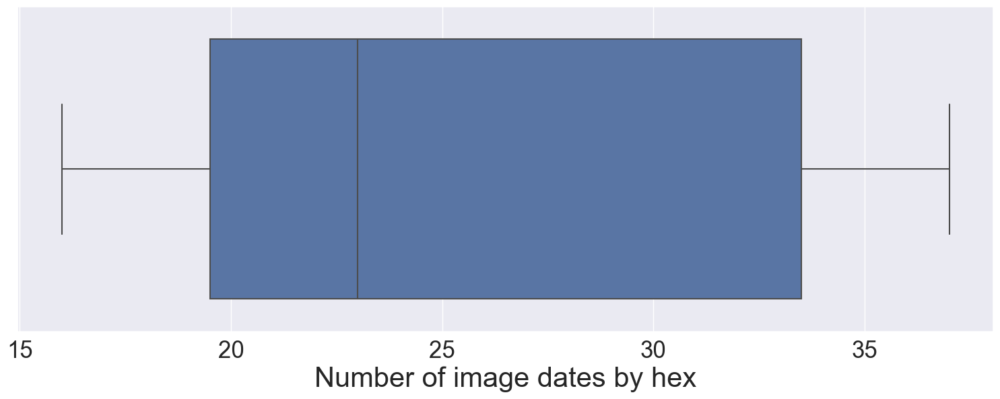

In [8]:
if visualization_level > 2:
    sns.set(rc={'figure.figsize':(18.7,6.27)})

    temporal_samples_count = df_positive.groupby(['hex'])['hex'].count()

    print('There are hexes with temporal samples from', temporal_samples_count.min(), 'to', temporal_samples_count.max())

    hist = pd.DataFrame(temporal_samples_count) \
            .rename(columns={'hex': 'count'}) \
            .reset_index(level=0) \
            .groupby(['count'])['count'].count()

    hist_df = pd.DataFrame(hist) \
              .rename(columns={'count': 'frequency'}) \
              .reset_index(level=0)

    #so.Plot(hist_df["count"], hist_df["frequency"]) \
    #    .add(so.Bar()) \
    #    .scale(x=so.Continuous().tick(every=2)) \
    #    .layout(size=(10, 4))

    ax = sns.boxplot(x=hist_df["count"])

    ax.set_xlabel("Number of image dates by hex",fontsize=30)
    ax.tick_params(labelsize=25)

## Sentinel 2 bands
These are the 12 bands contained in the parque files and their respective meanings

<div>
<img src="../res/sentinel2-bands.png" width="500"/>
</div>

## 1.5 Show some of the L12 hexes loaded in the folium map

In [9]:
if train_only_on_accurate_samples:
    # Drop hexes from non-conclusive areas
    drop_list = np.loadtxt('drop_list.csv', delimiter=',', dtype='str')

    df_negative = df_negative[~df_negative['hex'].isin(drop_list)]
    df_positive = df_positive[~df_positive['hex'].isin(drop_list)]
    
    # Treat false negatives
    false_negatives = np.loadtxt('false_negatives.csv', delimiter=',', dtype='str')

    df_negative = df_negative.assign(label=0)
    df_positive = df_positive.assign(label=1)
    
    df_negative = df_negative.reset_index()
    df_positive = df_positive.reset_index()
    
    # Assign to negatives recognized as false the label 1
    df_negative.loc[df_negative['hex'].isin(false_negatives), 'label'] = 1

    df_positive = pd.concat([df_positive, df_negative[df_negative.label==1]])
    
    df_negative = df_negative.drop(df_negative[df_negative.label == 1].index)
    print('Training dataset on manually curated samples.')

Training dataset on manually curated samples.


In [10]:
if generate_paper_info:
    for index, f in enumerate(df_positive.FIELD_OPERATION_GUID.unique()):
        print('F{:02d}'.format(index+1) +
              '&'+
              f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.nunique():,}' +
              '&'+
              f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.nunique()}' +
              '&'+
              f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.count():,}' +
              '&'+
              f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.count():,}' +
              '&'+
              '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().mean()) +
              '&'+
              '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().std()) +
              '\\\\'
             )


F01&563&205&9,948&3,451&17.67&0.48\\
F02&738&147&14,319&2,786&19.40&0.73\\
F03&68&66&1,243&1,184&18.28&0.64\\
F04&360&139&8,558&3,263&23.77&0.49\\
F05&75&134&1,815&3,001&24.20&0.90\\
F06&297&49&5,160&848&17.37&0.68\\
F07&419&139&9,430&2,929&22.51&0.70\\
F08&426&153&8,604&3,064&20.20&0.82\\
F09&147&127&2,993&2,563&20.36&0.71\\
F10&366&176&6,919&3,194&18.90&0.40\\
F11&228&56&4,813&1,154&21.11&0.59\\
F12&89&96&1,665&1,738&18.71&0.50\\
F13&151&86&3,271&1,840&21.66&0.49\\
F14&275&216&4,871&3,825&17.71&0.46\\
F15&370&198&7,369&3,913&19.92&0.66\\
F16&271&25&5,030&413&18.56&0.69\\
F17&281&17&5,099&297&18.15&0.97\\


## 1.6 Display hexes in the map

In [11]:
import io
from PIL import Image

def display_hexes_map(df, hexes_to_print=5000, filename=None):

    h3_hex = h3.h3_to_parent(df.iloc[0]['hex'], 3)

    df = df.drop_duplicates(subset='hex', keep="first").head(hexes_to_print)
    
    min_lat, min_long = 9999999,9999999
    max_lat, max_long = -9999999,-9999999
    
    
    for h in df.hex:
        p = h3.h3_to_geo(h)
        
        if p[0] < min_lat:
            min_lat = p[0]
            
        if p[0] > max_lat:
            max_lat = p[0]
            
        if p[1] < min_long:
            min_long = p[1]
            
        if p[1] > max_long:
            max_long = p[1]
            
    bounds = [[min_lat, min_long], [max_lat, max_long]]
    print(bounds)

    m = folium.Map(
                    tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                    attr = 'Esri',
                    name = 'Esri Satellite',
                    zoom_start=11,
                    fit_bounds=[[-97.7198928194847,26.236073089251086],[-97.66473848550342,26.243580591892144]],
                    overlay = False,
                    control = True)

    # Print h3 hex
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=h3_hex,geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'white', 'color': 'white', 'weight': 0.5})
    geo_j.add_to(m)

    # Print positive samples
    for index, row in df.iterrows():
        geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
        if row['label'] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'yellow', 'color': 'green', 'weight': 0.5})
        elif row['label'] == 0:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'black', 'weight': 0.5})
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
        folium.Popup(str(row['FIELD_OPERATION_GUID']) + ' ' + str(row['hex'])).add_to(geo_j)
        geo_j.add_to(m)


    m.fit_bounds(bounds)
    
    display(m)
    
    if filename is not None:
        img_data = m._to_png(5)
        img = Image.open(io.BytesIO(img_data))
        img.save(filename)

# 1.7 Visualize the samples in the space reduced to 2 dimensions

In [12]:
def generate_samples_season(dfp, dfn):

    # Associate labels picked manually
    dfn = dfn.assign(label=0)
    dfp = dfp.assign(label=1)
    df = pd.concat([dfp, dfn], axis=0)

    df = df.reset_index()

    df['datetime'] = pd.to_datetime(df['timestamp'], format="%Y%m%dT%H%M%S")

    print('Number of total rows:' +  str(len(df.index)))
    print('Number of rows in positive dataset:' +  str(len(dfp.index)))
    print('Number of rows in negative dataset:' +  str(len(dfp.index)))
    print('Number of unique positive hexes:' +  str(dfp.hex.nunique()))
    print('Number of unique negative hexes:' +  str(dfn.hex.nunique()))


    df[band_features] = StandardScaler().fit_transform(df[band_features])

    # Organize the 2D samples in numpy arrays
    band_values_tmp = np.zeros((temporal_samples*10, number_of_bands), dtype=np.float64)
    X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

    labels = []
    hexes = []
    fop = []
    timestamp_tracking = []
    timestamp_sample = []

    sub_index = 0
    count = 0;
    display(df.shape)

    
    for h in df.hex.unique():
        pct_complete = count/df.hex.nunique() * 100
        print('Sampling {0:.2f}'.format(pct_complete) + '%', end='\r')
        count = count + 1
        
        hexdf = df[df.hex == h]
        
        #display(hexdf)
        
        for index, row in hexdf.iterrows():
            # fill the band values in a temporal row
            for idx,b in enumerate(band_features):
                band_values_tmp[sub_index][idx] = row[b]    

            timestamp_sample.append(row.timestamp)

            # increment row number 
            sub_index = sub_index + 1


        try:
            debug = 'winter'
            timestamp_sample_aux = []
            winter_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 1 and int(s[4:6]) <= 3]
            winter_samples = np.random.choice(winter_samples, size=4)
            winter_array = np.array(band_values_tmp)[winter_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in winter_samples])

            debug = 'spring'
            spring_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 4 and int(s[4:6]) <= 6]
            spring_samples = np.random.choice(spring_samples, size=4)
            spring_array = np.array(band_values_tmp)[spring_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in spring_samples])

            debug = 'summer'
            summer_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 7 and int(s[4:6]) <= 9]
            summer_samples = np.random.choice(summer_samples, size=4)
            summer_array = np.array(band_values_tmp)[summer_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in summer_samples])

            debug = 'fall'
            fall_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 10 and int(s[4:6]) <= 12]
            fall_samples = np.random.choice(fall_samples, size=4)
            fall_array = np.array(band_values_tmp)[fall_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in fall_samples])

            timestamp_sample = timestamp_sample_aux

            sample = np.concatenate((winter_array, spring_array, summer_array, fall_array), axis=0)
        except Exception as e:
            print(debug, str(e))
            pass

        X_array = np.append(X_array, [sample], axis=0)
        labels.append(row.label)
        hexes.append(row.hex)
        fop.append(row.FIELD_OPERATION_GUID)
        timestamp_tracking.append(timestamp_sample.copy())            

        timestamp_sample.clear()
        sub_index = 0


    sorted_indices = np.argsort(hexes)
    hexes = np.array(hexes)[sorted_indices]
    labels = np.array(labels)[sorted_indices]
    X_array = X_array[sorted_indices]
    fop = np.array(fop)[sorted_indices]
    timestamp_tracking = np.array(timestamp_tracking)[sorted_indices]
    df = df.sort_values(by=['hex'])

    return df, X_array, labels, hexes, fop, timestamp_tracking


def generate_samples_shuffle(dfp, dfn):
    dfp = dfp.sort_values(by=['hex'])
    dfp = dfp.groupby('hex').head(temporal_samples)

    dfn = dfn.sort_values(by=['hex'])
    dfn = dfn.groupby('hex').head(temporal_samples)
    
    # Associate labels picked manually
    dfn = dfn.assign(label=0)
    dfp = dfp.assign(label=1)
    df = pd.concat([dfp, dfn], axis=0)

    df = df.reset_index()

    df[band_features] = StandardScaler().fit_transform(df[band_features])

    # Organize the 2D samples in numpy arrays
    sample = np.zeros((temporal_samples, number_of_bands), dtype=np.float64)
    X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

    labels = []
    hexes = []
    fop = []
    timestamp_tracking = []
    timestamp_sample = []

    sub_index = 0
    count = 0;
    
    for index, row in df.iterrows():
        pct_complete = count/df.shape[0] * 100
        print('Sampling {0:.2f}'.format(pct_complete) + '%', end='\r')
        count = count + 1

        # fill the band values in a temporal row
        for idx,b in enumerate(band_features):
            sample[sub_index][idx] = row[b]

        timestamp_sample.append(row.timestamp)

        # increment row number 
        sub_index = sub_index + 1

        # if reached last row of temporal samples, increment to next sample
        if sub_index == temporal_samples:
            shuffler = np.random.permutation(sample.shape[0])
            sample = sample[shuffler]
            timestamp_sample = list(np.array(timestamp_sample)[shuffler])
                
            X_array = np.append(X_array, [sample], axis=0)
            labels.append(row.label)
            hexes.append(row.hex)
            fop.append(row.FIELD_OPERATION_GUID)
            timestamp_tracking.append(timestamp_sample.copy())            

            timestamp_sample.clear()
            sub_index = 0
            
    sorted_indices = np.argsort(hexes)
    hexes = np.array(hexes)[sorted_indices]
    labels = np.array(labels)[sorted_indices]
    X_array = X_array[sorted_indices]
    fop = np.array(fop)[sorted_indices]
    timestamp_tracking = np.array(timestamp_tracking)[sorted_indices]
    df = df.sort_values(by=['hex'])
    
    return df, X_array, labels, hexes, fop, timestamp_tracking


if sampling_method == 'season':
    df, X_array, labels, hexes, fop, timestamp_tracking = generate_samples_season(df_positive, df_negative)
elif sampling_method == 'shuffle':
    df, X_array, labels, hexes, fop, timestamp_tracking = generate_samples_shuffle(df_positive, df_negative)
else:
    raise Exception('You need to select a sampling method')
    
print(X_array.shape)
print(len(labels))
print(len(hexes))

(7097, 16, 12)0%
7097
7097


In [13]:
df_total = df.groupby(['FIELD_OPERATION_GUID'])['FIELD_OPERATION_GUID'].count()
df_unique = df.groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_nunique = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()
df_punique = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_ncount = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].count()
df_pcount = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].count()

for i in range(0,17):
    print('F{:02d}&'.format(i+1) + '{:,}'.format(df_total[i]) + '&' + '{:,}'.format(df_pcount[i]) + '&' + 
          '{:,}'.format(df_ncount[i]) + '&' + '{:,}'.format(df_punique[i]) + '&' + '{:,}'.format(df_nunique[i]) +
          '&' + '{:.2f}'.format(df_total[i]/df_unique[i]) + '\\\\')

F01&4,731&4,336&395&271&25&15.98\\
F02&12,268&9,008&3,260&563&205&15.97\\
F03&14,076&11,777&2,299&738&147&15.91\\
F04&3,792&2,416&1,376&151&86&16.00\\
F05&1,906&983&923&68&66&14.22\\
F06&7,984&5,760&2,224&360&139&16.00\\
F07&7,856&4,400&3,456&275&216&16.00\\
F08&3,344&1,200&2,144&75&134&16.00\\
F09&5,183&4,598&585&297&49&14.98\\
F10&9,086&5,920&3,166&370&198&16.00\\
F11&4,764&4,492&272&281&17&15.99\\
F12&8,928&6,704&2,224&419&139&16.00\\
F13&9,264&6,816&2,448&426&153&16.00\\
F14&4,384&2,352&2,032&147&127&16.00\\
F15&8,584&5,824&2,760&366&176&15.84\\
F16&4,544&3,648&896&228&56&16.00\\
F17&2,868&1,392&1,476&89&96&15.50\\


## 1.8 TSNE Visualization BEFORE encoding

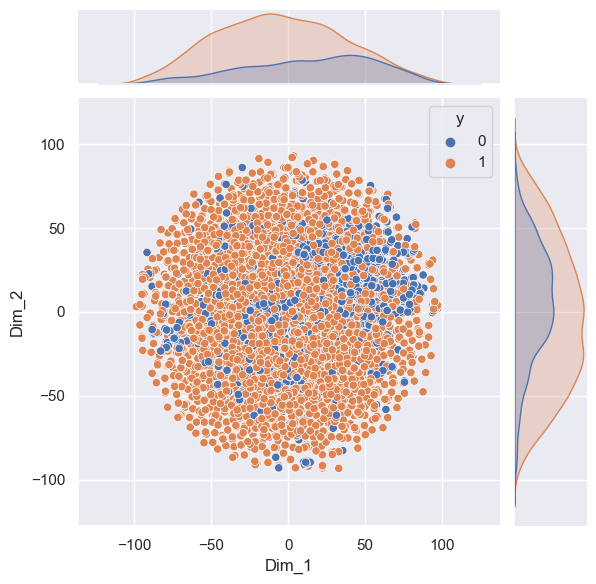

In [14]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings

if visualization_level > 2:
    warnings.filterwarnings('ignore')
    model = TSNE(n_components=2, perplexity=4, random_state=0)
    tsne_data = model.fit_transform(X_array.reshape(X_array.shape[0], number_of_bands * temporal_samples))
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))
    tsne_data = pd.concat([tsne_df, pd.DataFrame(labels, columns=['y'])], axis=1)
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "y"))

    sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
    plt.show()
    warnings.filterwarnings('default')

## 1.9 Sample visualization

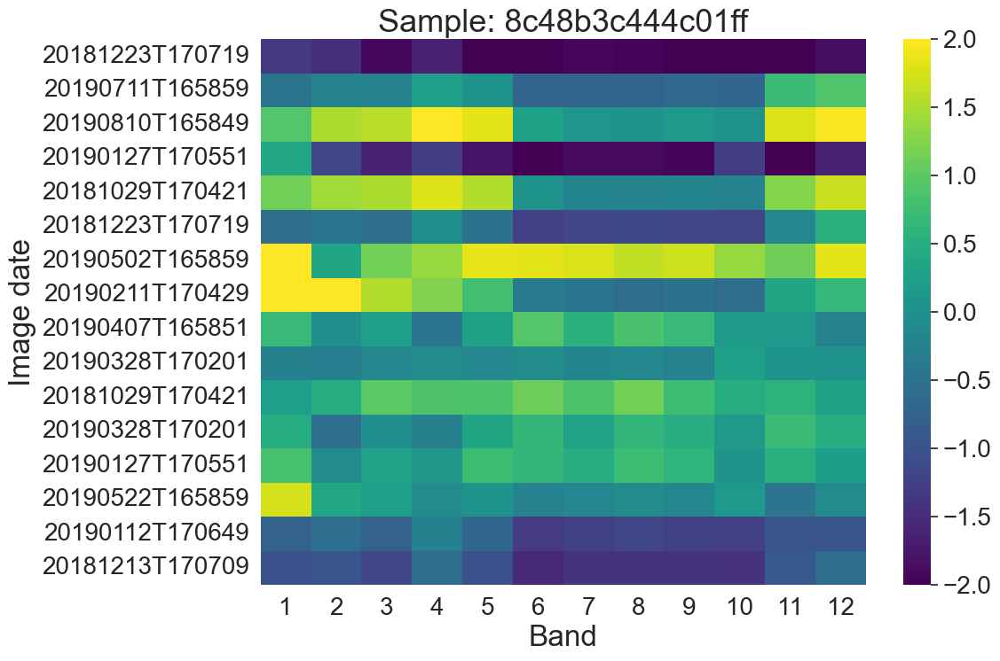

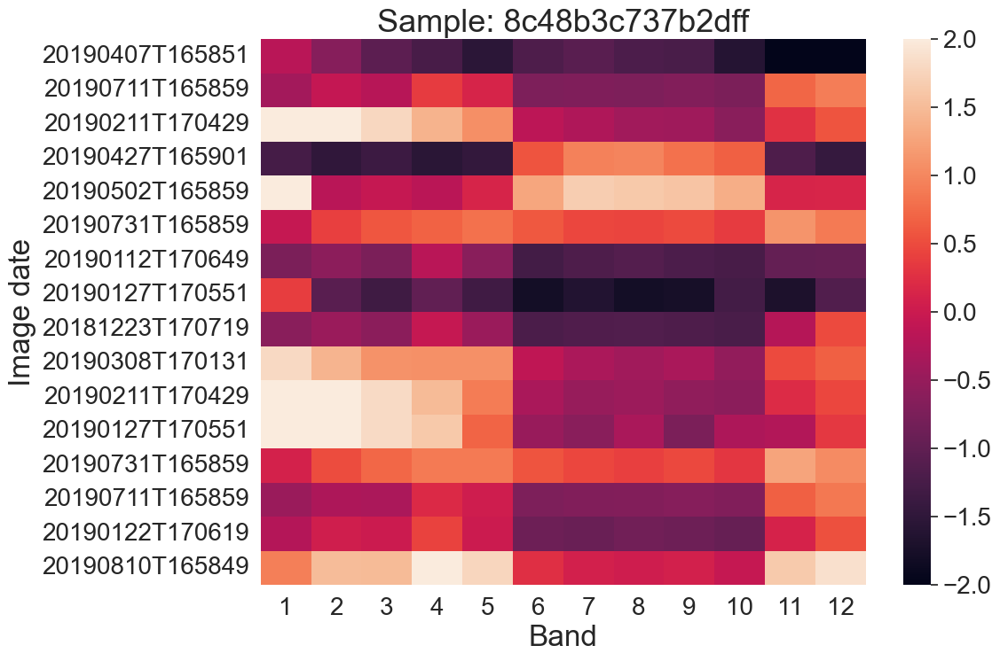

In [15]:
if visualization_level > 2:
    sns.set(rc={'figure.figsize':(11,8)})

    for i in range(0,1):
        # This is what a positive sample looks like
        xticklabels = range(1,13)
        yticklabels = range(1,16)
        yticklabels = timestamp_tracking[i]
        ax = sns.heatmap(X_array[i], annot=False, cmap="viridis", vmin=-2, vmax=2, 
                         xticklabels=xticklabels, yticklabels=yticklabels, 
                         fmt='g', annot_kws={"fontsize":24}, cbar=True)
        ax.set_xlabel("Band",fontsize=24)
        ax.set_ylabel("Image date",fontsize=24)
        ax.set_title('Sample: ' + hexes[i], fontsize=26)
        ax.tick_params(labelsize=20)

        cbar = ax.collections[0].colorbar
        cbar.ax.tick_params(labelsize=20)
        plt.show()



    for i in range(-2,-1):
        xticklabels = range(1,13)
        yticklabels = range(1,16)
        yticklabels = timestamp_tracking[i]
        ax = sns.heatmap(X_array[i], annot=False, cmap="rocket", vmin=-2, vmax=2, 
                         xticklabels=xticklabels, yticklabels=yticklabels, 
                         fmt='g', annot_kws={"fontsize":20}, cbar=True)
        ax.set_xlabel("Band",fontsize=24)
        ax.set_ylabel("Image date",fontsize=24)
        ax.set_title('Sample: ' + hexes[i], fontsize=26)
        ax.tick_params(labelsize=20)

        cbar = ax.collections[0].colorbar
        cbar.ax.tick_params(labelsize=20)
        plt.show()

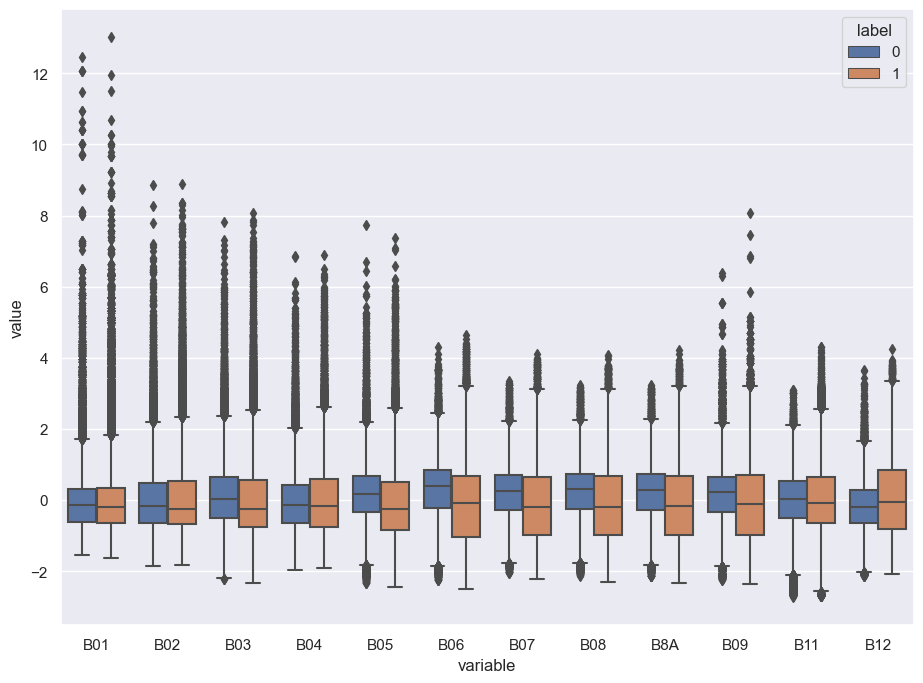

In [16]:
import pandas as pd
import seaborn as sns

if visualization_level > 2:
    value_vars = [i for i in df.columns if i.startswith('B')]
    id_vars = ['label']
    data = pd.melt(df, id_vars=id_vars, value_vars=value_vars)

    sns.set(rc={'figure.figsize':(11,8)})
    sns.boxplot(x="variable", y="value", hue='label', data=data)

# 1.10 Check correlation among bands

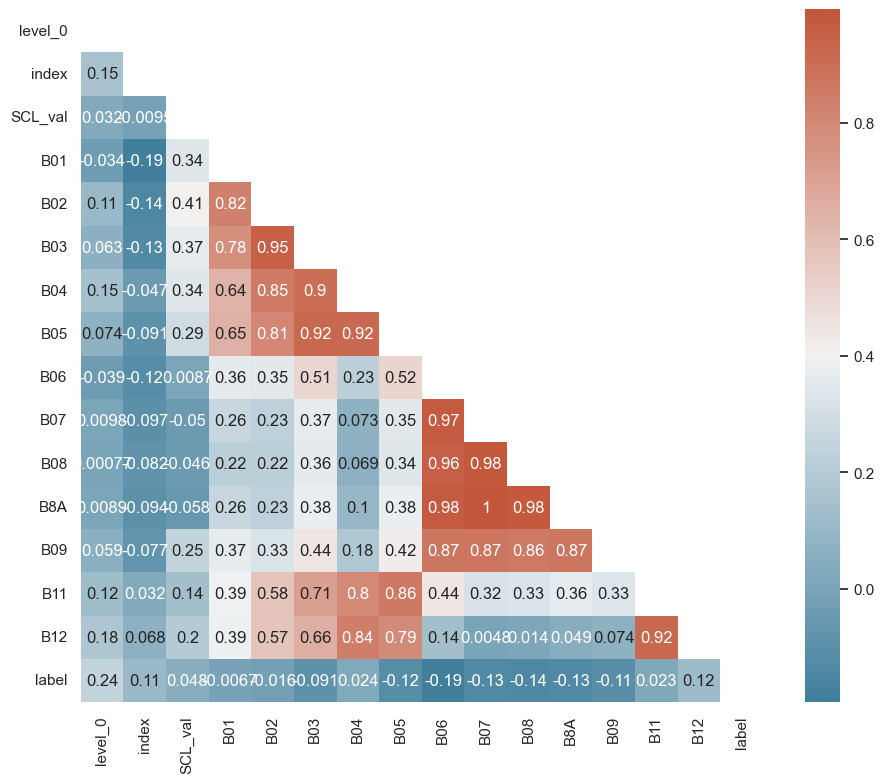

In [17]:
if visualization_level > 2:
    sns.set_theme(style="white")
    # Compute the correlation matrix
    corr = df.corr()

    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(11, 9))

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    sns.heatmap(corr,mask=mask,cmap=cmap, annot=True )

<a id='model_training'></a>

# 2. Contrastive Learning Model Training

<div>
<img border="5px" src="../res/modeltraining.png" width="1000"/>
</div>

## 2.1 Prepare the Dataset

In [18]:
#labels_and_hexes = np.vstack((hexes, labels)).T



#def prepare_training_dataset(test_index, val_index):
#
#    X_train = X_array[~(test_index + val_index)]
#   yl_train = labels_and_hexes[~(test_index + val_index)]
#    fop_train = fop[~(test_index + val_index)]
#    
#
#    X_test = X_array[test_index]
#    yl_test = labels_and_hexes[test_index]
#    fop_test = fop[test_index]

#    X_val = X_array[val_index]
#    yl_val = labels_and_hexes[val_index]
#    fop_val = fop[val_index]

#    hexes_train, y_train = np.hsplit(yl_train, 2)
#    hexes_test, y_test = np.hsplit(yl_test, 2)
#    hexes_val, y_val = np.hsplit(yl_val, 2)

#    y_val = np.array(y_val).T[0]
#    y_test = np.array(y_test).T[0]
#    y_train = np.array(y_train).T[0]
#    hexes_val = np.array(hexes_val).T[0]
#    hexes_test = np.array(hexes_test).T[0]
#    hexes_train = np.array(hexes_train).T[0]

#    y_train = y_train.astype(np.int)
#    y_test = y_test.astype(np.int)
#    y_val = y_val.astype(np.int)

#    print(X_train.shape, X_test.shape, X_val.shape)
#    return X_train, y_train, hexes_train, fop_train, X_test, y_test, hexes_test, fop_test, X_val, y_val, hexes_val, fop_val
    
#X_train, y_train, hexes_train, fop_train, X_test, y_test, hexes_test, fop_test, X_val, y_val, hexes_val, fop_val = prepare_training_dataset(test_index, val_index)



In [19]:
def prepare_dataset(test_index, val_index):   
    X_train = X_array[~(test_index + val_index)]
    y_train = labels[~(test_index + val_index)]
    hexes_train = hexes[~(test_index + val_index)]
    fop_train = fop[~(test_index + val_index)]
    
    X_test = X_array[test_index]
    y_test = labels[test_index]
    hexes_test = hexes[test_index]
    fop_test = fop[test_index]

    X_val = X_array[val_index]
    y_val = labels[val_index]
    hexes_val = hexes[val_index]
    fop_val = fop[val_index] 

    #y_train = y_train.astype(np.int)
    #y_test = y_test.astype(np.int)
    #y_val = y_val.astype(np.int)
    
    labeled_train_samples = X_train.shape[0]
    
    labeled_batch_size = labeled_train_samples // steps_per_epoch
    batch_size = labeled_batch_size
 
    train_dataset = tf.data.Dataset\
        .from_tensor_slices((X_train, y_train))\
        .shuffle(buffer_size=10 * labeled_batch_size)\
        .batch(labeled_batch_size)
    
    test_dataset = tf.data.Dataset\
        .from_tensor_slices((X_test, y_test))\
        .batch(batch_size)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    
    validation_dataset = tf.data.Dataset\
        .from_tensor_slices((X_val, y_val))\
        .batch(5)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    


    return batch_size, train_dataset, test_dataset, validation_dataset, X_test, y_test, hexes_test, fop_test

    
field_index = 0
test_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index]
val_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index+1]
    
test_index = np.array(fop) == test_field
val_index = np.array(fop) == val_field

batch_size, train_dataset, test_dataset, validation_dataset, X_test, y_test, hexes_test, fop_test = prepare_dataset(test_index, val_index)

In [20]:
# Distorts the color distibutions of images
class RandomAugmentSatelliteBands(layers.Layer):
    def __init__(self, jitter=0, **kwargs):
        super().__init__(**kwargs)

        self.jitter = jitter

    def get_config(self):
        config = super().get_config()
        config.update({"jitter": self.jitter})
        return config

    def call(self, images, training=True):
        if training:
            batch_size = tf.shape(images)[0]
            
            
            # jitter colors
            jitter_matrices = tf.random.uniform(
                (batch_size, temporal_samples, 1), minval=1 - self.jitter, maxval=1 + self.jitter
            )
            
            jitter_matrices = tf.concat([jitter_matrices]*number_of_bands, axis=2)
            
            
            
            images = tf.round(images * jitter_matrices)
            
            # shuffle dates
            #images = tf.random.shuffle(tf.transpose(images, [1, 0, 2]))
            #images = tf.transpose(images, [1, 0, 2])
            
            
        return images

# Define the encoder architecture
def get_encoder():
    return keras.Sequential(
        [
            keras.Input(shape=(temporal_samples, number_of_bands)),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Flatten(),
            layers.Dense(width, activation="relu"),
        ],
        name="encoder",
    )

# Image augmentation module
def get_augmenter(jitter):
    return keras.Sequential(
        [
            keras.Input(shape=(temporal_samples, number_of_bands)),
            RandomAugmentSatelliteBands(jitter),
        ]
    )


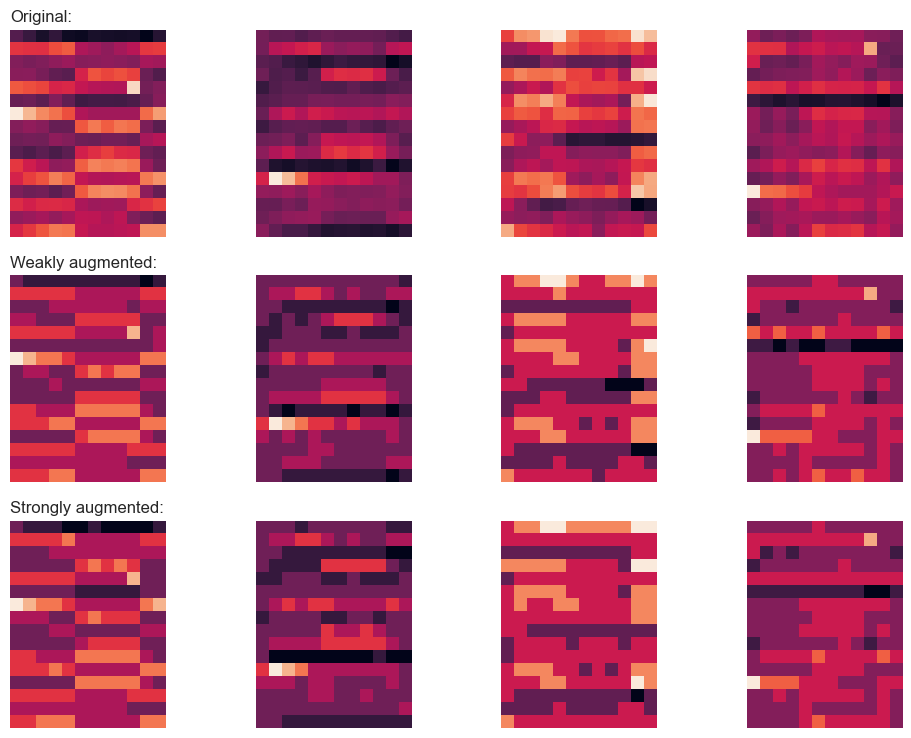

In [21]:
def visualize_augmentations(num_images):
    # Sample a batch from a dataset
    images = next(iter(train_dataset))[0][:num_images]

    # Apply augmentations
    augmented_images = zip(
        images,
        get_augmenter(**classification_augmentation)(images),
        get_augmenter(**contrastive_augmentation)(images),
    )
    row_titles = [
        "Original:",
        "Weakly augmented:",
        "Strongly augmented:",
    ]
    plt.figure(figsize=(num_images * 2.5, 4 * 2.5), dpi=100)
    for column, image_row in enumerate(augmented_images):
        for row, image in enumerate(image_row):
            plt.subplot(4, num_images, row * num_images + column + 1)
            plt.imshow(image)
            if column == 0:
                plt.title(row_titles[row], loc="left")
            plt.axis("off")
    plt.tight_layout()


visualize_augmentations(num_images=4)

In [22]:
# Baseline supervised training with random initialization
baseline_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        get_encoder(),
        layers.Dense(1, activation='sigmoid'),
    ],
    name="baseline_model",
)
baseline_model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)

baseline_history = baseline_model.fit(
    train_dataset, epochs=num_epochs, validation_data=validation_dataset
)

print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(baseline_history.history["val_acc"]) * 100
    )
)

Epoch 1/200
11/11 [==============================] - 1s 35ms/step - loss: 0.5884 - acc: 0.6665 - val_loss: 0.3591 - val_acc: 0.8362
Epoch 2/200
11/11 [==============================] - 0s 20ms/step - loss: 0.4391 - acc: 0.7224 - val_loss: 0.2823 - val_acc: 0.8487
Epoch 3/200
11/11 [==============================] - 0s 19ms/step - loss: 0.3076 - acc: 0.8848 - val_loss: 0.2543 - val_acc: 0.9192
Epoch 4/200
11/11 [==============================] - 0s 18ms/step - loss: 0.2476 - acc: 0.9163 - val_loss: 0.1610 - val_acc: 0.9420
Epoch 5/200
11/11 [==============================] - 0s 20ms/step - loss: 0.1825 - acc: 0.9363 - val_loss: 0.2372 - val_acc: 0.9272
Epoch 6/200
11/11 [==============================] - 0s 19ms/step - loss: 0.1296 - acc: 0.9574 - val_loss: 0.2597 - val_acc: 0.9272
Epoch 7/200
11/11 [==============================] - 0s 18ms/step - loss: 0.1135 - acc: 0.9639 - val_loss: 0.2272 - val_acc: 0.9317
Epoch 8/200
11/11 [==============================] - 0s 20ms/step - loss: 0.

11/11 [==============================] - 0s 19ms/step - loss: 0.0485 - acc: 0.9835 - val_loss: 0.1736 - val_acc: 0.9386
Epoch 63/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0438 - acc: 0.9846 - val_loss: 0.1554 - val_acc: 0.9420
Epoch 64/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0407 - acc: 0.9842 - val_loss: 0.1600 - val_acc: 0.9420
Epoch 65/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0396 - acc: 0.9857 - val_loss: 0.1637 - val_acc: 0.9420
Epoch 66/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0377 - acc: 0.9868 - val_loss: 0.1662 - val_acc: 0.9443
Epoch 67/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0378 - acc: 0.9855 - val_loss: 0.1597 - val_acc: 0.9454
Epoch 68/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0354 - acc: 0.9873 - val_loss: 0.1600 - val_acc: 0.9465
Epoch 69/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0317 

11/11 [==============================] - 0s 27ms/step - loss: 0.0024 - acc: 0.9994 - val_loss: 0.4208 - val_acc: 0.9386
Epoch 124/200
11/11 [==============================] - 0s 32ms/step - loss: 0.0037 - acc: 0.9996 - val_loss: 0.2516 - val_acc: 0.9590
Epoch 125/200
11/11 [==============================] - 0s 31ms/step - loss: 0.0029 - acc: 0.9996 - val_loss: 0.2693 - val_acc: 0.9568
Epoch 126/200
11/11 [==============================] - 0s 30ms/step - loss: 0.0030 - acc: 0.9993 - val_loss: 0.3384 - val_acc: 0.9454
Epoch 127/200
11/11 [==============================] - 0s 28ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.3425 - val_acc: 0.9465
Epoch 128/200
11/11 [==============================] - 0s 28ms/step - loss: 0.0016 - acc: 0.9996 - val_loss: 0.3101 - val_acc: 0.9522
Epoch 129/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0014 - acc: 0.9998 - val_loss: 0.3310 - val_acc: 0.9477
Epoch 130/200
11/11 [==============================] - 0s 30ms/step - loss: 

11/11 [==============================] - 0s 34ms/step - loss: 4.2321e-04 - acc: 1.0000 - val_loss: 0.3950 - val_acc: 0.9477
Epoch 184/200
11/11 [==============================] - 0s 33ms/step - loss: 2.8955e-04 - acc: 1.0000 - val_loss: 0.3503 - val_acc: 0.9545
Epoch 185/200
11/11 [==============================] - 0s 37ms/step - loss: 7.7782e-04 - acc: 0.9998 - val_loss: 0.4032 - val_acc: 0.9488
Epoch 186/200
11/11 [==============================] - 0s 36ms/step - loss: 3.1531e-04 - acc: 1.0000 - val_loss: 0.3846 - val_acc: 0.9511
Epoch 187/200
11/11 [==============================] - 0s 40ms/step - loss: 6.8080e-04 - acc: 0.9996 - val_loss: 0.4034 - val_acc: 0.9477
Epoch 188/200
11/11 [==============================] - 0s 38ms/step - loss: 4.2261e-04 - acc: 1.0000 - val_loss: 0.3699 - val_acc: 0.9534
Epoch 189/200
11/11 [==============================] - 0s 31ms/step - loss: 3.3685e-04 - acc: 1.0000 - val_loss: 0.4176 - val_acc: 0.9465
Epoch 190/200
11/11 [===========================

In [23]:
# Define the contrastive model with model-subclassing

class ContrastiveModel(keras.Model):
    def __init__(self):
        super().__init__()

        self.temperature = temperature
        self.contrastive_augmenter = get_augmenter(**contrastive_augmentation)
        self.classification_augmenter = get_augmenter(**classification_augmentation)
        self.encoder = get_encoder()

        
        # Non-linear MLP as projection head
        self.projection_head = keras.Sequential(
            [
                keras.Input(shape=(width,)),
                layers.Dense(width, activation="relu"),
                layers.Dense(width),
            ],
            name="projection_head",
        )
        # Single dense layer for linear probing
        self.linear_probe = keras.Sequential(
            [layers.Input(shape=(width,)), layers.Dense(1, activation='sigmoid')], name="linear_probe"
        )

        self.encoder.summary()
        self.projection_head.summary()
        self.linear_probe.summary()

    def compile(self, contrastive_optimizer, probe_optimizer, **kwargs):
        super().compile(**kwargs)

        self.contrastive_optimizer = contrastive_optimizer
        self.probe_optimizer = probe_optimizer

        # self.contrastive_loss will be defined as a method
        self.probe_loss = keras.losses.BinaryCrossentropy(from_logits=False)
        self.contrastive_loss_tracker = keras.metrics.Mean(name="c_loss")
        self.contrastive_accuracy = keras.metrics.BinaryAccuracy(name="c_acc")
        self.probe_loss_tracker = keras.metrics.Mean(name="p_loss")
        self.probe_accuracy = keras.metrics.BinaryAccuracy(name="p_acc")

    @property
    def metrics(self):
        return [
            self.contrastive_loss_tracker,
            self.contrastive_accuracy,
            self.probe_loss_tracker,
            self.probe_accuracy,
        ]

    def contrastive_loss(self, projections_1, projections_2):
        # InfoNCE loss (information noise-contrastive estimation)
        # NT-Xent loss (normalized temperature-scaled cross entropy)

        # Cosine similarity: the dot product of the l2-normalized feature vectors
        projections_1 = tf.math.l2_normalize(projections_1, axis=1)
        projections_2 = tf.math.l2_normalize(projections_2, axis=1)
        
        
        similarities = (
            tf.matmul(projections_1, projections_2, transpose_b=True) / self.temperature
        )        

        # The similarity between the representations of two augmented views of the
        # same hex should be higher than their similarity with other views
        batch_size = tf.shape(projections_1)[0]
    
        contrastive_labels = tf.range(batch_size)
        self.contrastive_accuracy.update_state(contrastive_labels, similarities)
        self.contrastive_accuracy.update_state(contrastive_labels, tf.transpose(similarities))

        # The temperature-scaled similarities are used as logits for cross-entropy
        # a symmetrized version of the loss is used here
        loss_1_2 = keras.losses.binary_crossentropy(
            contrastive_labels, similarities, from_logits=False
        )
        
        loss_2_1 = keras.losses.binary_crossentropy(
            contrastive_labels, tf.transpose(similarities), from_logits=False
        )
        
        
        return (loss_1_2 + loss_2_1) / 2

    def train_step(self, data):
        (labeled_images, labels) = data

        # Both labeled and unlabeled images are used, without labels
        images = labeled_images
        
        # Each image is augmented twice, differently
        augmented_images_1 = self.contrastive_augmenter(images, training=True)
        augmented_images_2 = self.contrastive_augmenter(images, training=True)
        
        with tf.GradientTape() as tape:
            features_1 = self.encoder(augmented_images_1, training=True)
            features_2 = self.encoder(augmented_images_2, training=True)
            # The representations are passed through a projection mlp
            projections_1 = self.projection_head(features_1, training=True)
            projections_2 = self.projection_head(features_2, training=True)
            contrastive_loss = self.contrastive_loss(projections_1, projections_2)
        gradients = tape.gradient(
            contrastive_loss,
            self.encoder.trainable_weights + self.projection_head.trainable_weights,
        )
        self.contrastive_optimizer.apply_gradients(
            zip(
                gradients,
                self.encoder.trainable_weights + self.projection_head.trainable_weights,
            )
        )
        self.contrastive_loss_tracker.update_state(contrastive_loss)

        # Labels are only used in evalutation for an on-the-fly logistic regression
        preprocessed_images = self.classification_augmenter(
            labeled_images, training=True
        )
        with tf.GradientTape() as tape:
            # the encoder is used in inference mode here to avoid regularization
            # and updating the batch normalization paramers if they are used
            features = self.encoder(preprocessed_images, training=False)
            class_logits = self.linear_probe(features, training=True)
            probe_loss = self.probe_loss(labels, class_logits)
        gradients = tape.gradient(probe_loss, self.linear_probe.trainable_weights)
        self.probe_optimizer.apply_gradients(
            zip(gradients, self.linear_probe.trainable_weights)
        )
        self.probe_loss_tracker.update_state(probe_loss)
        self.probe_accuracy.update_state(labels, class_logits)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, data):
        labeled_images, labels = data

        # For testing the components are used with a training=False flag
        preprocessed_images = self.classification_augmenter(
            labeled_images, training=False
        )
        features = self.encoder(preprocessed_images, training=False)
        class_logits = self.linear_probe(features, training=False)
        probe_loss = self.probe_loss(labels, class_logits)
        self.probe_loss_tracker.update_state(probe_loss)
        self.probe_accuracy.update_state(labels, class_logits)

        # Only the probe metrics are logged at test time
        return {m.name: m.result() for m in self.metrics[2:]}


# Contrastive pretraining
pretraining_model = ContrastiveModel()

pretraining_model.compile(
    contrastive_optimizer=keras.optimizers.Adam(),
    probe_optimizer=keras.optimizers.Adam(),
    run_eagerly=True
)

pretraining_history = pretraining_model.fit(
    train_dataset, epochs=num_epochs, validation_data=validation_dataset
)


print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(pretraining_history.history["val_p_acc"]) * 100
    )
)

Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_4 (Conv1D)            (None, 14, 45)            1665      
_________________________________________________________________
conv1d_5 (Conv1D)            (None, 12, 45)            6120      
_________________________________________________________________
conv1d_6 (Conv1D)            (None, 10, 45)            6120      
_________________________________________________________________
conv1d_7 (Conv1D)            (None, 8, 45)             6120      
_________________________________________________________________
flatten_1 (Flatten)          (None, 360)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 45)                16245     
Total params: 36,270
Trainable params: 36,270
Non-trainable params: 0
_______________________________________________________

11/11 [==============================] - 2s 194ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5622 - p_acc: 0.7251 - val_p_loss: 0.4914 - val_p_acc: 0.8364
Epoch 35/200
11/11 [==============================] - 2s 214ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.6411 - p_acc: 0.6344 - val_p_loss: 0.4897 - val_p_acc: 0.8364
Epoch 36/200
11/11 [==============================] - 2s 214ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5571 - p_acc: 0.7251 - val_p_loss: 0.4909 - val_p_acc: 0.8364
Epoch 37/200
11/11 [==============================] - 2s 190ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5722 - p_acc: 0.7251 - val_p_loss: 0.4894 - val_p_acc: 0.8364
Epoch 38/200
11/11 [==============================] - 2s 199ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.6639 - p_acc: 0.6344 - val_p_loss: 0.4881 - val_p_acc: 0.8364
Epoch 39/200
11/11 [==============================] - 2s 230ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.6

Epoch 80/200
11/11 [==============================] - 2s 216ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.6378 - p_acc: 0.6344 - val_p_loss: 0.4729 - val_p_acc: 0.8364
Epoch 81/200
11/11 [==============================] - 3s 281ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5521 - p_acc: 0.7251 - val_p_loss: 0.4748 - val_p_acc: 0.8364
Epoch 82/200
11/11 [==============================] - 3s 297ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5522 - p_acc: 0.7251 - val_p_loss: 0.4747 - val_p_acc: 0.8364
Epoch 83/200
11/11 [==============================] - 3s 287ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5602 - p_acc: 0.7251 - val_p_loss: 0.4739 - val_p_acc: 0.8364
Epoch 84/200
11/11 [==============================] - 3s 279ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5605 - p_acc: 0.7251 - val_p_loss: 0.4728 - val_p_acc: 0.8364
Epoch 85/200
11/11 [==============================] - 3s 269ms/step - c_loss: -4154.5444 - c_acc: 0.0018 

11/11 [==============================] - 3s 237ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5559 - p_acc: 0.7251 - val_p_loss: 0.4924 - val_p_acc: 0.8364
Epoch 126/200
11/11 [==============================] - 3s 242ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5566 - p_acc: 0.7251 - val_p_loss: 0.4907 - val_p_acc: 0.8364
Epoch 127/200
11/11 [==============================] - 2s 235ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5552 - p_acc: 0.7251 - val_p_loss: 0.4882 - val_p_acc: 0.8364
Epoch 128/200
11/11 [==============================] - 3s 288ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5654 - p_acc: 0.7251 - val_p_loss: 0.4855 - val_p_acc: 0.8364
Epoch 129/200
11/11 [==============================] - 3s 292ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5560 - p_acc: 0.7251 - val_p_loss: 0.4828 - val_p_acc: 0.8364
Epoch 130/200
11/11 [==============================] - 3s 291ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss

11/11 [==============================] - 2s 189ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5479 - p_acc: 0.7251 - val_p_loss: 0.4761 - val_p_acc: 0.8364
Epoch 171/200
11/11 [==============================] - 2s 204ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5487 - p_acc: 0.7251 - val_p_loss: 0.4747 - val_p_acc: 0.8364
Epoch 172/200
11/11 [==============================] - 2s 219ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.6191 - p_acc: 0.6344 - val_p_loss: 0.4736 - val_p_acc: 0.8364
Epoch 173/200
11/11 [==============================] - 2s 197ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5420 - p_acc: 0.7251 - val_p_loss: 0.4747 - val_p_acc: 0.8364
Epoch 174/200
11/11 [==============================] - 2s 198ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss: 0.5566 - p_acc: 0.7251 - val_p_loss: 0.4744 - val_p_acc: 0.8364
Epoch 175/200
11/11 [==============================] - 2s 202ms/step - c_loss: -4154.5444 - c_acc: 0.0018 - p_loss

# Encoding a few samples

In [24]:
# Encoder for validation
encoder_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        pretraining_model.encoder,
    ],
    name="encoder_model",
)

encoded_vectors = encoder_model.predict(X_test)

print(encoded_vectors.shape)


(767, 45)


# Visualization of the encoded samples in the XY space

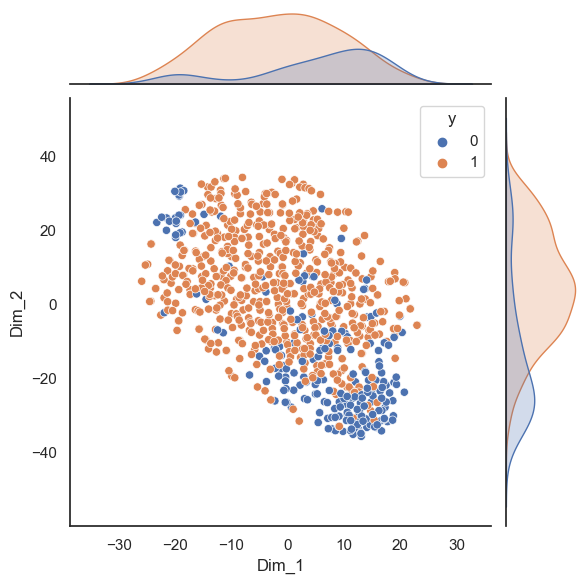

In [25]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings


warnings.filterwarnings('ignore')
model = TSNE(n_components=2, random_state=0)
tsne_data = model.fit_transform(encoded_vectors)
tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))

tsne_df = pd.concat([tsne_df, pd.DataFrame(y_test, columns=['y'])], axis=1)

sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
plt.show()
warnings.filterwarnings('default')

## Finetuning model

In [26]:
# Supervised finetuning of the pretrained encoder
finetuning_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        pretraining_model.encoder,
        layers.Dense(1, activation='sigmoid'),
    ],
    name="finetuning_model",
)
finetuning_model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)

finetuning_history = finetuning_model.fit(
    train_dataset, epochs=num_epochs, validation_data=test_dataset
)
print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(finetuning_history.history["val_acc"]) * 100
    )
)

Epoch 1/200
11/11 [==============================] - 1s 30ms/step - loss: 0.5799 - acc: 0.6889 - val_loss: 0.4747 - val_acc: 0.7340
Epoch 2/200
11/11 [==============================] - 0s 15ms/step - loss: 0.4432 - acc: 0.7347 - val_loss: 0.3954 - val_acc: 0.8175
Epoch 3/200
11/11 [==============================] - 0s 17ms/step - loss: 0.2901 - acc: 0.8892 - val_loss: 0.2388 - val_acc: 0.9009
Epoch 4/200
11/11 [==============================] - 0s 17ms/step - loss: 0.2084 - acc: 0.9244 - val_loss: 0.1042 - val_acc: 0.9674
Epoch 5/200
11/11 [==============================] - 0s 19ms/step - loss: 0.1466 - acc: 0.9540 - val_loss: 0.0809 - val_acc: 0.9739
Epoch 6/200
11/11 [==============================] - 0s 16ms/step - loss: 0.1168 - acc: 0.9606 - val_loss: 0.0901 - val_acc: 0.9739
Epoch 7/200
11/11 [==============================] - 0s 18ms/step - loss: 0.1009 - acc: 0.9657 - val_loss: 0.0928 - val_acc: 0.9700
Epoch 8/200
11/11 [==============================] - 0s 22ms/step - loss: 0.

11/11 [==============================] - 0s 17ms/step - loss: 0.0126 - acc: 0.9972 - val_loss: 0.0623 - val_acc: 0.9831
Epoch 63/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0144 - acc: 0.9949 - val_loss: 0.0586 - val_acc: 0.9831
Epoch 64/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0163 - acc: 0.9949 - val_loss: 0.0623 - val_acc: 0.9817
Epoch 65/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0117 - acc: 0.9971 - val_loss: 0.0764 - val_acc: 0.9817
Epoch 66/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0093 - acc: 0.9985 - val_loss: 0.0673 - val_acc: 0.9831
Epoch 67/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0093 - acc: 0.9982 - val_loss: 0.0763 - val_acc: 0.9804
Epoch 68/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0067 - acc: 0.9985 - val_loss: 0.0790 - val_acc: 0.9831
Epoch 69/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0067 

11/11 [==============================] - 0s 12ms/step - loss: 8.6556e-04 - acc: 0.9998 - val_loss: 0.1147 - val_acc: 0.9778
Epoch 124/200
11/11 [==============================] - 0s 12ms/step - loss: 9.2399e-04 - acc: 0.9998 - val_loss: 0.1194 - val_acc: 0.9778
Epoch 125/200
11/11 [==============================] - 0s 15ms/step - loss: 8.1651e-04 - acc: 0.9998 - val_loss: 0.1216 - val_acc: 0.9739
Epoch 126/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0057 - acc: 0.9982 - val_loss: 0.0884 - val_acc: 0.9804
Epoch 127/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0082 - acc: 0.9978 - val_loss: 0.1064 - val_acc: 0.9752
Epoch 128/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0063 - acc: 0.9982 - val_loss: 0.1417 - val_acc: 0.9700
Epoch 129/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0021 - acc: 0.9993 - val_loss: 0.1044 - val_acc: 0.9791
Epoch 130/200
11/11 [==============================] - 0s 15ms/s

Epoch 183/200
11/11 [==============================] - 0s 12ms/step - loss: 3.6671e-04 - acc: 1.0000 - val_loss: 0.1113 - val_acc: 0.9791
Epoch 184/200
11/11 [==============================] - 0s 10ms/step - loss: 9.7642e-04 - acc: 0.9996 - val_loss: 0.1105 - val_acc: 0.9791
Epoch 185/200
11/11 [==============================] - 0s 12ms/step - loss: 7.8741e-04 - acc: 0.9998 - val_loss: 0.1848 - val_acc: 0.9791
Epoch 186/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0015 - acc: 0.9993 - val_loss: 0.1755 - val_acc: 0.9700
Epoch 187/200
11/11 [==============================] - 0s 10ms/step - loss: 6.7108e-04 - acc: 0.9996 - val_loss: 0.1263 - val_acc: 0.9752
Epoch 188/200
11/11 [==============================] - 0s 12ms/step - loss: 4.1212e-04 - acc: 0.9998 - val_loss: 0.1353 - val_acc: 0.9791
Epoch 189/200
11/11 [==============================] - 0s 12ms/step - loss: 4.3901e-04 - acc: 1.0000 - val_loss: 0.1075 - val_acc: 0.9791
Epoch 190/200
11/11 [=================

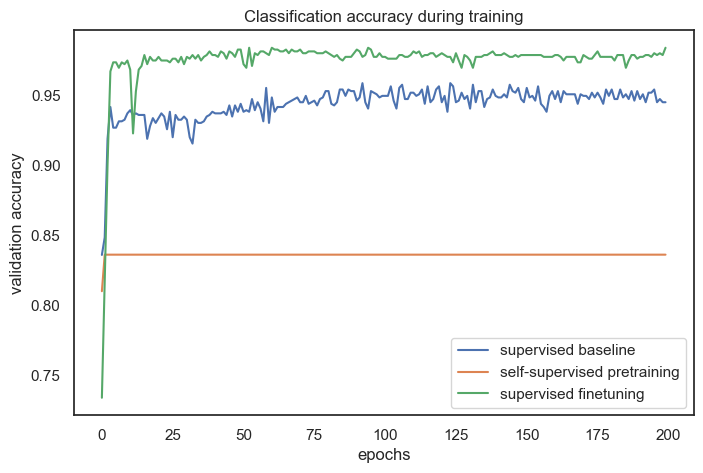

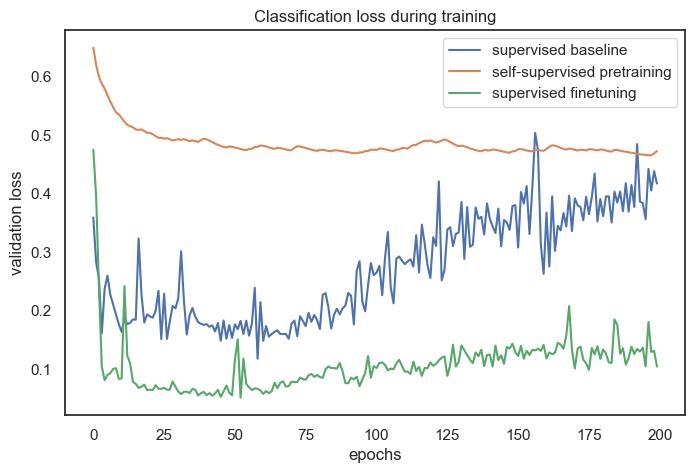

In [27]:
# The classification accuracies of the baseline and the pretraining + finetuning process:
def plot_training_curves(pretraining_history, finetuning_history, baseline_history):
    for metric_key, metric_name in zip(["acc", "loss"], ["accuracy", "loss"]):
        plt.figure(figsize=(8, 5), dpi=100)
        plt.plot(
            baseline_history.history[f"val_{metric_key}"], label="supervised baseline"
        )
        plt.plot(
            pretraining_history.history[f"val_p_{metric_key}"],
            label="self-supervised pretraining",
        )
        plt.plot(
            finetuning_history.history[f"val_{metric_key}"],
            label="supervised finetuning",
        )
        plt.legend()
        plt.title(f"Classification {metric_name} during training")
        plt.xlabel("epochs")
        plt.ylabel(f"validation {metric_name}")


plot_training_curves(pretraining_history, finetuning_history, baseline_history)

# Summary Results

In [28]:
from sklearn.metrics import accuracy_score, recall_score, precision_score,f1_score,matthews_corrcoef
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

print(
    "Baseline maximal validation accuracy: {:.2f}%".format(
        max(baseline_history.history["val_acc"]) * 100
    )
)

print(
    "Training maximal validation accuracy: {:.2f}%".format(
        max(pretraining_history.history["val_p_acc"]) * 100
    )
)

print(
    "Finetuning maximal validation accuracy: {:.2f}%".format(
        max(finetuning_history.history["val_acc"]) * 100
    )
)

print('---------------')


output = baseline_model.predict(test_dataset)
result_baseline = np.where(output > 0.5, 1, 0)
print('Baseline Accuracy: {:.2f}%'.format(accuracy_score(y_test, result_baseline) * 100))
print('Baseline Recall: {:.2f}%'.format(recall_score(y_test, result_baseline) * 100))
print('Baseline Precision: {:.2f}%'.format(precision_score(y_test, result_baseline) * 100))
print('Baseline F1: {:.2f}%'.format(f1_score(y_test, result_baseline) * 100))
m = confusion_matrix(y_test, result_baseline)
print('Baseline Acc by Class', (m.diagonal()/m.sum(axis=1)))
print(confusion_matrix(y_test, result_baseline))
accuracy_list = (y_test==result_baseline.T[0])

print(
      '%.2f'  % (float(accuracy_score(y_test, result_baseline))*100) + '\\%&',
      '%.2f' % float(f1_score(y_test, result_baseline, average='weighted')*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result_baseline, average=None)[0]*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result_baseline, average=None)[1]*100)+ '\\%&',
      '%.2f' % matthews_corrcoef(y_test, result_baseline) + '\\\\',
     )

output = finetuning_model.predict(test_dataset)
result = np.where(output > 0.5, 1, 0)

print('Contrastive Accuracy: {:.2f}%'.format(accuracy_score(y_test, result) * 100))
print('Contrastive Recall: {:.2f}%'.format(recall_score(y_test, result) * 100))
print('Contrastive Precision: {:.2f}%'.format(precision_score(y_test, result) * 100))
print('Contrastive F1: {:.2f}%'.format(f1_score(y_test, result) * 100))
m = confusion_matrix(y_test, result)
print('Contrastive Acc by Class', (m.diagonal()/m.sum(axis=1)))
print(confusion_matrix(y_test, result))


print(
      '%.2f'  % (float(accuracy_score(y_test, result))*100) + '\\%&',
      '%.2f' % float(f1_score(y_test, result, average='weighted')*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result, average=None)[0]*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result, average=None)[1]*100)+ '\\%&',
      '%.2f' % matthews_corrcoef(y_test, result) + '\\\\',
     )

Baseline maximal validation accuracy: 95.90%
Training maximal validation accuracy: 83.64%
Finetuning maximal validation accuracy: 98.44%
---------------
Baseline Accuracy: 97.26%
Baseline Recall: 98.05%
Baseline Precision: 98.22%
Baseline F1: 98.13%
Baseline Acc by Class [0.95098039 0.98046181]
[[194  10]
 [ 11 552]]
97.26\%& 97.26\%& 94.87\%& 98.13\%& 0.93\\
Contrastive Accuracy: 98.44%
Contrastive Recall: 98.40%
Contrastive Precision: 99.46%
Contrastive F1: 98.93%
Contrastive Acc by Class [0.98529412 0.98401421]
[[201   3]
 [  9 554]]
98.44\%& 98.44\%& 97.10\%& 98.93\%& 0.96\\


In [29]:
# Test report
for i in range(0,len(df_positive.FIELD_OPERATION_GUID.unique())):
    
    tid = str(uuid.uuid4()).split('-')[0]
    
    description = 'Training with test on field ' + str(i) + ' and validation on field ' + str(i+1) + ' and test identifier ' + tid
    
    field_index = i
    test_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index]
    
    if field_index == (df_positive.FIELD_OPERATION_GUID.nunique()-1):
        val_field = df_positive.FIELD_OPERATION_GUID.unique()[0]
        description = 'Training with test on field ' + str(i) + ' and validation on field ' + '0' + ' and test identifier ' + tid
    else:    
        val_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index+1]
        description = 'Training with test on field ' + str(i) + ' and validation on field ' + str(i+1) + ' and test identifier ' + tid
            
    print('Test Field = ', test_field)
    print('Validation Field = ', val_field)
    
    test_index = np.array(fop) == test_field
    val_index = np.array(fop) == val_field
    print('The test field has number of hexes equals to ', sum(test_index))
    
    #X_train, y_train, hexes_train, fop_train, X_test, y_test, hexes_test, fop_test, X_val, y_val, hexes_val, fop_val = prepare_training_dataset(test_index, val_index)
    #labeled_train_samples = X_train.shape[0]
    
    batch_size, train_dataset, test_dataset, validation_dataset, X_test, y_test, hexes_test, fop_test = prepare_dataset(test_index, val_index)
    
    baseline_history = baseline_model.fit(
        train_dataset, epochs=num_epochs, validation_data=validation_dataset
    )
    
    # Contrastive pretraining
    pretraining_model = ContrastiveModel()

    pretraining_model.compile(
        contrastive_optimizer=keras.optimizers.Adam(),
        probe_optimizer=keras.optimizers.Adam(),
        run_eagerly=False
    )

    pretraining_history = pretraining_model.fit(
        train_dataset, epochs=num_epochs, validation_data=validation_dataset
    )
    
    finetuning_history = finetuning_model.fit(
        train_dataset, epochs=num_epochs, validation_data=validation_dataset
    )
    
    output = baseline_model.predict(test_dataset)
    result_baseline = np.where(output > 0.5, 1, 0)

    output = finetuning_model.predict(test_dataset)
    result = np.where(output > 0.5, 1, 0)
    m = confusion_matrix(y_test, result)
    
    # Generate actual image
    df_classes = pd.DataFrame(y_test, columns=['label'])
    df_hexes = pd.DataFrame(hexes_test, columns=['hex'])
    df_fop = pd.DataFrame(fop_test, columns=['FIELD_OPERATION_GUID'])

    df_actual = pd.concat([df_hexes,df_classes, df_fop], axis=1)

    display_hexes_map(df_actual, filename=folder + 'test_actual_' + tid + '.png')

    # Generate predicted simclr image
    df_classes = pd.DataFrame(result, columns=['label'])
    df_hexes = pd.DataFrame(hexes_test, columns=['hex'])
    df_fop = pd.DataFrame(fop_test, columns=['FIELD_OPERATION_GUID'])

    df_predict = pd.concat([df_hexes,df_classes, df_fop], axis=1)

    display_hexes_map(df_predict,filename=folder + 'test_predicted_' + tid + '.png')

    javascript = '<script> \
    function sortTable(n) { \
      var table, rows, switching, i, x, y, shouldSwitch, dir, switchcount = 0; \
      table = document.getElementById("myTable"); \
      switching = true; \
      dir = "asc"; \
      while (switching) { \
        switching = false; \
        rows = table.rows; \
        for (i = 2; i < (rows.length - 1); i++) { \
          shouldSwitch = false; \
          x = rows[i].getElementsByTagName("TD")[n]; \
          y = rows[i + 1].getElementsByTagName("TD")[n]; \
          if (dir == "asc") { \
            if (x.innerHTML.toLowerCase() > y.innerHTML.toLowerCase()) { \
              shouldSwitch = true; \
              break; \
            } \
    } else if (dir == "desc") { \
    if (x.innerHTML.toLowerCase() < y.innerHTML.toLowerCase()) { \
    shouldSwitch = true; \
              break; \
            } \
          } \
        } \
        if (shouldSwitch) { \
          rows[i].parentNode.insertBefore(rows[i + 1], rows[i]); \
          switching = true; \
          switchcount ++; \
        } else { \
          if (switchcount == 0 && dir == "asc") { \
            dir = "desc"; \
            switching = true; \
          } \
        } \
      } \
    } \
    function myFunction() { \
      var input, filter, table, tr, td, i, txtValue; \
      input = document.getElementById("myInput"); \
      filter = input.value.toUpperCase(); \
      table = document.getElementById("myTable"); \
      tr = table.getElementsByTagName("tr"); \
      var cols = document.getElementById("myTable").rows[1].cells.length;\
      var displayLine = 0; \
      strs = filter.split("|"); \
      for (row = 2; row < tr.length; row++) { \
        for (s = 0; s < strs.length; s++) { \
          for (c = 0; c < cols; c++) { \
            td = tr[row].getElementsByTagName("td")[c]; \
            if (td) { \
              txtValue = td.textContent || td.innerText; \
              console.log(strs[s]); \
              if (txtValue.toUpperCase().indexOf(strs[s]) > -1) { \
                displayLine = displayLine + 1; \
              } else { \
                displayLine = displayLine; \
              } \
            } \
          } \
        } \
        if(displayLine >= (strs.length)) { \
            tr[row].style.display = ""; \
          } \
          else { \
            tr[row].style.display = "none"; \
          } \
          displayLine = 0; \
      } \
    }\
    function zoom(e){\n\
      var zoomer = e.currentTarget;\n\
      e.offsetX ? offsetX = e.offsetX : offsetX = e.touches[0].pageX\n\
      e.offsetY ? offsetY = e.offsetY : offsetX = e.touches[0].pageX\n\
      x = offsetX/zoomer.offsetWidth*100\n\
      y = offsetY/zoomer.offsetHeight*100\n\
      zoomer.style.backgroundPosition = x + "% " + y + "%";\n\
    }\n\
    </script>'

    style = '<style>\
    * {\
      box-sizing: border-box;\
    }\
    .tooltip {\
      position: relative;\
      display: inline-block;\
      border-bottom: 1px dotted black;\
    }\
    .tooltip .tooltiptext {\
      visibility: hidden;\
      width: 240px;\
      background-color: black;\
      color: #fff;\
      text-align: center;\
      border-radius: 6px;\
      padding: 5px 0;\
      position: absolute;\
      z-index: 1;\
    }\
    .tooltip:hover .tooltiptext {\
      visibility: visible;\
    }\
    #myInput {\
      background-image: url("/css/searchicon.png");\
      background-position: 10px 10px;\
      background-repeat: no-repeat;\
      width: 100%;\
      font-size: 16px;\
      padding: 12px 20px 12px 40px;\
      border: 1px solid #ddd;\
      margin-bottom: 12px;\
    }\
    #myTable {\
      border-collapse: collapse;\
      width: 100%;\
      border: 1px solid #ddd;\
      font-size: 18px;\
    }\
    #myTable th, #myTable td {\
      text-align: left;\
      padding: 12px;\
    }\
    #myTable tr {\
      border-bottom: 1px solid #ddd;\
    }\
    #myTable tr.header{\
      background-color: #f1f1f1;\
      cursor: pointer;\
    }\
    #myTable tr:hover {\
      background-color: #f1f1f1;\
    }\
    figure.zoom {\
      background-position: 50% 50%;\
      position: relative;\
      width: 450px;\
      overflow: hidden;\
      cursor: zoom-in;\
    }\
    figure.zoom img:hover {\
      opacity: 0;\
    }\
    figure.zoom img {\
      transition: opacity 0.5s;\
      display: block;\
      width: 100%;\
      height: 100%;\
    }\
    </style>'

    import sys

    try:
        with open(folder + 'report.html', 'r') as file:
            table = file.read()
    except:
        table = ''
        table = '<html><head>'
        table += javascript
        table += '<meta name="viewport" content="width=device-width, initial-scale=1">'
        table += style
        table += '</head><body><h2>Search</h2>'
        table += '<input type="text" id="myInput" onkeyup="myFunction()" placeholder="Search for names.." title="Type in a name">'
        table += '<table border=1 id="myTable">\n'
        # Create the table's column headers
        table += '<tr>\n'
        table += '<th colspan=4>Parameters</th>\n'
        table += '<th colspan=1>Validation Results</th>'
        table += '<th colspan=1>Baseline</th>'
        table += '<th colspan=6>Test Results</th>'
        table += '</tr>\n'

        table += '<tr>\n'
        table += '<th href="javascript:void(0)" onclick="sortTable(0)"><div class="tooltip">Description<span class="tooltiptext">Experiment description</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(1)"><div class="tooltip">width<span class="tooltiptext">Width of encoded vector</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(2)"><div class="tooltip">sampling method<span class="tooltiptext">Method to create the sample matrix</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(3)"><div class="tooltip">Bands<span class="tooltiptext">Sentinel-2 bands utilized</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(4)"><div class="tooltip">Accuracy<span class="tooltiptext">Validation accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(5)"><div class="tooltip">Accuracy<span class="tooltiptext">Validation accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(6)"><div class="tooltip">Accuracy<span class="tooltiptext">Test accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(7)"><div class="tooltip">F1<span class="tooltiptext">F1 weighted</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(8)"><div class="tooltip">MCC<span class="tooltiptext">Matthews Correlation Coeficient</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(9)"><div class="tooltip">Confusion Matrix<span class="tooltiptext">Confusion Matrix</span></div></th>'
        table += '<th>Actual</th>'
        table += '<th>Predicted</th>'
        table += '</tr>\n'
        print('No report file found')


    fileout = open(folder + "report.html", "w")

    table += '<tr>\n'
    table += f'<td>{description}</td><td>{width}</td><td>{sampling_method}</td><td>{band_features}</td>'
    table += '<td>{:.2f}%</td>'.format(max(finetuning_history.history["val_acc"]) * 100)
    table += '<td>{:.2f}%</td>'.format(accuracy_score(y_test, result_baseline) * 100)
    table += '<td>%.2f'  % (float(accuracy_score(y_test, result))*100) + '% </td>'
    table += '<td>%.2f'  % float(f1_score(y_test, result, average='weighted')*100) + '% </td>'
    table += '<td>%.2f' % matthews_corrcoef(y_test, result)+ '</td>'
    table += '<td>' + str(m[0]) + '<br />' + str(m[1]) + '</td>'
    table += f'<td><figure class="zoom" onmousemove="zoom(event)" style="background-image: url(test_actual_{tid}.png)"> <img src="test_actual_{tid}.png" /> </figure></td>'
    table += f'<td><figure class="zoom" onmousemove="zoom(event)" style="background-image: url(test_predicted_{tid}.png)"> <img src="test_predicted_{tid}.png" /> </figure></td>'
    table += '</tr>\n'

    fileout.writelines(table)
    fileout.close()

Test Field =  1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24
Validation Field =  19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17
The test field has number of hexes equals to  767
Epoch 1/200
11/11 [==============================] - 0s 20ms/step - loss: 1.8677e-04 - acc: 1.0000 - val_loss: 0.4034 - val_acc: 0.9488
Epoch 2/200
11/11 [==============================] - 0s 20ms/step - loss: 1.6999e-04 - acc: 1.0000 - val_loss: 0.4219 - val_acc: 0.9454
Epoch 3/200
11/11 [==============================] - 0s 20ms/step - loss: 2.6192e-04 - acc: 1.0000 - val_loss: 0.4305 - val_acc: 0.9443
Epoch 4/200
11/11 [==============================] - 0s 20ms/step - loss: 3.0932e-04 - acc: 1.0000 - val_loss: 0.4140 - val_acc: 0.9477
Epoch 5/200
11/11 [==============================] - 0s 20ms/step - loss: 5.0213e-04 - acc: 0.9998 - val_loss: 0.3892 - val_acc: 0.9511
Epoch 6/200
11/11 [==============================] - 0s 20ms/step - loss: 2.8277e-04 - acc: 1.0000 - val_loss: 0.4393 - val_acc: 0.9454
Epoc

Epoch 60/200
11/11 [==============================] - 0s 22ms/step - loss: 5.1407e-04 - acc: 0.9998 - val_loss: 0.3476 - val_acc: 0.9579
Epoch 61/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0012 - acc: 0.9996 - val_loss: 0.4600 - val_acc: 0.9477
Epoch 62/200
11/11 [==============================] - 0s 21ms/step - loss: 5.1285e-04 - acc: 1.0000 - val_loss: 0.4884 - val_acc: 0.9465
Epoch 63/200
11/11 [==============================] - 0s 21ms/step - loss: 3.3134e-04 - acc: 1.0000 - val_loss: 0.3756 - val_acc: 0.9556
Epoch 64/200
11/11 [==============================] - 0s 21ms/step - loss: 5.6957e-04 - acc: 0.9998 - val_loss: 0.4858 - val_acc: 0.9465
Epoch 65/200
11/11 [==============================] - 0s 22ms/step - loss: 3.3367e-04 - acc: 0.9998 - val_loss: 0.4850 - val_acc: 0.9465
Epoch 66/200
11/11 [==============================] - 0s 22ms/step - loss: 4.9775e-04 - acc: 0.9998 - val_loss: 0.4851 - val_acc: 0.9488
Epoch 67/200
11/11 [=========================

11/11 [==============================] - 0s 24ms/step - loss: 6.8748e-04 - acc: 0.9998 - val_loss: 0.3910 - val_acc: 0.9431
Epoch 121/200
11/11 [==============================] - 0s 25ms/step - loss: 4.1248e-04 - acc: 1.0000 - val_loss: 0.4197 - val_acc: 0.9431
Epoch 122/200
11/11 [==============================] - 0s 24ms/step - loss: 3.6349e-04 - acc: 1.0000 - val_loss: 0.3992 - val_acc: 0.9431
Epoch 123/200
11/11 [==============================] - 0s 26ms/step - loss: 3.4182e-04 - acc: 1.0000 - val_loss: 0.4023 - val_acc: 0.9431
Epoch 124/200
11/11 [==============================] - 0s 30ms/step - loss: 3.9954e-04 - acc: 1.0000 - val_loss: 0.4348 - val_acc: 0.9431
Epoch 125/200
11/11 [==============================] - 0s 30ms/step - loss: 5.1871e-04 - acc: 0.9998 - val_loss: 0.4135 - val_acc: 0.9454
Epoch 126/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0047 - acc: 0.9987 - val_loss: 0.4778 - val_acc: 0.9454
Epoch 127/200
11/11 [==============================]

11/11 [==============================] - 0s 27ms/step - loss: 2.3006e-04 - acc: 0.9998 - val_loss: 0.5408 - val_acc: 0.9443
Epoch 180/200
11/11 [==============================] - 0s 26ms/step - loss: 1.9321e-04 - acc: 1.0000 - val_loss: 0.5621 - val_acc: 0.9443
Epoch 181/200
11/11 [==============================] - 0s 26ms/step - loss: 1.3161e-04 - acc: 1.0000 - val_loss: 0.5324 - val_acc: 0.9454
Epoch 182/200
11/11 [==============================] - 0s 26ms/step - loss: 1.3558e-04 - acc: 1.0000 - val_loss: 0.5394 - val_acc: 0.9454
Epoch 183/200
11/11 [==============================] - 0s 25ms/step - loss: 5.2592e-04 - acc: 0.9998 - val_loss: 0.5165 - val_acc: 0.9454
Epoch 184/200
11/11 [==============================] - 0s 24ms/step - loss: 8.4176e-05 - acc: 1.0000 - val_loss: 0.5693 - val_acc: 0.9443
Epoch 185/200
11/11 [==============================] - 0s 22ms/step - loss: 1.1166e-04 - acc: 1.0000 - val_loss: 0.5216 - val_acc: 0.9454
Epoch 186/200
11/11 [===========================

11/11 [==============================] - 0s 42ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6679 - p_acc: 0.6227 - val_p_loss: 0.5973 - val_p_acc: 0.8330
Epoch 18/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6689 - p_acc: 0.6297 - val_p_loss: 0.5879 - val_p_acc: 0.8364
Epoch 19/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6613 - p_acc: 0.6317 - val_p_loss: 0.5806 - val_p_acc: 0.8375
Epoch 20/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6148 - p_acc: 0.7246 - val_p_loss: 0.5738 - val_p_acc: 0.8375
Epoch 21/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6633 - p_acc: 0.6344 - val_p_loss: 0.5649 - val_p_acc: 0.8375
Epoch 22/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6558 - 

11/11 [==============================] - 1s 47ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5561 - p_acc: 0.7251 - val_p_loss: 0.4757 - val_p_acc: 0.8364
Epoch 64/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6387 - p_acc: 0.6344 - val_p_loss: 0.4745 - val_p_acc: 0.8364
Epoch 65/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6635 - p_acc: 0.6344 - val_p_loss: 0.4764 - val_p_acc: 0.8364
Epoch 66/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5741 - p_acc: 0.7251 - val_p_loss: 0.4792 - val_p_acc: 0.8364
Epoch 67/200
11/11 [==============================] - 1s 55ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6319 - p_acc: 0.6344 - val_p_loss: 0.4788 - val_p_acc: 0.8364
Epoch 68/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5651 - 

11/11 [==============================] - 0s 33ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5608 - p_acc: 0.7251 - val_p_loss: 0.4729 - val_p_acc: 0.8364
Epoch 110/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6349 - p_acc: 0.6344 - val_p_loss: 0.4724 - val_p_acc: 0.8364
Epoch 111/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5595 - p_acc: 0.7251 - val_p_loss: 0.4740 - val_p_acc: 0.8364
Epoch 112/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6384 - p_acc: 0.6344 - val_p_loss: 0.4729 - val_p_acc: 0.8364
Epoch 113/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5604 - p_acc: 0.7251 - val_p_loss: 0.4741 - val_p_acc: 0.8364
Epoch 114/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.66

Epoch 155/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5507 - p_acc: 0.7251 - val_p_loss: 0.4527 - val_p_acc: 0.8364
Epoch 156/200
11/11 [==============================] - 0s 45ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5467 - p_acc: 0.7251 - val_p_loss: 0.4523 - val_p_acc: 0.8364
Epoch 157/200
11/11 [==============================] - 1s 53ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5421 - p_acc: 0.7251 - val_p_loss: 0.4517 - val_p_acc: 0.8364
Epoch 158/200
11/11 [==============================] - 1s 46ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.5444 - p_acc: 0.7251 - val_p_loss: 0.4512 - val_p_acc: 0.8364
Epoch 159/200
11/11 [==============================] - 1s 46ms/step - c_loss: -4131.7837 - c_acc: 0.0018 - p_loss: 0.6212 - p_acc: 0.6344 - val_p_loss: 0.4513 - val_p_acc: 0.8364
Epoch 160/200
11/11 [==============================] - 1s 46ms/step - c_loss: -4131.7837 - c_acc: 0.0018 

Epoch 1/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0011 - acc: 0.9996 - val_loss: 0.4264 - val_acc: 0.9408
Epoch 2/200
11/11 [==============================] - 0s 25ms/step - loss: 4.1232e-04 - acc: 0.9998 - val_loss: 0.3486 - val_acc: 0.9454
Epoch 3/200
11/11 [==============================] - 0s 23ms/step - loss: 4.6100e-04 - acc: 1.0000 - val_loss: 0.4185 - val_acc: 0.9397
Epoch 4/200
11/11 [==============================] - 0s 23ms/step - loss: 3.2460e-04 - acc: 1.0000 - val_loss: 0.3634 - val_acc: 0.9488
Epoch 5/200
11/11 [==============================] - 0s 25ms/step - loss: 2.6001e-04 - acc: 1.0000 - val_loss: 0.3308 - val_acc: 0.9488
Epoch 6/200
11/11 [==============================] - 0s 22ms/step - loss: 1.3202e-04 - acc: 1.0000 - val_loss: 0.3506 - val_acc: 0.9488
Epoch 7/200
11/11 [==============================] - 0s 23ms/step - loss: 1.4529e-04 - acc: 1.0000 - val_loss: 0.3606 - val_acc: 0.9488
Epoch 8/200
11/11 [==============================] -

11/11 [==============================] - 0s 22ms/step - loss: 3.8512e-04 - acc: 0.9998 - val_loss: 0.4322 - val_acc: 0.9477
Epoch 62/200
11/11 [==============================] - 0s 20ms/step - loss: 2.2193e-04 - acc: 1.0000 - val_loss: 0.3884 - val_acc: 0.9477
Epoch 63/200
11/11 [==============================] - 0s 22ms/step - loss: 1.7223e-04 - acc: 1.0000 - val_loss: 0.3880 - val_acc: 0.9465
Epoch 64/200
11/11 [==============================] - 0s 22ms/step - loss: 2.7773e-04 - acc: 0.9998 - val_loss: 0.3889 - val_acc: 0.9465
Epoch 65/200
11/11 [==============================] - 0s 22ms/step - loss: 1.3659e-04 - acc: 1.0000 - val_loss: 0.4237 - val_acc: 0.9454
Epoch 66/200
11/11 [==============================] - 0s 23ms/step - loss: 8.7846e-04 - acc: 0.9994 - val_loss: 0.3338 - val_acc: 0.9477
Epoch 67/200
11/11 [==============================] - 0s 22ms/step - loss: 3.5322e-04 - acc: 1.0000 - val_loss: 0.4715 - val_acc: 0.9397
Epoch 68/200
11/11 [==============================] - 

11/11 [==============================] - 0s 22ms/step - loss: 4.9871e-04 - acc: 1.0000 - val_loss: 0.3981 - val_acc: 0.9454
Epoch 122/200
11/11 [==============================] - 0s 22ms/step - loss: 4.3327e-04 - acc: 0.9998 - val_loss: 0.4163 - val_acc: 0.9454
Epoch 123/200
11/11 [==============================] - 0s 22ms/step - loss: 3.1966e-04 - acc: 1.0000 - val_loss: 0.4237 - val_acc: 0.9443
Epoch 124/200
11/11 [==============================] - 0s 23ms/step - loss: 3.5689e-04 - acc: 1.0000 - val_loss: 0.4402 - val_acc: 0.9420
Epoch 125/200
11/11 [==============================] - 0s 22ms/step - loss: 6.3787e-04 - acc: 0.9998 - val_loss: 0.3810 - val_acc: 0.9477
Epoch 126/200
11/11 [==============================] - 0s 22ms/step - loss: 2.0281e-04 - acc: 1.0000 - val_loss: 0.3749 - val_acc: 0.9488
Epoch 127/200
11/11 [==============================] - 0s 23ms/step - loss: 2.3562e-04 - acc: 1.0000 - val_loss: 0.4216 - val_acc: 0.9431
Epoch 128/200
11/11 [===========================

11/11 [==============================] - 0s 30ms/step - loss: 8.0524e-05 - acc: 1.0000 - val_loss: 0.5789 - val_acc: 0.9397
Epoch 181/200
11/11 [==============================] - 0s 28ms/step - loss: 6.3026e-05 - acc: 1.0000 - val_loss: 0.5630 - val_acc: 0.9386
Epoch 182/200
11/11 [==============================] - 0s 27ms/step - loss: 3.6002e-05 - acc: 1.0000 - val_loss: 0.5268 - val_acc: 0.9408
Epoch 183/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0013 - acc: 0.9998 - val_loss: 0.5806 - val_acc: 0.9386
Epoch 184/200
11/11 [==============================] - 0s 27ms/step - loss: 2.3437e-04 - acc: 1.0000 - val_loss: 0.5763 - val_acc: 0.9374
Epoch 185/200
11/11 [==============================] - 0s 27ms/step - loss: 6.9781e-05 - acc: 1.0000 - val_loss: 0.4625 - val_acc: 0.9465
Epoch 186/200
11/11 [==============================] - 0s 26ms/step - loss: 1.1596e-04 - acc: 1.0000 - val_loss: 0.4574 - val_acc: 0.9477
Epoch 187/200
11/11 [==============================]

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.235476640631475, -97.72235944428343], [26.24153978989877, -97.71743699108609]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:86: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return _camelify(self._name) + '_' + self._id


No report file found
Test Field =  19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17
Validation Field =  48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16
The test field has number of hexes equals to  879
Epoch 1/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0170 - acc: 0.9979 - val_loss: 0.6656 - val_acc: 0.8655
Epoch 2/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0108 - acc: 0.9969 - val_loss: 0.7432 - val_acc: 0.8403
Epoch 3/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0086 - acc: 0.9974 - val_loss: 1.5166 - val_acc: 0.8067
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0912 - acc: 0.9774 - val_loss: 1.1187 - val_acc: 0.7983
Epoch 5/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0982 - acc: 0.9667 - val_loss: 1.5556 - val_acc: 0.7059
Epoch 6/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0401 - acc: 0.9875 - val_loss: 1.4695 - val_acc: 0.6891
Epoch 7

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


11/11 [==============================] - 0s 15ms/step - loss: 9.3366e-04 - acc: 1.0000 - val_loss: 1.8831 - val_acc: 0.7395
Epoch 31/200
11/11 [==============================] - 0s 17ms/step - loss: 7.5517e-04 - acc: 1.0000 - val_loss: 1.7965 - val_acc: 0.7479
Epoch 32/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0013 - acc: 0.9997 - val_loss: 1.7433 - val_acc: 0.7479
Epoch 33/200
11/11 [==============================] - 0s 15ms/step - loss: 8.1358e-04 - acc: 1.0000 - val_loss: 2.0327 - val_acc: 0.7479
Epoch 34/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 2.0608 - val_acc: 0.7395
Epoch 35/200
11/11 [==============================] - 0s 17ms/step - loss: 6.0005e-04 - acc: 1.0000 - val_loss: 1.8981 - val_acc: 0.7311
Epoch 36/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0011 - acc: 0.9998 - val_loss: 1.9828 - val_acc: 0.7479
Epoch 37/200
11/11 [==============================] - 0s 20ms/step

Epoch 90/200
11/11 [==============================] - 0s 15ms/step - loss: 7.8962e-04 - acc: 0.9997 - val_loss: 1.8544 - val_acc: 0.7815
Epoch 91/200
11/11 [==============================] - 0s 13ms/step - loss: 5.9135e-04 - acc: 0.9998 - val_loss: 2.0956 - val_acc: 0.7647
Epoch 92/200
11/11 [==============================] - 0s 15ms/step - loss: 5.4985e-04 - acc: 0.9998 - val_loss: 2.2260 - val_acc: 0.7563
Epoch 93/200
11/11 [==============================] - 0s 16ms/step - loss: 1.9330e-04 - acc: 1.0000 - val_loss: 2.4217 - val_acc: 0.7563
Epoch 94/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0014 - acc: 0.9993 - val_loss: 2.1440 - val_acc: 0.7647
Epoch 95/200
11/11 [==============================] - 0s 15ms/step - loss: 8.5157e-04 - acc: 0.9995 - val_loss: 2.5950 - val_acc: 0.7479
Epoch 96/200
11/11 [==============================] - 0s 15ms/step - loss: 5.1018e-04 - acc: 0.9998 - val_loss: 2.2755 - val_acc: 0.7479
Epoch 97/200
11/11 [=========================

11/11 [==============================] - 0s 18ms/step - loss: 4.7706e-05 - acc: 1.0000 - val_loss: 2.4860 - val_acc: 0.7479
Epoch 150/200
11/11 [==============================] - 0s 18ms/step - loss: 6.3050e-05 - acc: 1.0000 - val_loss: 2.5185 - val_acc: 0.7479
Epoch 151/200
11/11 [==============================] - 0s 15ms/step - loss: 4.4473e-05 - acc: 1.0000 - val_loss: 2.5184 - val_acc: 0.7479
Epoch 152/200
11/11 [==============================] - 0s 15ms/step - loss: 4.6652e-05 - acc: 1.0000 - val_loss: 2.5638 - val_acc: 0.7479
Epoch 153/200
11/11 [==============================] - 0s 16ms/step - loss: 3.2587e-05 - acc: 1.0000 - val_loss: 2.5881 - val_acc: 0.7479
Epoch 154/200
11/11 [==============================] - 0s 15ms/step - loss: 5.8304e-05 - acc: 1.0000 - val_loss: 2.5962 - val_acc: 0.7479
Epoch 155/200
11/11 [==============================] - 0s 17ms/step - loss: 6.3087e-05 - acc: 1.0000 - val_loss: 2.5940 - val_acc: 0.7479
Epoch 156/200
11/11 [===========================

11/11 [==============================] - 2s 62ms/step - c_loss: -4613.7676 - c_acc: 0.0018 - p_loss: 0.6703 - p_acc: 0.6316 - val_p_loss: 0.6909 - val_p_acc: 0.5083
Epoch 2/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.6508 - p_acc: 0.6842 - val_p_loss: 0.6927 - val_p_acc: 0.5167
Epoch 3/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.6313 - p_acc: 0.6924 - val_p_loss: 0.6985 - val_p_acc: 0.5167
Epoch 4/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.6120 - p_acc: 0.7123 - val_p_loss: 0.7062 - val_p_acc: 0.5167
Epoch 5/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5957 - p_acc: 0.7123 - val_p_loss: 0.7151 - val_p_acc: 0.5167
Epoch 6/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.6103 - p_acc

11/11 [==============================] - 1s 46ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5443 - p_acc: 0.7222 - val_p_loss: 0.7427 - val_p_acc: 0.5167
Epoch 48/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5533 - p_acc: 0.7123 - val_p_loss: 0.7467 - val_p_acc: 0.5167
Epoch 49/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5841 - p_acc: 0.6725 - val_p_loss: 0.7485 - val_p_acc: 0.5167
Epoch 50/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5679 - p_acc: 0.7023 - val_p_loss: 0.7446 - val_p_acc: 0.5167
Epoch 51/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5730 - p_acc: 0.6824 - val_p_loss: 0.7418 - val_p_acc: 0.5167
Epoch 52/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5450 - 

11/11 [==============================] - 0s 44ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5218 - p_acc: 0.7240 - val_p_loss: 0.7295 - val_p_acc: 0.5167
Epoch 94/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5280 - p_acc: 0.7138 - val_p_loss: 0.7328 - val_p_acc: 0.5167
Epoch 95/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5265 - p_acc: 0.7133 - val_p_loss: 0.7354 - val_p_acc: 0.5167
Epoch 96/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5211 - p_acc: 0.7133 - val_p_loss: 0.7370 - val_p_acc: 0.5167
Epoch 97/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5274 - p_acc: 0.7130 - val_p_loss: 0.7374 - val_p_acc: 0.5167
Epoch 98/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5285 - 

Epoch 139/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5073 - p_acc: 0.7263 - val_p_loss: 0.7233 - val_p_acc: 0.5167
Epoch 140/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.4884 - p_acc: 0.7473 - val_p_loss: 0.7236 - val_p_acc: 0.5167
Epoch 141/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5033 - p_acc: 0.7382 - val_p_loss: 0.7266 - val_p_acc: 0.5167
Epoch 142/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5347 - p_acc: 0.6968 - val_p_loss: 0.7266 - val_p_acc: 0.5167
Epoch 143/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5241 - p_acc: 0.7182 - val_p_loss: 0.7201 - val_p_acc: 0.5250
Epoch 144/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4613.7695 - c_acc: 0.0018 

Epoch 185/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5012 - p_acc: 0.7291 - val_p_loss: 0.7128 - val_p_acc: 0.5417
Epoch 186/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5065 - p_acc: 0.7284 - val_p_loss: 0.7105 - val_p_acc: 0.5500
Epoch 187/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.4871 - p_acc: 0.7507 - val_p_loss: 0.7092 - val_p_acc: 0.5500
Epoch 188/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.4915 - p_acc: 0.7483 - val_p_loss: 0.7101 - val_p_acc: 0.5500
Epoch 189/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4613.7695 - c_acc: 0.0018 - p_loss: 0.5082 - p_acc: 0.7388 - val_p_loss: 0.7117 - val_p_acc: 0.5500
Epoch 190/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4613.7695 - c_acc: 0.0018 

11/11 [==============================] - 0s 19ms/step - loss: 8.1854e-05 - acc: 1.0000 - val_loss: 0.7172 - val_acc: 0.8403
Epoch 41/200
11/11 [==============================] - 0s 18ms/step - loss: 7.3814e-05 - acc: 1.0000 - val_loss: 0.7210 - val_acc: 0.8403
Epoch 42/200
11/11 [==============================] - 0s 18ms/step - loss: 4.7024e-05 - acc: 1.0000 - val_loss: 0.7294 - val_acc: 0.8403
Epoch 43/200
11/11 [==============================] - 0s 20ms/step - loss: 7.3001e-05 - acc: 1.0000 - val_loss: 0.6896 - val_acc: 0.8487
Epoch 44/200
11/11 [==============================] - 0s 21ms/step - loss: 9.5726e-05 - acc: 1.0000 - val_loss: 0.7013 - val_acc: 0.8487
Epoch 45/200
11/11 [==============================] - 0s 18ms/step - loss: 4.0917e-05 - acc: 1.0000 - val_loss: 0.7567 - val_acc: 0.8487
Epoch 46/200
11/11 [==============================] - 0s 20ms/step - loss: 3.2759e-05 - acc: 1.0000 - val_loss: 0.7841 - val_acc: 0.8487
Epoch 47/200
11/11 [==============================] - 

Epoch 100/200
11/11 [==============================] - 0s 17ms/step - loss: 1.7828e-04 - acc: 0.9998 - val_loss: 1.0726 - val_acc: 0.8487
Epoch 101/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0021 - acc: 0.9995 - val_loss: 1.3596 - val_acc: 0.8151
Epoch 102/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0012 - acc: 0.9993 - val_loss: 1.5012 - val_acc: 0.7983
Epoch 103/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0013 - acc: 0.9995 - val_loss: 1.8049 - val_acc: 0.7731
Epoch 104/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0030 - acc: 0.9987 - val_loss: 1.3302 - val_acc: 0.7899
Epoch 105/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0059 - acc: 0.9982 - val_loss: 1.2863 - val_acc: 0.8235
Epoch 106/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0033 - acc: 0.9989 - val_loss: 0.8388 - val_acc: 0.8319
Epoch 107/200
11/11 [==============================] - 0s 

11/11 [==============================] - 0s 18ms/step - loss: 3.9766e-04 - acc: 0.9998 - val_loss: 1.5787 - val_acc: 0.7647
Epoch 160/200
11/11 [==============================] - 0s 20ms/step - loss: 3.7475e-04 - acc: 0.9998 - val_loss: 1.8426 - val_acc: 0.7563
Epoch 161/200
11/11 [==============================] - 0s 20ms/step - loss: 1.3714e-04 - acc: 1.0000 - val_loss: 1.9883 - val_acc: 0.7647
Epoch 162/200
11/11 [==============================] - 0s 19ms/step - loss: 9.1371e-05 - acc: 1.0000 - val_loss: 1.7923 - val_acc: 0.7647
Epoch 163/200
11/11 [==============================] - 0s 19ms/step - loss: 2.1049e-04 - acc: 1.0000 - val_loss: 1.6804 - val_acc: 0.7563
Epoch 164/200
11/11 [==============================] - 0s 18ms/step - loss: 5.9230e-05 - acc: 1.0000 - val_loss: 1.8886 - val_acc: 0.7647
Epoch 165/200
11/11 [==============================] - 0s 17ms/step - loss: 3.5745e-04 - acc: 0.9998 - val_loss: 1.5343 - val_acc: 0.7731
Epoch 166/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.230208491281775, -97.67610123420681], [26.234788618730637, -97.66944068008638]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


Test Field =  48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16
Validation Field =  492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14
The test field has number of hexes equals to  119
Epoch 1/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0594 - acc: 0.9906 - val_loss: 0.0411 - val_acc: 0.9880
Epoch 2/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0261 - acc: 0.9918 - val_loss: 0.0233 - val_acc: 0.9940
Epoch 3/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0279 - acc: 0.9897 - val_loss: 0.0171 - val_acc: 0.9940
Epoch 4/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0221 - acc: 0.9923 - val_loss: 0.0226 - val_acc: 0.9920
Epoch 5/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0140 - acc: 0.9946 - val_loss: 0.0623 - val_acc: 0.9860
Epoch 6/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0113 - acc: 0.9963 - val_loss: 0.0188 - val_acc: 0.9940
Epoch 7/200
11/11 [=========

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\eager\function.py:2831: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for index, value in enumerate(flat_inputs):


11/11 [==============================] - 0s 18ms/step - loss: 0.0020 - acc: 0.9992 - val_loss: 0.0455 - val_acc: 0.9880
Epoch 15/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0019 - acc: 0.9995 - val_loss: 0.0304 - val_acc: 0.9920
Epoch 16/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0020 - acc: 0.9995 - val_loss: 0.0266 - val_acc: 0.9940
Epoch 17/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0016 - acc: 0.9997 - val_loss: 0.0216 - val_acc: 0.9920
Epoch 18/200
11/11 [==============================] - 0s 20ms/step - loss: 9.5691e-04 - acc: 0.9997 - val_loss: 0.0200 - val_acc: 0.9940
Epoch 19/200
11/11 [==============================] - 0s 17ms/step - loss: 4.8215e-04 - acc: 1.0000 - val_loss: 0.0186 - val_acc: 0.9940
Epoch 20/200
11/11 [==============================] - 0s 18ms/step - loss: 6.8752e-04 - acc: 0.9998 - val_loss: 0.0185 - val_acc: 0.9920
Epoch 21/200
11/11 [==============================] - 0s 18ms/step - l

11/11 [==============================] - 0s 23ms/step - loss: 1.5249e-04 - acc: 1.0000 - val_loss: 0.0459 - val_acc: 0.9920
Epoch 75/200
11/11 [==============================] - 0s 18ms/step - loss: 8.9610e-05 - acc: 1.0000 - val_loss: 0.0560 - val_acc: 0.9920
Epoch 76/200
11/11 [==============================] - 0s 18ms/step - loss: 6.3937e-04 - acc: 0.9997 - val_loss: 0.0478 - val_acc: 0.9900
Epoch 77/200
11/11 [==============================] - 0s 22ms/step - loss: 2.6536e-04 - acc: 0.9998 - val_loss: 0.0521 - val_acc: 0.9880
Epoch 78/200
11/11 [==============================] - 0s 19ms/step - loss: 2.3473e-04 - acc: 0.9998 - val_loss: 0.0467 - val_acc: 0.9940
Epoch 79/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0012 - acc: 0.9995 - val_loss: 0.0617 - val_acc: 0.9880
Epoch 80/200
11/11 [==============================] - 0s 18ms/step - loss: 5.3365e-04 - acc: 0.9998 - val_loss: 0.0454 - val_acc: 0.9920
Epoch 81/200
11/11 [==============================] - 0s 1

11/11 [==============================] - 0s 18ms/step - loss: 5.2137e-05 - acc: 1.0000 - val_loss: 0.0307 - val_acc: 0.9900
Epoch 135/200
11/11 [==============================] - 0s 20ms/step - loss: 2.5383e-05 - acc: 1.0000 - val_loss: 0.0307 - val_acc: 0.9900
Epoch 136/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 0.0340 - val_acc: 0.9940
Epoch 137/200
11/11 [==============================] - 0s 18ms/step - loss: 9.9480e-05 - acc: 1.0000 - val_loss: 0.0313 - val_acc: 0.9900
Epoch 138/200
11/11 [==============================] - 0s 18ms/step - loss: 1.3449e-04 - acc: 1.0000 - val_loss: 0.0305 - val_acc: 0.9900
Epoch 139/200
11/11 [==============================] - 0s 18ms/step - loss: 1.7038e-04 - acc: 1.0000 - val_loss: 0.0339 - val_acc: 0.9880
Epoch 140/200
11/11 [==============================] - 0s 18ms/step - loss: 1.0701e-04 - acc: 1.0000 - val_loss: 0.0322 - val_acc: 0.9900
Epoch 141/200
11/11 [==============================]

Epoch 194/200
11/11 [==============================] - 0s 20ms/step - loss: 1.1574e-04 - acc: 1.0000 - val_loss: 0.0453 - val_acc: 0.9880
Epoch 195/200
11/11 [==============================] - 0s 20ms/step - loss: 8.1760e-05 - acc: 1.0000 - val_loss: 0.0447 - val_acc: 0.9880
Epoch 196/200
11/11 [==============================] - 0s 20ms/step - loss: 6.6981e-05 - acc: 1.0000 - val_loss: 0.0436 - val_acc: 0.9880
Epoch 197/200
11/11 [==============================] - 0s 19ms/step - loss: 1.0286e-04 - acc: 1.0000 - val_loss: 0.0444 - val_acc: 0.9860
Epoch 198/200
11/11 [==============================] - 0s 18ms/step - loss: 8.6846e-05 - acc: 1.0000 - val_loss: 0.0436 - val_acc: 0.9880
Epoch 199/200
11/11 [==============================] - 0s 18ms/step - loss: 2.3536e-04 - acc: 0.9998 - val_loss: 0.0424 - val_acc: 0.9900
Epoch 200/200
11/11 [==============================] - 0s 20ms/step - loss: 1.3959e-04 - acc: 1.0000 - val_loss: 0.0455 - val_acc: 0.9880
Model: "encoder"
_________________

11/11 [==============================] - 1s 53ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5795 - p_acc: 0.7273 - val_p_loss: 0.5774 - val_p_acc: 0.7210
Epoch 30/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5924 - p_acc: 0.7074 - val_p_loss: 0.5768 - val_p_acc: 0.7210
Epoch 31/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5965 - p_acc: 0.7074 - val_p_loss: 0.5764 - val_p_acc: 0.7210
Epoch 32/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5836 - p_acc: 0.7173 - val_p_loss: 0.5760 - val_p_acc: 0.7210
Epoch 33/200
11/11 [==============================] - 1s 60ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.6064 - p_acc: 0.6875 - val_p_loss: 0.5756 - val_p_acc: 0.7210
Epoch 34/200
11/11 [==============================] - 1s 53ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5987 - 

11/11 [==============================] - 0s 40ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5997 - p_acc: 0.6974 - val_p_loss: 0.5672 - val_p_acc: 0.7210
Epoch 76/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5633 - p_acc: 0.7273 - val_p_loss: 0.5671 - val_p_acc: 0.7210
Epoch 77/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5729 - p_acc: 0.7173 - val_p_loss: 0.5669 - val_p_acc: 0.7210
Epoch 78/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5703 - p_acc: 0.7273 - val_p_loss: 0.5668 - val_p_acc: 0.7210
Epoch 79/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5566 - p_acc: 0.7373 - val_p_loss: 0.5666 - val_p_acc: 0.7210
Epoch 80/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5914 - 

Epoch 121/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5778 - p_acc: 0.7074 - val_p_loss: 0.5599 - val_p_acc: 0.7210
Epoch 122/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5377 - p_acc: 0.7472 - val_p_loss: 0.5597 - val_p_acc: 0.7210
Epoch 123/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5486 - p_acc: 0.7373 - val_p_loss: 0.5595 - val_p_acc: 0.7210
Epoch 124/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5464 - p_acc: 0.7373 - val_p_loss: 0.5594 - val_p_acc: 0.7210
Epoch 125/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5704 - p_acc: 0.7173 - val_p_loss: 0.5592 - val_p_acc: 0.7210
Epoch 126/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4903.4941 - c_acc: 0.0017 

Epoch 167/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5434 - p_acc: 0.7373 - val_p_loss: 0.5530 - val_p_acc: 0.7210
Epoch 168/200
11/11 [==============================] - 1s 59ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5333 - p_acc: 0.7472 - val_p_loss: 0.5528 - val_p_acc: 0.7210
Epoch 169/200
11/11 [==============================] - 1s 55ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5713 - p_acc: 0.7074 - val_p_loss: 0.5527 - val_p_acc: 0.7210
Epoch 170/200
11/11 [==============================] - 1s 56ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5455 - p_acc: 0.7373 - val_p_loss: 0.5525 - val_p_acc: 0.7210
Epoch 171/200
11/11 [==============================] - 1s 59ms/step - c_loss: -4903.4941 - c_acc: 0.0017 - p_loss: 0.5553 - p_acc: 0.7273 - val_p_loss: 0.5523 - val_p_acc: 0.7210
Epoch 172/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4903.4941 - c_acc: 0.0017 

Epoch 17/200
11/11 [==============================] - 0s 26ms/step - loss: 4.5187e-04 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 0.9980
Epoch 18/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0011 - acc: 0.9995 - val_loss: 0.0250 - val_acc: 0.9900
Epoch 19/200
11/11 [==============================] - 0s 23ms/step - loss: 7.3205e-04 - acc: 0.9998 - val_loss: 0.0065 - val_acc: 0.9980
Epoch 20/200
11/11 [==============================] - 0s 23ms/step - loss: 4.9258e-04 - acc: 1.0000 - val_loss: 0.0097 - val_acc: 0.9980
Epoch 21/200
11/11 [==============================] - 0s 24ms/step - loss: 4.2530e-04 - acc: 0.9998 - val_loss: 0.0149 - val_acc: 0.9960
Epoch 22/200
11/11 [==============================] - 0s 23ms/step - loss: 4.8790e-04 - acc: 0.9998 - val_loss: 0.0101 - val_acc: 0.9980
Epoch 23/200
11/11 [==============================] - 0s 25ms/step - loss: 2.3214e-04 - acc: 1.0000 - val_loss: 0.0121 - val_acc: 0.9980
Epoch 24/200
11/11 [=========================

Epoch 77/200
11/11 [==============================] - 0s 22ms/step - loss: 5.8695e-04 - acc: 0.9997 - val_loss: 0.0289 - val_acc: 0.9960
Epoch 78/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0024 - acc: 0.9991 - val_loss: 0.0114 - val_acc: 0.9980
Epoch 79/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0018 - acc: 0.9997 - val_loss: 0.0191 - val_acc: 0.9960
Epoch 80/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0034 - acc: 0.9988 - val_loss: 0.0077 - val_acc: 0.9960
Epoch 81/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0014 - acc: 0.9998 - val_loss: 0.0367 - val_acc: 0.9820
Epoch 82/200
11/11 [==============================] - 0s 22ms/step - loss: 7.4504e-04 - acc: 0.9998 - val_loss: 0.0172 - val_acc: 0.9900
Epoch 83/200
11/11 [==============================] - 0s 23ms/step - loss: 8.1912e-04 - acc: 0.9997 - val_loss: 0.0347 - val_acc: 0.9900
Epoch 84/200
11/11 [==============================] - 0s 

Epoch 137/200
11/11 [==============================] - 0s 29ms/step - loss: 0.0010 - acc: 0.9997 - val_loss: 0.0141 - val_acc: 0.9960
Epoch 138/200
11/11 [==============================] - 0s 30ms/step - loss: 0.0012 - acc: 0.9992 - val_loss: 0.0164 - val_acc: 0.9940
Epoch 139/200
11/11 [==============================] - 0s 25ms/step - loss: 4.6575e-04 - acc: 0.9998 - val_loss: 0.0255 - val_acc: 0.9960
Epoch 140/200
11/11 [==============================] - 0s 30ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 0.0298 - val_acc: 0.9940
Epoch 141/200
11/11 [==============================] - 0s 32ms/step - loss: 8.1651e-04 - acc: 0.9998 - val_loss: 0.0215 - val_acc: 0.9920
Epoch 142/200
11/11 [==============================] - 0s 29ms/step - loss: 3.5653e-04 - acc: 0.9998 - val_loss: 0.0176 - val_acc: 0.9960
Epoch 143/200
11/11 [==============================] - 0s 33ms/step - loss: 6.1288e-04 - acc: 0.9998 - val_loss: 0.0325 - val_acc: 0.9920
Epoch 144/200
11/11 [=========================

11/11 [==============================] - 0s 17ms/step - loss: 3.9469e-04 - acc: 0.9998 - val_loss: 0.0155 - val_acc: 0.9980
Epoch 197/200
11/11 [==============================] - 0s 18ms/step - loss: 8.7042e-04 - acc: 0.9998 - val_loss: 0.0513 - val_acc: 0.9880
Epoch 198/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0042 - acc: 0.9989 - val_loss: 0.0146 - val_acc: 0.9940
Epoch 199/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0071 - acc: 0.9978 - val_loss: 0.0589 - val_acc: 0.9840
Epoch 200/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0067 - acc: 0.9977 - val_loss: 0.0479 - val_acc: 0.9840
[[26.235146931600095, -97.67765585562704], [26.237655520746326, -97.67492915415639]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.235146931600095, -97.67765585562704], [26.237655520746326, -97.67492915415639]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:354: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return (''.join(['_' + x.lower() if i < len(out)-1 and x.isupper() and out[i+1].islower()  # noqa


Test Field =  492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14
Validation Field =  8300721c-a085-4fc0-8520-763f1db45406 2019-02-23
The test field has number of hexes equals to  499
Epoch 1/200
 9/11 [=======================>......] - ETA: 0s - loss: 0.0219 - acc: 0.9969   

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\tensor_shape.py:1143: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for x_dim, y_dim in zip(self._dims, other.dims):


11/11 [==============================] - 0s 16ms/step - loss: 0.0199 - acc: 0.9970 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0073 - acc: 0.9970 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0378 - acc: 0.9879 - val_loss: 0.0922 - val_acc: 0.9761
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0258 - acc: 0.9911 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0113 - acc: 0.9964 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0055 - acc: 0.9981 - val_loss: 0.0176 - val_acc: 0.9952
Epoch 7/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0024 - acc: 0.9995 - val_loss: 0.0144 - val_acc: 0.9952
Epoch 8/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0016 - acc: 

11/11 [==============================] - 0s 16ms/step - loss: 1.1424e-04 - acc: 1.0000 - val_loss: 0.0147 - val_acc: 0.9952
Epoch 62/200
11/11 [==============================] - 0s 15ms/step - loss: 7.7094e-05 - acc: 1.0000 - val_loss: 0.0154 - val_acc: 0.9952
Epoch 63/200
11/11 [==============================] - 0s 15ms/step - loss: 4.5378e-04 - acc: 0.9998 - val_loss: 0.0129 - val_acc: 0.9952
Epoch 64/200
11/11 [==============================] - 0s 17ms/step - loss: 1.1557e-04 - acc: 1.0000 - val_loss: 0.0090 - val_acc: 0.9952
Epoch 65/200
11/11 [==============================] - 0s 15ms/step - loss: 7.3713e-04 - acc: 0.9997 - val_loss: 0.0081 - val_acc: 0.9952
Epoch 66/200
11/11 [==============================] - 0s 16ms/step - loss: 6.4323e-05 - acc: 1.0000 - val_loss: 0.0149 - val_acc: 0.9952
Epoch 67/200
11/11 [==============================] - 0s 15ms/step - loss: 1.5388e-04 - acc: 1.0000 - val_loss: 0.0147 - val_acc: 0.9952
Epoch 68/200
11/11 [==============================] - 

Epoch 121/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0679e-05 - acc: 1.0000 - val_loss: 0.0192 - val_acc: 0.9952
Epoch 122/200
11/11 [==============================] - 0s 15ms/step - loss: 1.9748e-05 - acc: 1.0000 - val_loss: 0.0179 - val_acc: 0.9952
Epoch 123/200
11/11 [==============================] - 0s 15ms/step - loss: 3.8819e-05 - acc: 1.0000 - val_loss: 0.0173 - val_acc: 0.9952
Epoch 124/200
11/11 [==============================] - 0s 17ms/step - loss: 8.8155e-05 - acc: 1.0000 - val_loss: 0.0266 - val_acc: 0.9952
Epoch 125/200
11/11 [==============================] - 0s 15ms/step - loss: 7.5158e-05 - acc: 1.0000 - val_loss: 0.0264 - val_acc: 0.9952
Epoch 126/200
11/11 [==============================] - 0s 18ms/step - loss: 1.0128e-05 - acc: 1.0000 - val_loss: 0.0185 - val_acc: 0.9952
Epoch 127/200
11/11 [==============================] - 0s 17ms/step - loss: 6.1774e-05 - acc: 1.0000 - val_loss: 0.0158 - val_acc: 0.9952
Epoch 128/200
11/11 [=============

11/11 [==============================] - 0s 15ms/step - loss: 7.6264e-06 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 0.9952
Epoch 181/200
11/11 [==============================] - 0s 16ms/step - loss: 5.5147e-06 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 0.9952
Epoch 182/200
11/11 [==============================] - 0s 17ms/step - loss: 2.0475e-05 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9952
Epoch 183/200
11/11 [==============================] - 0s 17ms/step - loss: 1.9541e-05 - acc: 1.0000 - val_loss: 0.0070 - val_acc: 0.9952
Epoch 184/200
11/11 [==============================] - 0s 17ms/step - loss: 1.0328e-05 - acc: 1.0000 - val_loss: 0.0078 - val_acc: 0.9952
Epoch 185/200
11/11 [==============================] - 0s 18ms/step - loss: 9.3766e-06 - acc: 1.0000 - val_loss: 0.0078 - val_acc: 0.9952
Epoch 186/200
11/11 [==============================] - 0s 16ms/step - loss: 4.8029e-06 - acc: 1.0000 - val_loss: 0.0082 - val_acc: 0.9952
Epoch 187/200
11/11 [===========================

11/11 [==============================] - 1s 48ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5874 - p_acc: 0.7246 - val_p_loss: 0.8476 - val_p_acc: 0.3571
Epoch 19/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5748 - p_acc: 0.7445 - val_p_loss: 0.8552 - val_p_acc: 0.3571
Epoch 20/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5677 - p_acc: 0.7445 - val_p_loss: 0.8633 - val_p_acc: 0.3571
Epoch 21/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5742 - p_acc: 0.7346 - val_p_loss: 0.8716 - val_p_acc: 0.3571
Epoch 22/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5654 - p_acc: 0.7445 - val_p_loss: 0.8792 - val_p_acc: 0.3571
Epoch 23/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5622 - 

11/11 [==============================] - 0s 40ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5336 - p_acc: 0.7545 - val_p_loss: 0.9680 - val_p_acc: 0.3571
Epoch 65/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5495 - p_acc: 0.7346 - val_p_loss: 0.9704 - val_p_acc: 0.3571
Epoch 66/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5444 - p_acc: 0.7346 - val_p_loss: 0.9714 - val_p_acc: 0.3571
Epoch 67/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5405 - p_acc: 0.7445 - val_p_loss: 0.9721 - val_p_acc: 0.3571
Epoch 68/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5549 - p_acc: 0.7246 - val_p_loss: 0.9729 - val_p_acc: 0.3571
Epoch 69/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5499 - 

11/11 [==============================] - 0s 41ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5466 - p_acc: 0.7246 - val_p_loss: 0.9391 - val_p_acc: 0.3571
Epoch 111/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5398 - p_acc: 0.7346 - val_p_loss: 0.9385 - val_p_acc: 0.3571
Epoch 112/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5360 - p_acc: 0.7346 - val_p_loss: 0.9388 - val_p_acc: 0.3571
Epoch 113/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5410 - p_acc: 0.7346 - val_p_loss: 0.9395 - val_p_acc: 0.3571
Epoch 114/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5321 - p_acc: 0.7445 - val_p_loss: 0.9399 - val_p_acc: 0.3571
Epoch 115/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.51

Epoch 156/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5157 - p_acc: 0.7445 - val_p_loss: 0.9102 - val_p_acc: 0.3571
Epoch 157/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5583 - p_acc: 0.7047 - val_p_loss: 0.9119 - val_p_acc: 0.3571
Epoch 158/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5395 - p_acc: 0.7246 - val_p_loss: 0.9082 - val_p_acc: 0.3571
Epoch 159/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5261 - p_acc: 0.7246 - val_p_loss: 0.9054 - val_p_acc: 0.3571
Epoch 160/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4834.8774 - c_acc: 0.0017 - p_loss: 0.5266 - p_acc: 0.7346 - val_p_loss: 0.9042 - val_p_acc: 0.3571
Epoch 161/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4834.8774 - c_acc: 0.0017 

11/11 [==============================] - 0s 20ms/step - loss: 0.0083 - acc: 0.9967 - val_loss: 0.0065 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0064 - acc: 0.9975 - val_loss: 0.0128 - val_acc: 0.9952
Epoch 4/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0020 - acc: 0.9995 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0012 - acc: 0.9994 - val_loss: 0.0239 - val_acc: 0.9904
Epoch 6/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0016 - acc: 0.9997 - val_loss: 5.7573e-04 - val_acc: 1.0000
Epoch 7/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 8/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0015 - acc: 0.9995 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 9/200
11/11 [==============================] - 0s 20ms/step - loss: 4.1582e-04

Epoch 62/200
11/11 [==============================] - 0s 22ms/step - loss: 2.6432e-04 - acc: 1.0000 - val_loss: 0.0218 - val_acc: 0.9904
Epoch 63/200
11/11 [==============================] - 0s 22ms/step - loss: 6.7304e-04 - acc: 0.9997 - val_loss: 0.0179 - val_acc: 0.9952
Epoch 64/200
11/11 [==============================] - 0s 23ms/step - loss: 2.3757e-04 - acc: 1.0000 - val_loss: 0.0275 - val_acc: 0.9904
Epoch 65/200
11/11 [==============================] - 0s 18ms/step - loss: 2.2633e-04 - acc: 1.0000 - val_loss: 0.0341 - val_acc: 0.9904
Epoch 66/200
11/11 [==============================] - 0s 20ms/step - loss: 3.9652e-04 - acc: 1.0000 - val_loss: 0.0410 - val_acc: 0.9904
Epoch 67/200
11/11 [==============================] - 0s 21ms/step - loss: 6.7965e-04 - acc: 0.9998 - val_loss: 0.0329 - val_acc: 0.9952
Epoch 68/200
11/11 [==============================] - 0s 20ms/step - loss: 2.0040e-04 - acc: 1.0000 - val_loss: 0.0272 - val_acc: 0.9952
Epoch 69/200
11/11 [=====================

11/11 [==============================] - 0s 23ms/step - loss: 7.0486e-05 - acc: 1.0000 - val_loss: 0.0176 - val_acc: 0.9904
Epoch 122/200
11/11 [==============================] - 0s 25ms/step - loss: 3.1903e-05 - acc: 1.0000 - val_loss: 0.0205 - val_acc: 0.9904
Epoch 123/200
11/11 [==============================] - 0s 23ms/step - loss: 1.1139e-05 - acc: 1.0000 - val_loss: 0.0165 - val_acc: 0.9904
Epoch 124/200
11/11 [==============================] - 0s 22ms/step - loss: 3.0225e-05 - acc: 1.0000 - val_loss: 0.0103 - val_acc: 0.9952
Epoch 125/200
11/11 [==============================] - 0s 25ms/step - loss: 7.4906e-06 - acc: 1.0000 - val_loss: 0.0088 - val_acc: 0.9952
Epoch 126/200
11/11 [==============================] - 0s 23ms/step - loss: 3.6707e-05 - acc: 1.0000 - val_loss: 0.0076 - val_acc: 0.9952
Epoch 127/200
11/11 [==============================] - 0s 22ms/step - loss: 9.6804e-06 - acc: 1.0000 - val_loss: 0.0092 - val_acc: 0.9952
Epoch 128/200
11/11 [===========================

11/11 [==============================] - 0s 25ms/step - loss: 2.8904e-05 - acc: 1.0000 - val_loss: 0.0275 - val_acc: 0.9952
Epoch 181/200
11/11 [==============================] - 0s 24ms/step - loss: 3.6830e-05 - acc: 1.0000 - val_loss: 0.0257 - val_acc: 0.9952
Epoch 182/200
11/11 [==============================] - 0s 27ms/step - loss: 3.7007e-06 - acc: 1.0000 - val_loss: 0.0245 - val_acc: 0.9952
Epoch 183/200
11/11 [==============================] - 0s 26ms/step - loss: 3.3478e-04 - acc: 0.9997 - val_loss: 0.0401 - val_acc: 0.9952
Epoch 184/200
11/11 [==============================] - 0s 25ms/step - loss: 5.1824e-05 - acc: 1.0000 - val_loss: 0.0250 - val_acc: 0.9952
Epoch 185/200
11/11 [==============================] - 0s 26ms/step - loss: 9.8669e-05 - acc: 1.0000 - val_loss: 0.0337 - val_acc: 0.9952
Epoch 186/200
11/11 [==============================] - 0s 29ms/step - loss: 2.7613e-04 - acc: 0.9998 - val_loss: 0.0209 - val_acc: 0.9952
Epoch 187/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.256142429889007, -97.68643500071684], [26.261165369063022, -97.68259085626832]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


Test Field =  8300721c-a085-4fc0-8520-763f1db45406 2019-02-23
Validation Field =  92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16
The test field has number of hexes equals to  209
Epoch 1/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0077 - acc: 0.9983 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0049 - acc: 0.9991 - val_loss: 0.0095 - val_acc: 0.9969
Epoch 3/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0035 - acc: 0.9985 - val_loss: 0.0195 - val_acc: 0.9938
Epoch 4/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0032 - acc: 0.9991 - val_loss: 0.0572 - val_acc: 0.9908
Epoch 5/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0045 - acc: 0.9980 - val_loss: 0.0242 - val_acc: 0.9908
Epoch 6/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0016 - acc: 0.9994 - val_loss: 0.0242 - val_acc: 0.9938
Epoch 7/200
11/11 [=========

11/11 [==============================] - 0s 17ms/step - loss: 7.1371e-04 - acc: 0.9997 - val_loss: 0.2581 - val_acc: 0.9600
Epoch 61/200
11/11 [==============================] - 0s 18ms/step - loss: 6.5809e-04 - acc: 0.9997 - val_loss: 0.3802 - val_acc: 0.9385
Epoch 62/200
11/11 [==============================] - 0s 17ms/step - loss: 1.9482e-04 - acc: 1.0000 - val_loss: 0.3157 - val_acc: 0.9538
Epoch 63/200
11/11 [==============================] - 0s 18ms/step - loss: 2.6410e-04 - acc: 0.9998 - val_loss: 0.3594 - val_acc: 0.9477
Epoch 64/200
11/11 [==============================] - 0s 17ms/step - loss: 1.7650e-04 - acc: 1.0000 - val_loss: 0.3668 - val_acc: 0.9415
Epoch 65/200
11/11 [==============================] - 0s 20ms/step - loss: 3.1657e-04 - acc: 0.9998 - val_loss: 0.3001 - val_acc: 0.9538
Epoch 66/200
11/11 [==============================] - 0s 17ms/step - loss: 2.1512e-04 - acc: 0.9998 - val_loss: 0.3687 - val_acc: 0.9446
Epoch 67/200
11/11 [==============================] - 

Epoch 120/200
11/11 [==============================] - 0s 17ms/step - loss: 4.1389e-04 - acc: 0.9998 - val_loss: 0.2293 - val_acc: 0.9600
Epoch 121/200
11/11 [==============================] - 0s 17ms/step - loss: 3.6780e-04 - acc: 0.9997 - val_loss: 0.2226 - val_acc: 0.9600
Epoch 122/200
11/11 [==============================] - 0s 18ms/step - loss: 3.7901e-04 - acc: 0.9998 - val_loss: 0.2371 - val_acc: 0.9631
Epoch 123/200
11/11 [==============================] - 0s 17ms/step - loss: 5.4702e-04 - acc: 0.9998 - val_loss: 0.1951 - val_acc: 0.9662
Epoch 124/200
11/11 [==============================] - 0s 17ms/step - loss: 3.0057e-04 - acc: 0.9998 - val_loss: 0.1755 - val_acc: 0.9692
Epoch 125/200
11/11 [==============================] - 0s 18ms/step - loss: 1.0214e-04 - acc: 1.0000 - val_loss: 0.1782 - val_acc: 0.9662
Epoch 126/200
11/11 [==============================] - 0s 20ms/step - loss: 6.2105e-05 - acc: 1.0000 - val_loss: 0.1905 - val_acc: 0.9631
Epoch 127/200
11/11 [=============

11/11 [==============================] - 0s 18ms/step - loss: 1.9107e-05 - acc: 1.0000 - val_loss: 0.3309 - val_acc: 0.9538
Epoch 180/200
11/11 [==============================] - 0s 18ms/step - loss: 2.4860e-05 - acc: 1.0000 - val_loss: 0.3178 - val_acc: 0.9508
Epoch 181/200
11/11 [==============================] - 0s 16ms/step - loss: 2.6949e-05 - acc: 1.0000 - val_loss: 0.3206 - val_acc: 0.9508
Epoch 182/200
11/11 [==============================] - 0s 16ms/step - loss: 2.2326e-05 - acc: 1.0000 - val_loss: 0.3288 - val_acc: 0.9508
Epoch 183/200
11/11 [==============================] - 0s 22ms/step - loss: 4.4811e-06 - acc: 1.0000 - val_loss: 0.3278 - val_acc: 0.9508
Epoch 184/200
11/11 [==============================] - 0s 18ms/step - loss: 1.5528e-05 - acc: 1.0000 - val_loss: 0.3194 - val_acc: 0.9538
Epoch 185/200
11/11 [==============================] - 0s 18ms/step - loss: 4.4020e-06 - acc: 1.0000 - val_loss: 0.3149 - val_acc: 0.9538
Epoch 186/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\ops.py:4896: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for name, attr in attr_map.items():


11/11 [==============================] - 3s 64ms/step - c_loss: -4970.9390 - c_acc: 0.0017 - p_loss: 0.6746 - p_acc: 0.6068 - val_p_loss: 0.6394 - val_p_acc: 0.7969
Epoch 2/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.6582 - p_acc: 0.6852 - val_p_loss: 0.5917 - val_p_acc: 0.8831
Epoch 3/200
11/11 [==============================] - 1s 55ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.6450 - p_acc: 0.6830 - val_p_loss: 0.5516 - val_p_acc: 0.8892
Epoch 4/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5999 - p_acc: 0.7464 - val_p_loss: 0.5218 - val_p_acc: 0.8892
Epoch 5/200
11/11 [==============================] - 1s 54ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.6235 - p_acc: 0.6866 - val_p_loss: 0.4938 - val_p_acc: 0.8892
Epoch 6/200
11/11 [==============================] - 1s 54ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.6313 - p_acc

11/11 [==============================] - 0s 38ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5515 - p_acc: 0.7470 - val_p_loss: 0.4125 - val_p_acc: 0.8892
Epoch 48/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5723 - p_acc: 0.7168 - val_p_loss: 0.4091 - val_p_acc: 0.8892
Epoch 49/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5446 - p_acc: 0.7470 - val_p_loss: 0.4062 - val_p_acc: 0.8892
Epoch 50/200
11/11 [==============================] - 1s 46ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5476 - p_acc: 0.7470 - val_p_loss: 0.4012 - val_p_acc: 0.8892
Epoch 51/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.6195 - p_acc: 0.6866 - val_p_loss: 0.3971 - val_p_acc: 0.8892
Epoch 52/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5442 - 

11/11 [==============================] - 0s 37ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5673 - p_acc: 0.7168 - val_p_loss: 0.4000 - val_p_acc: 0.8892
Epoch 94/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5573 - p_acc: 0.7168 - val_p_loss: 0.3990 - val_p_acc: 0.8892
Epoch 95/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5906 - p_acc: 0.7168 - val_p_loss: 0.3986 - val_p_acc: 0.8892
Epoch 96/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5926 - p_acc: 0.6866 - val_p_loss: 0.4028 - val_p_acc: 0.8892
Epoch 97/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5704 - p_acc: 0.7168 - val_p_loss: 0.4077 - val_p_acc: 0.8892
Epoch 98/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5903 - 

Epoch 139/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5368 - p_acc: 0.7470 - val_p_loss: 0.3930 - val_p_acc: 0.8892
Epoch 140/200
11/11 [==============================] - 1s 53ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5814 - p_acc: 0.6866 - val_p_loss: 0.3909 - val_p_acc: 0.8892
Epoch 141/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5333 - p_acc: 0.7470 - val_p_loss: 0.3934 - val_p_acc: 0.8892
Epoch 142/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5300 - p_acc: 0.7470 - val_p_loss: 0.3905 - val_p_acc: 0.8892
Epoch 143/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.6229 - p_acc: 0.6565 - val_p_loss: 0.3889 - val_p_acc: 0.8892
Epoch 144/200
11/11 [==============================] - 1s 46ms/step - c_loss: -4976.5996 - c_acc: 0.0017 

11/11 [==============================] - 1s 50ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5867 - p_acc: 0.6866 - val_p_loss: 0.3922 - val_p_acc: 0.8892
Epoch 185/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5908 - p_acc: 0.6866 - val_p_loss: 0.3969 - val_p_acc: 0.8892
Epoch 186/200
11/11 [==============================] - 1s 51ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5720 - p_acc: 0.6866 - val_p_loss: 0.4040 - val_p_acc: 0.8892
Epoch 187/200
11/11 [==============================] - 1s 51ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5527 - p_acc: 0.7168 - val_p_loss: 0.4094 - val_p_acc: 0.8892
Epoch 188/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.5614 - p_acc: 0.7168 - val_p_loss: 0.4086 - val_p_acc: 0.8892
Epoch 189/200
11/11 [==============================] - 1s 53ms/step - c_loss: -4976.5996 - c_acc: 0.0017 - p_loss: 0.55

Epoch 39/200
11/11 [==============================] - 0s 25ms/step - loss: 1.5310e-04 - acc: 0.9998 - val_loss: 0.0342 - val_acc: 0.9908
Epoch 40/200
11/11 [==============================] - 0s 25ms/step - loss: 5.1414e-05 - acc: 1.0000 - val_loss: 0.0353 - val_acc: 0.9877
Epoch 41/200
11/11 [==============================] - 0s 25ms/step - loss: 2.9769e-05 - acc: 1.0000 - val_loss: 0.0394 - val_acc: 0.9877
Epoch 42/200
11/11 [==============================] - 0s 23ms/step - loss: 6.9377e-05 - acc: 1.0000 - val_loss: 0.0369 - val_acc: 0.9846
Epoch 43/200
11/11 [==============================] - 0s 23ms/step - loss: 1.1044e-04 - acc: 1.0000 - val_loss: 0.0385 - val_acc: 0.9908
Epoch 44/200
11/11 [==============================] - 0s 22ms/step - loss: 1.2204e-05 - acc: 1.0000 - val_loss: 0.0398 - val_acc: 0.9908
Epoch 45/200
11/11 [==============================] - 0s 22ms/step - loss: 4.1442e-05 - acc: 1.0000 - val_loss: 0.0351 - val_acc: 0.9877
Epoch 46/200
11/11 [=====================

Epoch 99/200
11/11 [==============================] - 0s 22ms/step - loss: 7.4356e-06 - acc: 1.0000 - val_loss: 0.0373 - val_acc: 0.9908
Epoch 100/200
11/11 [==============================] - 0s 20ms/step - loss: 2.2432e-06 - acc: 1.0000 - val_loss: 0.0378 - val_acc: 0.9908
Epoch 101/200
11/11 [==============================] - 0s 22ms/step - loss: 3.3739e-06 - acc: 1.0000 - val_loss: 0.0381 - val_acc: 0.9908
Epoch 102/200
11/11 [==============================] - 0s 20ms/step - loss: 3.7379e-06 - acc: 1.0000 - val_loss: 0.0381 - val_acc: 0.9908
Epoch 103/200
11/11 [==============================] - 0s 22ms/step - loss: 3.4420e-06 - acc: 1.0000 - val_loss: 0.0380 - val_acc: 0.9908
Epoch 104/200
11/11 [==============================] - 0s 22ms/step - loss: 8.5332e-06 - acc: 1.0000 - val_loss: 0.0382 - val_acc: 0.9908
Epoch 105/200
11/11 [==============================] - 0s 22ms/step - loss: 3.7850e-06 - acc: 1.0000 - val_loss: 0.0384 - val_acc: 0.9908
Epoch 106/200
11/11 [==============

11/11 [==============================] - 0s 23ms/step - loss: 1.8640e-05 - acc: 1.0000 - val_loss: 0.0566 - val_acc: 0.9846
Epoch 159/200
11/11 [==============================] - 0s 25ms/step - loss: 1.5781e-05 - acc: 1.0000 - val_loss: 0.0468 - val_acc: 0.9846
Epoch 160/200
11/11 [==============================] - 0s 24ms/step - loss: 3.4879e-06 - acc: 1.0000 - val_loss: 0.0444 - val_acc: 0.9877
Epoch 161/200
11/11 [==============================] - 0s 25ms/step - loss: 2.3043e-06 - acc: 1.0000 - val_loss: 0.0439 - val_acc: 0.9877
Epoch 162/200
11/11 [==============================] - 0s 25ms/step - loss: 3.6659e-06 - acc: 1.0000 - val_loss: 0.0435 - val_acc: 0.9877
Epoch 163/200
11/11 [==============================] - 0s 30ms/step - loss: 3.0455e-06 - acc: 1.0000 - val_loss: 0.0430 - val_acc: 0.9908
Epoch 164/200
11/11 [==============================] - 0s 29ms/step - loss: 3.5209e-06 - acc: 1.0000 - val_loss: 0.0422 - val_acc: 0.9908
Epoch 165/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.23959752896493, -97.69789141795025], [26.24149075919758, -97.6929831599021]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


Test Field =  92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16
Validation Field =  ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16
The test field has number of hexes equals to  325
Epoch 1/200
 9/11 [=======================>......] - ETA: 0s - loss: 0.0017 - acc: 0.9996

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\tensor_shape.py:1218: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return [dim.value for dim in self._dims]


11/11 [==============================] - 0s 18ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 4.4711e-06 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0016 - acc: 0.9998 - val_loss: 5.7352e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 20ms/step - loss: 2.3062e-04 - acc: 1.0000 - val_loss: 3.9099e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 18ms/step - loss: 7.8535e-04 - acc: 0.9997 - val_loss: 0.0015 - val_acc: 0.9982
Epoch 5/200
11/11 [==============================] - 0s 16ms/step - loss: 8.3653e-04 - acc: 0.9997 - val_loss: 1.3525e-05 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 18ms/step - loss: 6.3381e-04 - acc: 0.9997 - val_loss: 0.0142 - val_acc: 0.9964
Epoch 7/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0023 - acc: 0.9990 - val_loss: 0.0026 - val_acc: 0.9982
Epoch 8/200
11/11 [==============================] - 0s 

11/11 [==============================] - 0s 20ms/step - loss: 1.2162e-05 - acc: 1.0000 - val_loss: 6.3751e-06 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 20ms/step - loss: 9.1438e-06 - acc: 1.0000 - val_loss: 5.6698e-06 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 18ms/step - loss: 9.7971e-06 - acc: 1.0000 - val_loss: 5.5981e-06 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 18ms/step - loss: 1.7264e-05 - acc: 1.0000 - val_loss: 4.8125e-06 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 20ms/step - loss: 2.1785e-05 - acc: 1.0000 - val_loss: 4.8693e-06 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 22ms/step - loss: 1.0056e-05 - acc: 1.0000 - val_loss: 5.9188e-06 - val_acc: 1.0000
Epoch 65/200
11/11 [==============================] - 0s 22ms/step - loss: 1.1029e-05 - acc: 1.0000 - val_loss: 6.8348e-06 - val_acc: 1.0000
Epoch 66/200
11/11 [======

11/11 [==============================] - 0s 22ms/step - loss: 1.0146e-05 - acc: 1.0000 - val_loss: 2.2409e-06 - val_acc: 1.0000
Epoch 118/200
11/11 [==============================] - 0s 20ms/step - loss: 6.0875e-06 - acc: 1.0000 - val_loss: 2.1588e-06 - val_acc: 1.0000
Epoch 119/200
11/11 [==============================] - 0s 18ms/step - loss: 1.5859e-05 - acc: 1.0000 - val_loss: 1.5689e-06 - val_acc: 1.0000
Epoch 120/200
11/11 [==============================] - 0s 23ms/step - loss: 3.1540e-06 - acc: 1.0000 - val_loss: 1.3811e-06 - val_acc: 1.0000
Epoch 121/200
11/11 [==============================] - 0s 22ms/step - loss: 1.7881e-05 - acc: 1.0000 - val_loss: 1.2604e-06 - val_acc: 1.0000
Epoch 122/200
11/11 [==============================] - 0s 23ms/step - loss: 9.5108e-06 - acc: 1.0000 - val_loss: 1.2430e-06 - val_acc: 1.0000
Epoch 123/200
11/11 [==============================] - 0s 22ms/step - loss: 1.5745e-05 - acc: 1.0000 - val_loss: 1.2091e-06 - val_acc: 1.0000
Epoch 124/200
11/11 

11/11 [==============================] - 0s 20ms/step - loss: 0.0048 - acc: 0.9984 - val_loss: 0.0033 - val_acc: 0.9964
Epoch 176/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0026 - acc: 0.9990 - val_loss: 0.0063 - val_acc: 0.9964
Epoch 177/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0017 - acc: 0.9994 - val_loss: 5.3366e-04 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0015 - acc: 0.9995 - val_loss: 0.0072 - val_acc: 0.9964
Epoch 179/200
11/11 [==============================] - 0s 24ms/step - loss: 1.5000e-04 - acc: 1.0000 - val_loss: 4.7334e-04 - val_acc: 1.0000
Epoch 180/200
11/11 [==============================] - 0s 25ms/step - loss: 5.1487e-04 - acc: 0.9998 - val_loss: 5.7625e-04 - val_acc: 1.0000
Epoch 181/200
11/11 [==============================] - 0s 23ms/step - loss: 6.7267e-04 - acc: 0.9997 - val_loss: 3.9430e-04 - val_acc: 1.0000
Epoch 182/200
11/11 [===========================

11/11 [==============================] - 1s 53ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6008 - p_acc: 0.7334 - val_p_loss: 0.5845 - val_p_acc: 0.7506
Epoch 15/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6208 - p_acc: 0.6883 - val_p_loss: 0.5796 - val_p_acc: 0.7506
Epoch 16/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5900 - p_acc: 0.7334 - val_p_loss: 0.5765 - val_p_acc: 0.7506
Epoch 17/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6386 - p_acc: 0.6657 - val_p_loss: 0.5734 - val_p_acc: 0.7506
Epoch 18/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5905 - p_acc: 0.7334 - val_p_loss: 0.5721 - val_p_acc: 0.7506
Epoch 19/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6171 - 

11/11 [==============================] - 0s 40ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6128 - p_acc: 0.6883 - val_p_loss: 0.5577 - val_p_acc: 0.7506
Epoch 61/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6079 - p_acc: 0.6883 - val_p_loss: 0.5576 - val_p_acc: 0.7506
Epoch 62/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5926 - p_acc: 0.7108 - val_p_loss: 0.5576 - val_p_acc: 0.7506
Epoch 63/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5732 - p_acc: 0.7334 - val_p_loss: 0.5573 - val_p_acc: 0.7506
Epoch 64/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5930 - p_acc: 0.7108 - val_p_loss: 0.5566 - val_p_acc: 0.7506
Epoch 65/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5999 - 

11/11 [==============================] - 0s 36ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5702 - p_acc: 0.7334 - val_p_loss: 0.5548 - val_p_acc: 0.7506
Epoch 107/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6205 - p_acc: 0.6657 - val_p_loss: 0.5540 - val_p_acc: 0.7506
Epoch 108/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5871 - p_acc: 0.7108 - val_p_loss: 0.5544 - val_p_acc: 0.7506
Epoch 109/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6121 - p_acc: 0.6883 - val_p_loss: 0.5542 - val_p_acc: 0.7506
Epoch 110/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5695 - p_acc: 0.7334 - val_p_loss: 0.5546 - val_p_acc: 0.7506
Epoch 111/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.58

Epoch 152/200
11/11 [==============================] - 0s 45ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5818 - p_acc: 0.7108 - val_p_loss: 0.5490 - val_p_acc: 0.7506
Epoch 153/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6029 - p_acc: 0.6883 - val_p_loss: 0.5489 - val_p_acc: 0.7506
Epoch 154/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6026 - p_acc: 0.6883 - val_p_loss: 0.5493 - val_p_acc: 0.7506
Epoch 155/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6027 - p_acc: 0.6883 - val_p_loss: 0.5499 - val_p_acc: 0.7506
Epoch 156/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.6053 - p_acc: 0.6883 - val_p_loss: 0.5507 - val_p_acc: 0.7506
Epoch 157/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4708.9819 - c_acc: 0.0018 

Epoch 198/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5958 - p_acc: 0.6883 - val_p_loss: 0.5471 - val_p_acc: 0.7506
Epoch 199/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5809 - p_acc: 0.7108 - val_p_loss: 0.5477 - val_p_acc: 0.7506
Epoch 200/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4708.9819 - c_acc: 0.0018 - p_loss: 0.5842 - p_acc: 0.7108 - val_p_loss: 0.5477 - val_p_acc: 0.7506
Epoch 1/200
11/11 [==============================] - 0s 22ms/step - loss: 7.7340e-04 - acc: 0.9995 - val_loss: 7.3204e-06 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0097 - acc: 0.9974 - val_loss: 2.1844e-07 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0308 - acc: 0.9937 - val_loss: 0.0480 - val_acc: 0.9875
Epoch 4/200
11/11 [==============================] - 0s

Epoch 56/200
11/11 [==============================] - 0s 21ms/step - loss: 3.4925e-05 - acc: 1.0000 - val_loss: 2.0838e-04 - val_acc: 1.0000
Epoch 57/200
11/11 [==============================] - 0s 21ms/step - loss: 1.7041e-05 - acc: 1.0000 - val_loss: 1.9721e-04 - val_acc: 1.0000
Epoch 58/200
11/11 [==============================] - 0s 21ms/step - loss: 2.1943e-05 - acc: 1.0000 - val_loss: 1.8944e-04 - val_acc: 1.0000
Epoch 59/200
11/11 [==============================] - 0s 23ms/step - loss: 2.9541e-05 - acc: 1.0000 - val_loss: 1.8571e-04 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 20ms/step - loss: 1.1013e-04 - acc: 1.0000 - val_loss: 6.3039e-05 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 20ms/step - loss: 1.3800e-05 - acc: 1.0000 - val_loss: 4.0504e-05 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 18ms/step - loss: 2.0373e-05 - acc: 1.0000 - val_loss: 4.2675e-05 - val_acc: 1.0000
Epoch 63/200


11/11 [==============================] - 0s 17ms/step - loss: 5.0341e-04 - acc: 0.9998 - val_loss: 6.1148e-05 - val_acc: 1.0000
Epoch 115/200
11/11 [==============================] - 0s 18ms/step - loss: 2.2517e-04 - acc: 1.0000 - val_loss: 1.1489e-04 - val_acc: 1.0000
Epoch 116/200
11/11 [==============================] - 0s 19ms/step - loss: 1.0669e-04 - acc: 1.0000 - val_loss: 5.4742e-04 - val_acc: 1.0000
Epoch 117/200
11/11 [==============================] - 0s 17ms/step - loss: 5.7826e-05 - acc: 1.0000 - val_loss: 7.4453e-04 - val_acc: 1.0000
Epoch 118/200
11/11 [==============================] - 0s 17ms/step - loss: 2.1235e-04 - acc: 0.9998 - val_loss: 2.5601e-04 - val_acc: 1.0000
Epoch 119/200
11/11 [==============================] - 0s 17ms/step - loss: 2.1357e-04 - acc: 0.9998 - val_loss: 6.7362e-04 - val_acc: 1.0000
Epoch 120/200
11/11 [==============================] - 0s 18ms/step - loss: 8.5102e-05 - acc: 1.0000 - val_loss: 7.1532e-04 - val_acc: 1.0000
Epoch 121/200
11/11 

11/11 [==============================] - 0s 18ms/step - loss: 9.4770e-06 - acc: 1.0000 - val_loss: 4.7860e-05 - val_acc: 1.0000
Epoch 173/200
11/11 [==============================] - 0s 18ms/step - loss: 8.6119e-06 - acc: 1.0000 - val_loss: 2.5849e-05 - val_acc: 1.0000
Epoch 174/200
11/11 [==============================] - 0s 20ms/step - loss: 3.4175e-06 - acc: 1.0000 - val_loss: 2.1375e-05 - val_acc: 1.0000
Epoch 175/200
11/11 [==============================] - 0s 18ms/step - loss: 4.3876e-06 - acc: 1.0000 - val_loss: 1.9941e-05 - val_acc: 1.0000
Epoch 176/200
11/11 [==============================] - 0s 18ms/step - loss: 4.5742e-06 - acc: 1.0000 - val_loss: 2.0213e-05 - val_acc: 1.0000
Epoch 177/200
11/11 [==============================] - 0s 20ms/step - loss: 1.2403e-05 - acc: 1.0000 - val_loss: 1.5855e-05 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 20ms/step - loss: 7.1975e-05 - acc: 1.0000 - val_loss: 3.2381e-05 - val_acc: 1.0000
Epoch 179/200
11/11 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.2331035028565, -97.68003247059606], [26.237081291786005, -97.67499548021166]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:353: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html = Element()


Test Field =  ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16
Validation Field =  c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25
The test field has number of hexes equals to  558
Epoch 1/200
 9/10 [==========================>...] - ETA: 0s - loss: 0.0082 - acc: 0.9981   

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\tensor_shape.py:765: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._dims = [Dimension(d) for d in dims]


10/10 [==============================] - 0s 22ms/step - loss: 0.0092 - acc: 0.9980 - val_loss: 0.0051 - val_acc: 0.9983
Epoch 2/200
10/10 [==============================] - 0s 20ms/step - loss: 0.0016 - acc: 0.9993 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 3/200
10/10 [==============================] - 0s 21ms/step - loss: 0.0033 - acc: 0.9992 - val_loss: 0.0018 - val_acc: 0.9983
Epoch 4/200
10/10 [==============================] - 0s 21ms/step - loss: 9.6748e-04 - acc: 0.9998 - val_loss: 1.8068e-04 - val_acc: 1.0000
Epoch 5/200
10/10 [==============================] - 0s 19ms/step - loss: 7.6157e-04 - acc: 0.9998 - val_loss: 1.3495e-04 - val_acc: 1.0000
Epoch 6/200
10/10 [==============================] - 0s 22ms/step - loss: 3.5646e-04 - acc: 1.0000 - val_loss: 7.9043e-05 - val_acc: 1.0000
Epoch 7/200
10/10 [==============================] - 0s 21ms/step - loss: 2.6623e-04 - acc: 1.0000 - val_loss: 1.5602e-05 - val_acc: 1.0000
Epoch 8/200
10/10 [==============================] - 0s 

10/10 [==============================] - 0s 19ms/step - loss: 6.2719e-06 - acc: 1.0000 - val_loss: 5.7173e-05 - val_acc: 1.0000
Epoch 60/200
10/10 [==============================] - 0s 22ms/step - loss: 2.8547e-05 - acc: 1.0000 - val_loss: 4.1448e-05 - val_acc: 1.0000
Epoch 61/200
10/10 [==============================] - 0s 19ms/step - loss: 1.5379e-05 - acc: 1.0000 - val_loss: 2.8463e-05 - val_acc: 1.0000
Epoch 62/200
10/10 [==============================] - 0s 21ms/step - loss: 1.3937e-05 - acc: 1.0000 - val_loss: 1.6504e-05 - val_acc: 1.0000
Epoch 63/200
10/10 [==============================] - 0s 22ms/step - loss: 8.2335e-06 - acc: 1.0000 - val_loss: 1.2259e-05 - val_acc: 1.0000
Epoch 64/200
10/10 [==============================] - 0s 21ms/step - loss: 9.3032e-06 - acc: 1.0000 - val_loss: 1.0495e-05 - val_acc: 1.0000
Epoch 65/200
10/10 [==============================] - 0s 19ms/step - loss: 1.1352e-04 - acc: 1.0000 - val_loss: 2.2848e-05 - val_acc: 1.0000
Epoch 66/200
10/10 [======

10/10 [==============================] - 0s 20ms/step - loss: 4.5948e-06 - acc: 1.0000 - val_loss: 7.1835e-04 - val_acc: 1.0000
Epoch 118/200
10/10 [==============================] - 0s 21ms/step - loss: 3.1156e-06 - acc: 1.0000 - val_loss: 6.8088e-04 - val_acc: 1.0000
Epoch 119/200
10/10 [==============================] - 0s 21ms/step - loss: 8.3558e-06 - acc: 1.0000 - val_loss: 6.2152e-04 - val_acc: 1.0000
Epoch 120/200
10/10 [==============================] - 0s 21ms/step - loss: 3.6362e-06 - acc: 1.0000 - val_loss: 4.4013e-04 - val_acc: 1.0000
Epoch 121/200
10/10 [==============================] - 0s 21ms/step - loss: 0.0021 - acc: 0.9993 - val_loss: 0.0014 - val_acc: 0.9983
Epoch 122/200
10/10 [==============================] - 0s 21ms/step - loss: 0.0039 - acc: 0.9993 - val_loss: 0.0146 - val_acc: 0.9965
Epoch 123/200
10/10 [==============================] - 0s 22ms/step - loss: 0.0012 - acc: 0.9995 - val_loss: 0.0066 - val_acc: 0.9983
Epoch 124/200
10/10 [=======================

10/10 [==============================] - 0s 22ms/step - loss: 1.1824e-05 - acc: 1.0000 - val_loss: 8.9605e-04 - val_acc: 1.0000
Epoch 177/200
10/10 [==============================] - 0s 18ms/step - loss: 7.7790e-06 - acc: 1.0000 - val_loss: 9.3842e-04 - val_acc: 1.0000
Epoch 178/200
10/10 [==============================] - 0s 22ms/step - loss: 4.6403e-05 - acc: 1.0000 - val_loss: 3.8723e-04 - val_acc: 1.0000
Epoch 179/200
10/10 [==============================] - 0s 21ms/step - loss: 7.3842e-06 - acc: 1.0000 - val_loss: 2.5708e-04 - val_acc: 1.0000
Epoch 180/200
10/10 [==============================] - 0s 21ms/step - loss: 4.0625e-05 - acc: 1.0000 - val_loss: 3.3482e-04 - val_acc: 1.0000
Epoch 181/200
10/10 [==============================] - 0s 21ms/step - loss: 9.4390e-06 - acc: 1.0000 - val_loss: 3.5876e-04 - val_acc: 1.0000
Epoch 182/200
10/10 [==============================] - 0s 19ms/step - loss: 3.7181e-06 - acc: 1.0000 - val_loss: 3.7973e-04 - val_acc: 1.0000
Epoch 183/200
10/10 

Epoch 15/200
10/10 [==============================] - 0s 42ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5755 - p_acc: 0.7141 - val_p_loss: 0.5537 - val_p_acc: 0.7345
Epoch 16/200
10/10 [==============================] - 0s 40ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5733 - p_acc: 0.7141 - val_p_loss: 0.5515 - val_p_acc: 0.7345
Epoch 17/200
10/10 [==============================] - 0s 40ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5716 - p_acc: 0.7141 - val_p_loss: 0.5498 - val_p_acc: 0.7345
Epoch 18/200
10/10 [==============================] - 0s 46ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5708 - p_acc: 0.7141 - val_p_loss: 0.5483 - val_p_acc: 0.7345
Epoch 19/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5695 - p_acc: 0.7141 - val_p_loss: 0.5472 - val_p_acc: 0.7345
Epoch 20/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_lo

10/10 [==============================] - 0s 41ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5605 - p_acc: 0.7141 - val_p_loss: 0.5337 - val_p_acc: 0.7345
Epoch 62/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5596 - p_acc: 0.7141 - val_p_loss: 0.5334 - val_p_acc: 0.7345
Epoch 63/200
10/10 [==============================] - 0s 37ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5592 - p_acc: 0.7141 - val_p_loss: 0.5331 - val_p_acc: 0.7345
Epoch 64/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5596 - p_acc: 0.7141 - val_p_loss: 0.5328 - val_p_acc: 0.7345
Epoch 65/200
10/10 [==============================] - 0s 40ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5592 - p_acc: 0.7141 - val_p_loss: 0.5326 - val_p_acc: 0.7345
Epoch 66/200
10/10 [==============================] - 0s 40ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5590 - 

10/10 [==============================] - 0s 40ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5497 - p_acc: 0.7141 - val_p_loss: 0.5208 - val_p_acc: 0.7345
Epoch 108/200
10/10 [==============================] - 0s 38ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5497 - p_acc: 0.7141 - val_p_loss: 0.5205 - val_p_acc: 0.7345
Epoch 109/200
10/10 [==============================] - 0s 38ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5498 - p_acc: 0.7141 - val_p_loss: 0.5202 - val_p_acc: 0.7345
Epoch 110/200
10/10 [==============================] - 0s 43ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5496 - p_acc: 0.7141 - val_p_loss: 0.5199 - val_p_acc: 0.7345
Epoch 111/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5491 - p_acc: 0.7141 - val_p_loss: 0.5196 - val_p_acc: 0.7345
Epoch 112/200
10/10 [==============================] - 0s 43ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.54

Epoch 153/200
10/10 [==============================] - 0s 45ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5391 - p_acc: 0.7143 - val_p_loss: 0.5075 - val_p_acc: 0.7345
Epoch 154/200
10/10 [==============================] - 0s 46ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5392 - p_acc: 0.7143 - val_p_loss: 0.5072 - val_p_acc: 0.7345
Epoch 155/200
10/10 [==============================] - 0s 44ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5395 - p_acc: 0.7143 - val_p_loss: 0.5069 - val_p_acc: 0.7345
Epoch 156/200
10/10 [==============================] - 0s 45ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5384 - p_acc: 0.7143 - val_p_loss: 0.5066 - val_p_acc: 0.7345
Epoch 157/200
10/10 [==============================] - 0s 43ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5389 - p_acc: 0.7141 - val_p_loss: 0.5063 - val_p_acc: 0.7345
Epoch 158/200
10/10 [==============================] - 0s 48ms/step - c_loss: -4521.4028 - c_acc: 0.0017 

Epoch 199/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5300 - p_acc: 0.7166 - val_p_loss: 0.4949 - val_p_acc: 0.7431
Epoch 200/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4521.4028 - c_acc: 0.0017 - p_loss: 0.5299 - p_acc: 0.7156 - val_p_loss: 0.4946 - val_p_acc: 0.7431
Epoch 1/200
10/10 [==============================] - 0s 19ms/step - loss: 0.0021 - acc: 0.9995 - val_loss: 0.0109 - val_acc: 0.9983
Epoch 2/200
10/10 [==============================] - 0s 19ms/step - loss: 0.0062 - acc: 0.9983 - val_loss: 0.0093 - val_acc: 0.9983
Epoch 3/200
10/10 [==============================] - 0s 21ms/step - loss: 0.0064 - acc: 0.9985 - val_loss: 0.0110 - val_acc: 0.9983
Epoch 4/200
10/10 [==============================] - 0s 22ms/step - loss: 0.0036 - acc: 0.9988 - val_loss: 0.0088 - val_acc: 0.9965
Epoch 5/200
10/10 [==============================] - 0s 22ms/step - loss: 0.0017 - acc: 0.9993 - val_loss: 0.0044 

10/10 [==============================] - 0s 22ms/step - loss: 1.3038e-05 - acc: 1.0000 - val_loss: 1.1303e-04 - val_acc: 1.0000
Epoch 58/200
10/10 [==============================] - 0s 22ms/step - loss: 6.0960e-05 - acc: 1.0000 - val_loss: 1.7635e-04 - val_acc: 1.0000
Epoch 59/200
10/10 [==============================] - 0s 22ms/step - loss: 9.1351e-06 - acc: 1.0000 - val_loss: 2.5382e-04 - val_acc: 1.0000
Epoch 60/200
10/10 [==============================] - 0s 20ms/step - loss: 5.3202e-06 - acc: 1.0000 - val_loss: 2.9055e-04 - val_acc: 1.0000
Epoch 61/200
10/10 [==============================] - 0s 22ms/step - loss: 1.3557e-05 - acc: 1.0000 - val_loss: 2.4585e-04 - val_acc: 1.0000
Epoch 62/200
10/10 [==============================] - 0s 24ms/step - loss: 3.9519e-06 - acc: 1.0000 - val_loss: 1.6493e-04 - val_acc: 1.0000
Epoch 63/200
10/10 [==============================] - 0s 24ms/step - loss: 3.4549e-06 - acc: 1.0000 - val_loss: 1.4001e-04 - val_acc: 1.0000
Epoch 64/200
10/10 [======

10/10 [==============================] - 0s 22ms/step - loss: 3.3545e-06 - acc: 1.0000 - val_loss: 4.3596e-05 - val_acc: 1.0000
Epoch 116/200
10/10 [==============================] - 0s 26ms/step - loss: 5.4315e-07 - acc: 1.0000 - val_loss: 4.5577e-05 - val_acc: 1.0000
Epoch 117/200
10/10 [==============================] - 0s 24ms/step - loss: 2.3493e-06 - acc: 1.0000 - val_loss: 4.6453e-05 - val_acc: 1.0000
Epoch 118/200
10/10 [==============================] - 0s 24ms/step - loss: 1.1239e-06 - acc: 1.0000 - val_loss: 4.6501e-05 - val_acc: 1.0000
Epoch 119/200
10/10 [==============================] - 0s 23ms/step - loss: 2.6632e-06 - acc: 1.0000 - val_loss: 4.7466e-05 - val_acc: 1.0000
Epoch 120/200
10/10 [==============================] - 0s 20ms/step - loss: 1.5474e-06 - acc: 1.0000 - val_loss: 4.7537e-05 - val_acc: 1.0000
Epoch 121/200
10/10 [==============================] - 0s 22ms/step - loss: 7.9589e-07 - acc: 1.0000 - val_loss: 4.7503e-05 - val_acc: 1.0000
Epoch 122/200
10/10 

Epoch 174/200
10/10 [==============================] - 0s 22ms/step - loss: 2.3755e-05 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 0.9965
Epoch 175/200
10/10 [==============================] - 0s 21ms/step - loss: 2.1690e-04 - acc: 0.9998 - val_loss: 0.0047 - val_acc: 0.9965
Epoch 176/200
10/10 [==============================] - 0s 21ms/step - loss: 5.3294e-05 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9965
Epoch 177/200
10/10 [==============================] - 0s 22ms/step - loss: 1.2426e-04 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 0.9983
Epoch 178/200
10/10 [==============================] - 0s 22ms/step - loss: 2.9851e-05 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 0.9983
Epoch 179/200
10/10 [==============================] - 0s 21ms/step - loss: 1.7650e-04 - acc: 0.9998 - val_loss: 0.0028 - val_acc: 0.9983
Epoch 180/200
10/10 [==============================] - 0s 24ms/step - loss: 4.7686e-05 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 0.9983
Epoch 181/200
10/10 [=============

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.2570998110781, -97.66200093587412], [26.260718523808087, -97.654774022717]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\pandas\core\generic.py:249: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  object.__setattr__(self, "_flags", Flags(self, allows_duplicate_labels=True))


Test Field =  c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25
Validation Field =  c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25
The test field has number of hexes equals to  579
Epoch 1/200
 9/11 [=======================>......] - ETA: 0s - loss: 0.0016 - acc: 0.9996   

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\data\util\options.py:39: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  object.__setattr__(self, "_options", {})


11/11 [==============================] - 0s 15ms/step - loss: 0.0015 - acc: 0.9997 - val_loss: 5.3449e-06 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 15ms/step - loss: 8.5277e-05 - acc: 1.0000 - val_loss: 1.7594e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 16ms/step - loss: 2.8923e-04 - acc: 0.9997 - val_loss: 2.4620e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 17ms/step - loss: 2.5541e-04 - acc: 0.9998 - val_loss: 2.5504e-05 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 2.1729e-04 - acc: 1.0000 - val_loss: 1.1810e-05 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 1.2576e-04 - acc: 1.0000 - val_loss: 6.5792e-06 - val_acc: 1.0000
Epoch 7/200
11/11 [==============================] - 0s 17ms/step - loss: 1.8505e-04 - acc: 1.0000 - val_loss: 1.4535e-05 - val_acc: 1.0000
Epoch 8/200
11/11 [=================

11/11 [==============================] - 0s 15ms/step - loss: 6.6699e-06 - acc: 1.0000 - val_loss: 5.9576e-05 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 15ms/step - loss: 1.9286e-05 - acc: 1.0000 - val_loss: 7.2433e-05 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 15ms/step - loss: 2.3991e-05 - acc: 1.0000 - val_loss: 1.1350e-04 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 15ms/step - loss: 5.6863e-06 - acc: 1.0000 - val_loss: 1.3845e-04 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 14ms/step - loss: 7.9837e-05 - acc: 1.0000 - val_loss: 3.4371e-04 - val_acc: 1.0000
Epoch 65/200
11/11 [==============================] - 0s 16ms/step - loss: 7.7399e-06 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 66/200
11/11 [==============================] - 0s 15ms/step - loss: 1.1817e-05 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 67/200
11/11 [==============

11/11 [==============================] - 0s 16ms/step - loss: 0.0032 - acc: 0.9987 - val_loss: 0.0057 - val_acc: 0.9964
Epoch 119/200
11/11 [==============================] - 0s 14ms/step - loss: 7.6569e-04 - acc: 0.9997 - val_loss: 0.0049 - val_acc: 0.9964
Epoch 120/200
11/11 [==============================] - 0s 15ms/step - loss: 9.9303e-04 - acc: 0.9998 - val_loss: 1.0033e-04 - val_acc: 1.0000
Epoch 121/200
11/11 [==============================] - 0s 17ms/step - loss: 2.6288e-04 - acc: 1.0000 - val_loss: 8.4079e-05 - val_acc: 1.0000
Epoch 122/200
11/11 [==============================] - 0s 17ms/step - loss: 6.6137e-04 - acc: 0.9998 - val_loss: 0.0244 - val_acc: 0.9927
Epoch 123/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0015 - acc: 0.9997 - val_loss: 1.2641e-04 - val_acc: 1.0000
Epoch 124/200
11/11 [==============================] - 0s 16ms/step - loss: 9.1656e-04 - acc: 0.9998 - val_loss: 3.4358e-04 - val_acc: 1.0000
Epoch 125/200
11/11 [===================

11/11 [==============================] - 0s 15ms/step - loss: 2.9500e-05 - acc: 1.0000 - val_loss: 7.3975e-05 - val_acc: 1.0000
Epoch 177/200
11/11 [==============================] - 0s 15ms/step - loss: 5.8586e-06 - acc: 1.0000 - val_loss: 9.8179e-05 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 16ms/step - loss: 4.6630e-06 - acc: 1.0000 - val_loss: 1.1108e-04 - val_acc: 1.0000
Epoch 179/200
11/11 [==============================] - 0s 15ms/step - loss: 4.6172e-06 - acc: 1.0000 - val_loss: 1.0464e-04 - val_acc: 1.0000
Epoch 180/200
11/11 [==============================] - 0s 17ms/step - loss: 1.6636e-06 - acc: 1.0000 - val_loss: 9.2345e-05 - val_acc: 1.0000
Epoch 181/200
11/11 [==============================] - 0s 15ms/step - loss: 4.8603e-06 - acc: 1.0000 - val_loss: 7.5201e-05 - val_acc: 1.0000
Epoch 182/200
11/11 [==============================] - 0s 15ms/step - loss: 1.9845e-06 - acc: 1.0000 - val_loss: 6.3448e-05 - val_acc: 1.0000
Epoch 183/200
11/11 

11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5851 - p_acc: 0.7048 - val_p_loss: 0.7311 - val_p_acc: 0.5373
Epoch 15/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5739 - p_acc: 0.7274 - val_p_loss: 0.7343 - val_p_acc: 0.5373
Epoch 16/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5746 - p_acc: 0.7274 - val_p_loss: 0.7381 - val_p_acc: 0.5373
Epoch 17/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5855 - p_acc: 0.7048 - val_p_loss: 0.7411 - val_p_acc: 0.5373
Epoch 18/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5673 - p_acc: 0.7274 - val_p_loss: 0.7430 - val_p_acc: 0.5373
Epoch 19/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5895 - 

11/11 [==============================] - 0s 37ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5429 - p_acc: 0.7500 - val_p_loss: 0.7488 - val_p_acc: 0.5373
Epoch 61/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5641 - p_acc: 0.7274 - val_p_loss: 0.7515 - val_p_acc: 0.5373
Epoch 62/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5897 - p_acc: 0.7048 - val_p_loss: 0.7519 - val_p_acc: 0.5373
Epoch 63/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5564 - p_acc: 0.7274 - val_p_loss: 0.7499 - val_p_acc: 0.5373
Epoch 64/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5566 - p_acc: 0.7274 - val_p_loss: 0.7502 - val_p_acc: 0.5373
Epoch 65/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5997 - 

11/11 [==============================] - 0s 40ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5813 - p_acc: 0.7048 - val_p_loss: 0.7535 - val_p_acc: 0.5373
Epoch 107/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5278 - p_acc: 0.7500 - val_p_loss: 0.7509 - val_p_acc: 0.5373
Epoch 108/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5993 - p_acc: 0.6823 - val_p_loss: 0.7508 - val_p_acc: 0.5373
Epoch 109/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5466 - p_acc: 0.7274 - val_p_loss: 0.7458 - val_p_acc: 0.5373
Epoch 110/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5988 - p_acc: 0.6823 - val_p_loss: 0.7433 - val_p_acc: 0.5373
Epoch 111/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.55

Epoch 152/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5443 - p_acc: 0.7274 - val_p_loss: 0.7379 - val_p_acc: 0.5373
Epoch 153/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5264 - p_acc: 0.7500 - val_p_loss: 0.7389 - val_p_acc: 0.5373
Epoch 154/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5656 - p_acc: 0.7048 - val_p_loss: 0.7413 - val_p_acc: 0.5373
Epoch 155/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5576 - p_acc: 0.7274 - val_p_loss: 0.7401 - val_p_acc: 0.5373
Epoch 156/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5654 - p_acc: 0.7048 - val_p_loss: 0.7388 - val_p_acc: 0.5373
Epoch 157/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4731.8569 - c_acc: 0.0018 

Epoch 198/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5402 - p_acc: 0.7274 - val_p_loss: 0.7381 - val_p_acc: 0.5373
Epoch 199/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5180 - p_acc: 0.7500 - val_p_loss: 0.7376 - val_p_acc: 0.5373
Epoch 200/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4731.8569 - c_acc: 0.0018 - p_loss: 0.5618 - p_acc: 0.7048 - val_p_loss: 0.7388 - val_p_acc: 0.5373
Epoch 1/200
11/11 [==============================] - 0s 14ms/step - loss: 1.4198e-05 - acc: 1.0000 - val_loss: 2.1798e-05 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 15ms/step - loss: 1.3137e-04 - acc: 1.0000 - val_loss: 8.5689e-07 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 14ms/step - loss: 5.7057e-05 - acc: 1.0000 - val_loss: 1.0138e-06 - val_acc: 1.0000
Epoch 4/200
11/11 [========================

Epoch 56/200
11/11 [==============================] - 0s 17ms/step - loss: 2.9792e-04 - acc: 0.9998 - val_loss: 3.9444e-06 - val_acc: 1.0000
Epoch 57/200
11/11 [==============================] - 0s 18ms/step - loss: 1.7971e-04 - acc: 1.0000 - val_loss: 3.9773e-06 - val_acc: 1.0000
Epoch 58/200
11/11 [==============================] - 0s 18ms/step - loss: 2.8984e-04 - acc: 0.9998 - val_loss: 6.9568e-05 - val_acc: 1.0000
Epoch 59/200
11/11 [==============================] - 0s 18ms/step - loss: 1.9346e-05 - acc: 1.0000 - val_loss: 3.7689e-05 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 17ms/step - loss: 2.7127e-05 - acc: 1.0000 - val_loss: 2.1970e-05 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 17ms/step - loss: 4.7153e-05 - acc: 1.0000 - val_loss: 2.7192e-05 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 15ms/step - loss: 3.1065e-04 - acc: 0.9998 - val_loss: 8.9771e-05 - val_acc: 1.0000
Epoch 63/200


11/11 [==============================] - 0s 22ms/step - loss: 2.3640e-06 - acc: 1.0000 - val_loss: 7.1279e-04 - val_acc: 1.0000
Epoch 115/200
11/11 [==============================] - 0s 20ms/step - loss: 2.2306e-06 - acc: 1.0000 - val_loss: 7.6170e-04 - val_acc: 1.0000
Epoch 116/200
11/11 [==============================] - 0s 18ms/step - loss: 2.8200e-06 - acc: 1.0000 - val_loss: 7.7695e-04 - val_acc: 1.0000
Epoch 117/200
11/11 [==============================] - 0s 18ms/step - loss: 1.0921e-06 - acc: 1.0000 - val_loss: 7.7931e-04 - val_acc: 1.0000
Epoch 118/200
11/11 [==============================] - 0s 18ms/step - loss: 1.9061e-06 - acc: 1.0000 - val_loss: 7.7689e-04 - val_acc: 1.0000
Epoch 119/200
11/11 [==============================] - 0s 18ms/step - loss: 4.8479e-05 - acc: 1.0000 - val_loss: 4.6468e-04 - val_acc: 1.0000
Epoch 120/200
11/11 [==============================] - 0s 17ms/step - loss: 2.9372e-06 - acc: 1.0000 - val_loss: 3.8578e-04 - val_acc: 1.0000
Epoch 121/200
11/11 

Epoch 172/200
11/11 [==============================] - 0s 20ms/step - loss: 1.0763e-06 - acc: 1.0000 - val_loss: 1.7880e-04 - val_acc: 1.0000
Epoch 173/200
11/11 [==============================] - 0s 23ms/step - loss: 1.3250e-06 - acc: 1.0000 - val_loss: 1.7653e-04 - val_acc: 1.0000
Epoch 174/200
11/11 [==============================] - 0s 18ms/step - loss: 8.8802e-07 - acc: 1.0000 - val_loss: 1.8176e-04 - val_acc: 1.0000
Epoch 175/200
11/11 [==============================] - 0s 18ms/step - loss: 4.3236e-06 - acc: 1.0000 - val_loss: 1.5914e-04 - val_acc: 1.0000
Epoch 176/200
11/11 [==============================] - 0s 20ms/step - loss: 7.3422e-07 - acc: 1.0000 - val_loss: 1.5558e-04 - val_acc: 1.0000
Epoch 177/200
11/11 [==============================] - 0s 18ms/step - loss: 1.5393e-06 - acc: 1.0000 - val_loss: 1.6413e-04 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 17ms/step - loss: 9.4440e-07 - acc: 1.0000 - val_loss: 1.7172e-04 - val_acc: 1.0000
Epoch 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.26028302504033, -97.67303015053038], [26.264245905791757, -97.66680913294671]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\utilities.py:395: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for i, x in enumerate(key.split('_')))


Test Field =  c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25
Validation Field =  c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17
The test field has number of hexes equals to  274
Epoch 1/200
11/11 [==============================] - 0s 19ms/step - loss: 7.1859e-05 - acc: 1.0000 - val_loss: 6.7975e-05 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 18ms/step - loss: 5.2993e-05 - acc: 1.0000 - val_loss: 1.1058e-04 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 20ms/step - loss: 3.1266e-04 - acc: 0.9997 - val_loss: 7.5893e-06 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 4.8270e-05 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0010 - acc: 0.9997 - val_loss: 8.9714e-05 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 18ms/step - loss: 6.6488e-04 - acc: 0.9998 - val_loss: 4.2665e-04 - val_

11/11 [==============================] - 0s 16ms/step - loss: 1.9775e-06 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 19ms/step - loss: 3.3950e-06 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 18ms/step - loss: 3.3441e-05 - acc: 1.0000 - val_loss: 8.6724e-04 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 17ms/step - loss: 3.4420e-06 - acc: 1.0000 - val_loss: 6.0047e-04 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 18ms/step - loss: 3.5652e-06 - acc: 1.0000 - val_loss: 5.6102e-04 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 17ms/step - loss: 7.6163e-05 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 0.9981
Epoch 65/200
11/11 [==============================] - 0s 18ms/step - loss: 9.8367e-06 - acc: 1.0000 - val_loss: 0.0069 - val_acc: 0.9981
Epoch 66/200
11/11 [======================

Epoch 118/200
11/11 [==============================] - 0s 18ms/step - loss: 7.7629e-07 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 0.9981
Epoch 119/200
11/11 [==============================] - 0s 18ms/step - loss: 8.1668e-04 - acc: 0.9998 - val_loss: 0.0456 - val_acc: 0.9944
Epoch 120/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0035 - acc: 0.9992 - val_loss: 0.0074 - val_acc: 0.9963
Epoch 121/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0018 - acc: 0.9994 - val_loss: 0.0118 - val_acc: 0.9963
Epoch 122/200
11/11 [==============================] - 0s 18ms/step - loss: 6.1646e-04 - acc: 0.9998 - val_loss: 0.0124 - val_acc: 0.9963
Epoch 123/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0016 - acc: 0.9997 - val_loss: 0.0049 - val_acc: 0.9981
Epoch 124/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0018 - acc: 0.9995 - val_loss: 0.0198 - val_acc: 0.9926
Epoch 125/200
11/11 [=============================

11/11 [==============================] - 0s 18ms/step - loss: 4.1931e-06 - acc: 1.0000 - val_loss: 0.0100 - val_acc: 0.9963
Epoch 178/200
11/11 [==============================] - 0s 22ms/step - loss: 4.1393e-05 - acc: 1.0000 - val_loss: 0.0150 - val_acc: 0.9963
Epoch 179/200
11/11 [==============================] - 0s 18ms/step - loss: 6.6598e-05 - acc: 1.0000 - val_loss: 0.0132 - val_acc: 0.9963
Epoch 180/200
11/11 [==============================] - 0s 18ms/step - loss: 3.1220e-06 - acc: 1.0000 - val_loss: 0.0077 - val_acc: 0.9981
Epoch 181/200
11/11 [==============================] - 0s 18ms/step - loss: 3.1700e-04 - acc: 0.9998 - val_loss: 3.8333e-04 - val_acc: 1.0000
Epoch 182/200
11/11 [==============================] - 0s 20ms/step - loss: 6.6067e-05 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 0.9963
Epoch 183/200
11/11 [==============================] - 0s 19ms/step - loss: 2.2889e-05 - acc: 1.0000 - val_loss: 0.0080 - val_acc: 0.9963
Epoch 184/200
11/11 [=======================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\op_def_library.py:381: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for input_arg in op_def.input_arg:


11/11 [==============================] - 2s 49ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.6891 - p_acc: 0.5431 - val_p_loss: 0.6848 - val_p_acc: 0.6069
Epoch 2/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.6759 - p_acc: 0.6686 - val_p_loss: 0.6768 - val_p_acc: 0.6481
Epoch 3/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.6686 - p_acc: 0.6785 - val_p_loss: 0.6687 - val_p_acc: 0.6667
Epoch 4/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.6589 - p_acc: 0.7014 - val_p_loss: 0.6615 - val_p_acc: 0.6778
Epoch 5/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.6376 - p_acc: 0.7528 - val_p_loss: 0.6550 - val_p_acc: 0.6778
Epoch 6/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.6322 - p_acc

11/11 [==============================] - 0s 37ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5523 - p_acc: 0.7320 - val_p_loss: 0.5870 - val_p_acc: 0.6778
Epoch 48/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5495 - p_acc: 0.7320 - val_p_loss: 0.5863 - val_p_acc: 0.6778
Epoch 49/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5486 - p_acc: 0.7320 - val_p_loss: 0.5859 - val_p_acc: 0.6778
Epoch 50/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5628 - p_acc: 0.7095 - val_p_loss: 0.5852 - val_p_acc: 0.6778
Epoch 51/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5546 - p_acc: 0.7320 - val_p_loss: 0.5846 - val_p_acc: 0.6778
Epoch 52/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5519 - 

11/11 [==============================] - 0s 36ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5236 - p_acc: 0.7546 - val_p_loss: 0.5738 - val_p_acc: 0.6778
Epoch 94/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5245 - p_acc: 0.7546 - val_p_loss: 0.5742 - val_p_acc: 0.6778
Epoch 95/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5944 - p_acc: 0.6869 - val_p_loss: 0.5745 - val_p_acc: 0.6778
Epoch 96/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5678 - p_acc: 0.7095 - val_p_loss: 0.5730 - val_p_acc: 0.6778
Epoch 97/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5787 - p_acc: 0.6869 - val_p_loss: 0.5745 - val_p_acc: 0.6778
Epoch 98/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5251 - 

Epoch 139/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5171 - p_acc: 0.7546 - val_p_loss: 0.5641 - val_p_acc: 0.6778
Epoch 140/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5536 - p_acc: 0.7095 - val_p_loss: 0.5632 - val_p_acc: 0.6778
Epoch 141/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5481 - p_acc: 0.7095 - val_p_loss: 0.5631 - val_p_acc: 0.6778
Epoch 142/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5279 - p_acc: 0.7320 - val_p_loss: 0.5634 - val_p_acc: 0.6778
Epoch 143/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5467 - p_acc: 0.7095 - val_p_loss: 0.5625 - val_p_acc: 0.6778
Epoch 144/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4762.3569 - c_acc: 0.0018 

Epoch 185/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5072 - p_acc: 0.7546 - val_p_loss: 0.5532 - val_p_acc: 0.6778
Epoch 186/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5205 - p_acc: 0.7320 - val_p_loss: 0.5531 - val_p_acc: 0.6778
Epoch 187/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5058 - p_acc: 0.7546 - val_p_loss: 0.5528 - val_p_acc: 0.6778
Epoch 188/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5337 - p_acc: 0.7320 - val_p_loss: 0.5526 - val_p_acc: 0.6778
Epoch 189/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4762.3569 - c_acc: 0.0018 - p_loss: 0.5169 - p_acc: 0.7320 - val_p_loss: 0.5526 - val_p_acc: 0.6778
Epoch 190/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4762.3569 - c_acc: 0.0018 

11/11 [==============================] - 0s 20ms/step - loss: 1.9360e-05 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 0.9981
Epoch 41/200
11/11 [==============================] - 0s 18ms/step - loss: 2.4643e-05 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 19ms/step - loss: 2.7517e-05 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 43/200
11/11 [==============================] - 0s 20ms/step - loss: 1.5360e-05 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 44/200
11/11 [==============================] - 0s 18ms/step - loss: 1.5992e-05 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 0.9981
Epoch 45/200
11/11 [==============================] - 0s 20ms/step - loss: 6.9758e-06 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 0.9981
Epoch 46/200
11/11 [==============================] - 0s 20ms/step - loss: 1.1815e-05 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 0.9981
Epoch 47/200
11/11 [==============================] - 

Epoch 100/200
11/11 [==============================] - 0s 20ms/step - loss: 3.5397e-06 - acc: 1.0000 - val_loss: 0.0067 - val_acc: 0.9963
Epoch 101/200
11/11 [==============================] - 0s 20ms/step - loss: 2.2836e-06 - acc: 1.0000 - val_loss: 0.0074 - val_acc: 0.9944
Epoch 102/200
11/11 [==============================] - 0s 18ms/step - loss: 2.0839e-06 - acc: 1.0000 - val_loss: 0.0074 - val_acc: 0.9944
Epoch 103/200
11/11 [==============================] - 0s 20ms/step - loss: 9.4392e-06 - acc: 1.0000 - val_loss: 0.0072 - val_acc: 0.9944
Epoch 104/200
11/11 [==============================] - 0s 22ms/step - loss: 1.9123e-05 - acc: 1.0000 - val_loss: 0.0062 - val_acc: 0.9981
Epoch 105/200
11/11 [==============================] - 0s 20ms/step - loss: 1.3459e-06 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 0.9981
Epoch 106/200
11/11 [==============================] - 0s 20ms/step - loss: 2.7772e-04 - acc: 0.9998 - val_loss: 0.0234 - val_acc: 0.9944
Epoch 107/200
11/11 [=============

11/11 [==============================] - 0s 22ms/step - loss: 0.0039 - acc: 0.9981 - val_loss: 0.0517 - val_acc: 0.9833
Epoch 160/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0019 - acc: 0.9994 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 161/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 0.0118 - val_acc: 0.9944
Epoch 162/200
11/11 [==============================] - 0s 20ms/step - loss: 6.7965e-04 - acc: 0.9998 - val_loss: 0.0242 - val_acc: 0.9889
Epoch 163/200
11/11 [==============================] - 0s 20ms/step - loss: 6.4641e-04 - acc: 0.9998 - val_loss: 0.0031 - val_acc: 0.9981
Epoch 164/200
11/11 [==============================] - 0s 20ms/step - loss: 1.1316e-04 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 0.9981
Epoch 165/200
11/11 [==============================] - 0s 18ms/step - loss: 1.8117e-04 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 0.9981
Epoch 166/200
11/11 [==============================] - 0s 20

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.2447679952833, -97.68826566918486], [26.248727046333432, -97.6848051156467]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


Test Field =  c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17
Validation Field =  ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24
The test field has number of hexes equals to  539
Epoch 1/200
11/11 [==============================] - 0s 17ms/step - loss: 8.7082e-04 - acc: 0.9997 - val_loss: 1.4238e-05 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 17ms/step - loss: 1.5827e-04 - acc: 0.9998 - val_loss: 1.9380e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0023 - acc: 0.9997 - val_loss: 1.2432e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0012 - acc: 0.9994 - val_loss: 3.2849e-04 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 14ms/step - loss: 6.9255e-04 - acc: 0.9998 - val_loss: 2.9401e-05 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0035 - acc: 0.9994 - val_loss: 0.0010 - val_acc: 1.0

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


Epoch 17/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0023 - acc: 0.9994 - val_loss: 0.0105 - val_acc: 0.9965
Epoch 18/200
11/11 [==============================] - 0s 15ms/step - loss: 9.7186e-04 - acc: 0.9994 - val_loss: 0.0163 - val_acc: 0.9965
Epoch 19/200
11/11 [==============================] - 0s 15ms/step - loss: 2.7827e-04 - acc: 0.9998 - val_loss: 0.0070 - val_acc: 0.9965
Epoch 20/200
11/11 [==============================] - 0s 16ms/step - loss: 3.7040e-04 - acc: 0.9998 - val_loss: 0.0078 - val_acc: 0.9965
Epoch 21/200
11/11 [==============================] - 0s 17ms/step - loss: 2.3398e-05 - acc: 1.0000 - val_loss: 0.0115 - val_acc: 0.9965
Epoch 22/200
11/11 [==============================] - 0s 14ms/step - loss: 1.9395e-04 - acc: 0.9998 - val_loss: 0.0074 - val_acc: 0.9965
Epoch 23/200
11/11 [==============================] - 0s 15ms/step - loss: 1.3901e-04 - acc: 1.0000 - val_loss: 0.0100 - val_acc: 0.9965
Epoch 24/200
11/11 [=========================

Epoch 77/200
11/11 [==============================] - 0s 16ms/step - loss: 2.7426e-06 - acc: 1.0000 - val_loss: 0.0108 - val_acc: 0.9965
Epoch 78/200
11/11 [==============================] - 0s 16ms/step - loss: 2.9734e-05 - acc: 1.0000 - val_loss: 0.0085 - val_acc: 0.9965
Epoch 79/200
11/11 [==============================] - 0s 14ms/step - loss: 6.1923e-06 - acc: 1.0000 - val_loss: 0.0077 - val_acc: 0.9965
Epoch 80/200
11/11 [==============================] - 0s 17ms/step - loss: 2.7072e-05 - acc: 1.0000 - val_loss: 0.0070 - val_acc: 0.9965
Epoch 81/200
11/11 [==============================] - 0s 14ms/step - loss: 1.3754e-04 - acc: 0.9998 - val_loss: 0.0107 - val_acc: 0.9965
Epoch 82/200
11/11 [==============================] - 0s 15ms/step - loss: 7.2197e-05 - acc: 1.0000 - val_loss: 0.0127 - val_acc: 0.9965
Epoch 83/200
11/11 [==============================] - 0s 15ms/step - loss: 4.9249e-05 - acc: 1.0000 - val_loss: 0.0124 - val_acc: 0.9965
Epoch 84/200
11/11 [=====================

Epoch 137/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0037 - acc: 0.9992 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 138/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0056 - acc: 0.9987 - val_loss: 0.0226 - val_acc: 0.9894
Epoch 139/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0053 - acc: 0.9989 - val_loss: 0.0105 - val_acc: 0.9965
Epoch 140/200
11/11 [==============================] - 0s 14ms/step - loss: 9.3761e-04 - acc: 0.9997 - val_loss: 0.0052 - val_acc: 0.9965
Epoch 141/200
11/11 [==============================] - 0s 15ms/step - loss: 2.6101e-04 - acc: 1.0000 - val_loss: 0.0092 - val_acc: 0.9965
Epoch 142/200
11/11 [==============================] - 0s 15ms/step - loss: 8.4001e-04 - acc: 0.9997 - val_loss: 0.0056 - val_acc: 0.9965
Epoch 143/200
11/11 [==============================] - 0s 13ms/step - loss: 2.4545e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9965
Epoch 144/200
11/11 [=========================

Epoch 196/200
11/11 [==============================] - 0s 14ms/step - loss: 5.7942e-05 - acc: 1.0000 - val_loss: 5.2183e-04 - val_acc: 1.0000
Epoch 197/200
11/11 [==============================] - 0s 15ms/step - loss: 9.9288e-06 - acc: 1.0000 - val_loss: 4.8831e-04 - val_acc: 1.0000
Epoch 198/200
11/11 [==============================] - 0s 15ms/step - loss: 3.9429e-06 - acc: 1.0000 - val_loss: 4.7622e-04 - val_acc: 1.0000
Epoch 199/200
11/11 [==============================] - 0s 15ms/step - loss: 1.1069e-04 - acc: 1.0000 - val_loss: 8.5205e-04 - val_acc: 1.0000
Epoch 200/200
11/11 [==============================] - 0s 14ms/step - loss: 3.5531e-05 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_44 (Conv1D)           (None, 14, 45)            1665      
_________________________________________________________________
conv1d_45 (Co

11/11 [==============================] - 0s 34ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5331 - p_acc: 0.7439 - val_p_loss: 0.4593 - val_p_acc: 0.8035
Epoch 31/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5360 - p_acc: 0.7439 - val_p_loss: 0.4577 - val_p_acc: 0.8035
Epoch 32/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5356 - p_acc: 0.7439 - val_p_loss: 0.4558 - val_p_acc: 0.8035
Epoch 33/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5520 - p_acc: 0.7214 - val_p_loss: 0.4542 - val_p_acc: 0.8035
Epoch 34/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5580 - p_acc: 0.7214 - val_p_loss: 0.4537 - val_p_acc: 0.8035
Epoch 35/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5313 - 

11/11 [==============================] - 0s 34ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5251 - p_acc: 0.7439 - val_p_loss: 0.4520 - val_p_acc: 0.8035
Epoch 77/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5675 - p_acc: 0.6988 - val_p_loss: 0.4507 - val_p_acc: 0.8035
Epoch 78/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5481 - p_acc: 0.7214 - val_p_loss: 0.4512 - val_p_acc: 0.8035
Epoch 79/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5421 - p_acc: 0.7214 - val_p_loss: 0.4508 - val_p_acc: 0.8035
Epoch 80/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5579 - p_acc: 0.7214 - val_p_loss: 0.4503 - val_p_acc: 0.8035
Epoch 81/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5483 - 

Epoch 122/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5603 - p_acc: 0.6988 - val_p_loss: 0.4429 - val_p_acc: 0.8035
Epoch 123/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5414 - p_acc: 0.7214 - val_p_loss: 0.4438 - val_p_acc: 0.8035
Epoch 124/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5474 - p_acc: 0.7214 - val_p_loss: 0.4439 - val_p_acc: 0.8035
Epoch 125/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5215 - p_acc: 0.7439 - val_p_loss: 0.4433 - val_p_acc: 0.8035
Epoch 126/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5172 - p_acc: 0.7439 - val_p_loss: 0.4410 - val_p_acc: 0.8035
Epoch 127/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4754.7319 - c_acc: 0.0018 

11/11 [==============================] - 0s 38ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5344 - p_acc: 0.7214 - val_p_loss: 0.4365 - val_p_acc: 0.8035
Epoch 168/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5433 - p_acc: 0.6988 - val_p_loss: 0.4361 - val_p_acc: 0.8035
Epoch 169/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5448 - p_acc: 0.6988 - val_p_loss: 0.4365 - val_p_acc: 0.8035
Epoch 170/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5355 - p_acc: 0.7214 - val_p_loss: 0.4371 - val_p_acc: 0.8035
Epoch 171/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.5155 - p_acc: 0.7439 - val_p_loss: 0.4367 - val_p_acc: 0.8035
Epoch 172/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4754.7319 - c_acc: 0.0018 - p_loss: 0.53

11/11 [==============================] - 0s 17ms/step - loss: 0.0037 - acc: 0.9984 - val_loss: 3.5167e-04 - val_acc: 1.0000
Epoch 17/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0015 - acc: 0.9995 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 18/200
11/11 [==============================] - 0s 17ms/step - loss: 2.9816e-04 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 0.9965
Epoch 19/200
11/11 [==============================] - 0s 17ms/step - loss: 1.3890e-04 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 0.9965
Epoch 20/200
11/11 [==============================] - 0s 17ms/step - loss: 3.4960e-04 - acc: 0.9998 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 21/200
11/11 [==============================] - 0s 16ms/step - loss: 1.0922e-04 - acc: 1.0000 - val_loss: 5.9506e-04 - val_acc: 1.0000
Epoch 22/200
11/11 [==============================] - 0s 18ms/step - loss: 2.3173e-04 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 23/200
11/11 [==============================] - 

Epoch 75/200
11/11 [==============================] - 0s 18ms/step - loss: 9.4938e-06 - acc: 1.0000 - val_loss: 1.6045e-04 - val_acc: 1.0000
Epoch 76/200
11/11 [==============================] - 0s 17ms/step - loss: 1.2330e-05 - acc: 1.0000 - val_loss: 1.6159e-04 - val_acc: 1.0000
Epoch 77/200
11/11 [==============================] - 0s 17ms/step - loss: 8.4812e-06 - acc: 1.0000 - val_loss: 1.8525e-04 - val_acc: 1.0000
Epoch 78/200
11/11 [==============================] - 0s 17ms/step - loss: 1.4780e-05 - acc: 1.0000 - val_loss: 2.0917e-04 - val_acc: 1.0000
Epoch 79/200
11/11 [==============================] - 0s 18ms/step - loss: 6.8977e-06 - acc: 1.0000 - val_loss: 2.0791e-04 - val_acc: 1.0000
Epoch 80/200
11/11 [==============================] - 0s 16ms/step - loss: 1.2497e-05 - acc: 1.0000 - val_loss: 2.1309e-04 - val_acc: 1.0000
Epoch 81/200
11/11 [==============================] - 0s 16ms/step - loss: 1.2857e-05 - acc: 1.0000 - val_loss: 2.2661e-04 - val_acc: 1.0000
Epoch 82/200


Epoch 133/200
11/11 [==============================] - 0s 17ms/step - loss: 2.8247e-06 - acc: 1.0000 - val_loss: 5.9695e-06 - val_acc: 1.0000
Epoch 134/200
11/11 [==============================] - 0s 17ms/step - loss: 3.5777e-06 - acc: 1.0000 - val_loss: 5.8366e-06 - val_acc: 1.0000
Epoch 135/200
11/11 [==============================] - 0s 19ms/step - loss: 2.5218e-06 - acc: 1.0000 - val_loss: 5.6143e-06 - val_acc: 1.0000
Epoch 136/200
11/11 [==============================] - 0s 18ms/step - loss: 3.6468e-06 - acc: 1.0000 - val_loss: 5.2126e-06 - val_acc: 1.0000
Epoch 137/200
11/11 [==============================] - 0s 18ms/step - loss: 1.6473e-06 - acc: 1.0000 - val_loss: 5.1208e-06 - val_acc: 1.0000
Epoch 138/200
11/11 [==============================] - 0s 18ms/step - loss: 6.7330e-06 - acc: 1.0000 - val_loss: 6.7685e-06 - val_acc: 1.0000
Epoch 139/200
11/11 [==============================] - 0s 18ms/step - loss: 2.6325e-06 - acc: 1.0000 - val_loss: 7.4090e-06 - val_acc: 1.0000
Epoch 

Epoch 191/200
11/11 [==============================] - 0s 17ms/step - loss: 2.8322e-06 - acc: 1.0000 - val_loss: 1.8030e-04 - val_acc: 1.0000
Epoch 192/200
11/11 [==============================] - 0s 17ms/step - loss: 9.1062e-06 - acc: 1.0000 - val_loss: 1.5303e-04 - val_acc: 1.0000
Epoch 193/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0338e-05 - acc: 1.0000 - val_loss: 9.1124e-05 - val_acc: 1.0000
Epoch 194/200
11/11 [==============================] - 0s 17ms/step - loss: 9.0277e-05 - acc: 1.0000 - val_loss: 1.1813e-05 - val_acc: 1.0000
Epoch 195/200
11/11 [==============================] - 0s 17ms/step - loss: 1.8507e-06 - acc: 1.0000 - val_loss: 1.1970e-06 - val_acc: 1.0000
Epoch 196/200
11/11 [==============================] - 0s 15ms/step - loss: 1.7807e-05 - acc: 1.0000 - val_loss: 1.0201e-06 - val_acc: 1.0000
Epoch 197/200
11/11 [==============================] - 0s 18ms/step - loss: 1.8778e-06 - acc: 1.0000 - val_loss: 1.2637e-06 - val_acc: 1.0000
Epoch 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.229405986512866, -97.68967666212102], [26.233091668768324, -97.68325552778377]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


Test Field =  ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24
Validation Field =  f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16
The test field has number of hexes equals to  284
Epoch 1/200
11/11 [==============================] - 0s 17ms/step - loss: 6.9789e-05 - acc: 1.0000 - val_loss: 0.0605 - val_acc: 0.9887
Epoch 2/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0024 - acc: 0.9991 - val_loss: 0.0858 - val_acc: 0.9887
Epoch 3/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 0.1308 - val_acc: 0.9887
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0039e-04 - acc: 1.0000 - val_loss: 0.1173 - val_acc: 0.9887
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 1.8347e-04 - acc: 1.0000 - val_loss: 0.1151 - val_acc: 0.9887
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 4.3931e-05 - acc: 1.0000 - val_loss: 0.1160 - val_acc: 0.9887
Epoch 7/200


C:\Program Files\Python37\lib\contextlib.py:119: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  next(self.gen)


11/11 [==============================] - 0s 13ms/step - loss: 1.0282e-05 - acc: 1.0000 - val_loss: 0.1192 - val_acc: 0.9887
Epoch 18/200
11/11 [==============================] - 0s 14ms/step - loss: 9.4645e-06 - acc: 1.0000 - val_loss: 0.1191 - val_acc: 0.9887
Epoch 19/200
11/11 [==============================] - 0s 15ms/step - loss: 1.1674e-04 - acc: 0.9998 - val_loss: 0.1206 - val_acc: 0.9887
Epoch 20/200
11/11 [==============================] - 0s 15ms/step - loss: 1.2407e-05 - acc: 1.0000 - val_loss: 0.1216 - val_acc: 0.9887
Epoch 21/200
11/11 [==============================] - 0s 15ms/step - loss: 1.2093e-05 - acc: 1.0000 - val_loss: 0.1221 - val_acc: 0.9887
Epoch 22/200
11/11 [==============================] - 0s 13ms/step - loss: 1.3767e-05 - acc: 1.0000 - val_loss: 0.1227 - val_acc: 0.9887
Epoch 23/200
11/11 [==============================] - 0s 13ms/step - loss: 1.7851e-05 - acc: 1.0000 - val_loss: 0.1223 - val_acc: 0.9887
Epoch 24/200
11/11 [==============================] - 

Epoch 77/200
11/11 [==============================] - 0s 13ms/step - loss: 1.6553e-06 - acc: 1.0000 - val_loss: 0.1254 - val_acc: 0.9887
Epoch 78/200
11/11 [==============================] - 0s 15ms/step - loss: 1.2113e-06 - acc: 1.0000 - val_loss: 0.1258 - val_acc: 0.9887
Epoch 79/200
11/11 [==============================] - 0s 13ms/step - loss: 2.8400e-06 - acc: 1.0000 - val_loss: 0.1262 - val_acc: 0.9887
Epoch 80/200
11/11 [==============================] - 0s 12ms/step - loss: 1.9006e-06 - acc: 1.0000 - val_loss: 0.1265 - val_acc: 0.9887
Epoch 81/200
11/11 [==============================] - 0s 14ms/step - loss: 5.6430e-06 - acc: 1.0000 - val_loss: 0.1296 - val_acc: 0.9887
Epoch 82/200
11/11 [==============================] - 0s 13ms/step - loss: 8.0233e-07 - acc: 1.0000 - val_loss: 0.1309 - val_acc: 0.9887
Epoch 83/200
11/11 [==============================] - 0s 12ms/step - loss: 1.0302e-06 - acc: 1.0000 - val_loss: 0.1314 - val_acc: 0.9887
Epoch 84/200
11/11 [=====================

Epoch 137/200
11/11 [==============================] - 0s 17ms/step - loss: 4.6847e-05 - acc: 1.0000 - val_loss: 0.0892 - val_acc: 0.9887
Epoch 138/200
11/11 [==============================] - 0s 15ms/step - loss: 6.4828e-05 - acc: 1.0000 - val_loss: 0.0860 - val_acc: 0.9887
Epoch 139/200
11/11 [==============================] - 0s 16ms/step - loss: 3.1104e-05 - acc: 1.0000 - val_loss: 0.0832 - val_acc: 0.9887
Epoch 140/200
11/11 [==============================] - 0s 16ms/step - loss: 1.6811e-04 - acc: 0.9998 - val_loss: 0.0857 - val_acc: 0.9887
Epoch 141/200
11/11 [==============================] - 0s 15ms/step - loss: 2.2282e-05 - acc: 1.0000 - val_loss: 0.0916 - val_acc: 0.9887
Epoch 142/200
11/11 [==============================] - 0s 15ms/step - loss: 2.8513e-05 - acc: 1.0000 - val_loss: 0.0916 - val_acc: 0.9887
Epoch 143/200
11/11 [==============================] - 0s 14ms/step - loss: 1.7660e-05 - acc: 1.0000 - val_loss: 0.0900 - val_acc: 0.9887
Epoch 144/200
11/11 [=============

11/11 [==============================] - 0s 15ms/step - loss: 1.4949e-05 - acc: 1.0000 - val_loss: 0.1237 - val_acc: 0.9944
Epoch 197/200
11/11 [==============================] - 0s 13ms/step - loss: 1.2992e-05 - acc: 1.0000 - val_loss: 0.1228 - val_acc: 0.9944
Epoch 198/200
11/11 [==============================] - 0s 14ms/step - loss: 1.0895e-05 - acc: 1.0000 - val_loss: 0.1226 - val_acc: 0.9944
Epoch 199/200
11/11 [==============================] - 0s 13ms/step - loss: 2.8593e-05 - acc: 1.0000 - val_loss: 0.1217 - val_acc: 0.9944
Epoch 200/200
11/11 [==============================] - 0s 14ms/step - loss: 1.6035e-04 - acc: 0.9998 - val_loss: 0.1159 - val_acc: 0.9887
Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_48 (Conv1D)           (None, 14, 45)            1665      
_________________________________________________________________
conv1d_49 (Conv1D)           (None, 12, 45)

11/11 [==============================] - 0s 39ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5700 - p_acc: 0.7315 - val_p_loss: 0.8047 - val_p_acc: 0.4861
Epoch 31/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5705 - p_acc: 0.7315 - val_p_loss: 0.8080 - val_p_acc: 0.4861
Epoch 32/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5848 - p_acc: 0.7164 - val_p_loss: 0.8113 - val_p_acc: 0.4861
Epoch 33/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5748 - p_acc: 0.7315 - val_p_loss: 0.8134 - val_p_acc: 0.4861
Epoch 34/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5665 - p_acc: 0.7315 - val_p_loss: 0.8155 - val_p_acc: 0.4861
Epoch 35/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5685 - 

11/11 [==============================] - 0s 42ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5779 - p_acc: 0.7164 - val_p_loss: 0.8080 - val_p_acc: 0.4861
Epoch 77/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.6003 - p_acc: 0.7014 - val_p_loss: 0.8075 - val_p_acc: 0.4861
Epoch 78/200
11/11 [==============================] - 0s 40ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5760 - p_acc: 0.7164 - val_p_loss: 0.8053 - val_p_acc: 0.4861
Epoch 79/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5832 - p_acc: 0.7164 - val_p_loss: 0.8050 - val_p_acc: 0.4861
Epoch 80/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.6060 - p_acc: 0.6864 - val_p_loss: 0.8046 - val_p_acc: 0.4861
Epoch 81/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5961 - 

Epoch 122/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5714 - p_acc: 0.7164 - val_p_loss: 0.7957 - val_p_acc: 0.4861
Epoch 123/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5460 - p_acc: 0.7465 - val_p_loss: 0.7952 - val_p_acc: 0.4861
Epoch 124/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5767 - p_acc: 0.7164 - val_p_loss: 0.7992 - val_p_acc: 0.4861
Epoch 125/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5586 - p_acc: 0.7315 - val_p_loss: 0.7996 - val_p_acc: 0.4861
Epoch 126/200
11/11 [==============================] - 0s 34ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5956 - p_acc: 0.6864 - val_p_loss: 0.7991 - val_p_acc: 0.4861
Epoch 127/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5027.7207 - c_acc: 0.0017 

Epoch 168/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5534 - p_acc: 0.7315 - val_p_loss: 0.7818 - val_p_acc: 0.4861- p_loss: 0.5561 - p_acc
Epoch 169/200
11/11 [==============================] - 0s 34ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5412 - p_acc: 0.7465 - val_p_loss: 0.7838 - val_p_acc: 0.4861
Epoch 170/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5687 - p_acc: 0.7164 - val_p_loss: 0.7883 - val_p_acc: 0.4861
Epoch 171/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5393 - p_acc: 0.7465 - val_p_loss: 0.7884 - val_p_acc: 0.4861
Epoch 172/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5027.7207 - c_acc: 0.0017 - p_loss: 0.5644 - p_acc: 0.7164 - val_p_loss: 0.7915 - val_p_acc: 0.4861
Epoch 173/200
11/11 [==============================] - 0s 38ms/step - c_loss: -50

Epoch 18/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 6.3716e-04 - val_acc: 1.0000
Epoch 19/200
11/11 [==============================] - 0s 18ms/step - loss: 3.4959e-04 - acc: 0.9998 - val_loss: 6.1312e-04 - val_acc: 1.0000
Epoch 20/200
11/11 [==============================] - 0s 20ms/step - loss: 3.5200e-04 - acc: 1.0000 - val_loss: 4.5446e-04 - val_acc: 1.0000
Epoch 21/200
11/11 [==============================] - 0s 18ms/step - loss: 2.5954e-04 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 22/200
11/11 [==============================] - 0s 18ms/step - loss: 1.0504e-04 - acc: 1.0000 - val_loss: 0.0095 - val_acc: 0.9944
Epoch 23/200
11/11 [==============================] - 0s 17ms/step - loss: 2.8435e-05 - acc: 1.0000 - val_loss: 0.0109 - val_acc: 0.9944
Epoch 24/200
11/11 [==============================] - 0s 17ms/step - loss: 1.6896e-05 - acc: 1.0000 - val_loss: 0.0113 - val_acc: 0.9944
Epoch 25/200
11/11 [=============

Epoch 78/200
11/11 [==============================] - 0s 16ms/step - loss: 1.2645e-04 - acc: 0.9998 - val_loss: 0.0333 - val_acc: 0.9944
Epoch 79/200
11/11 [==============================] - 0s 16ms/step - loss: 1.5383e-05 - acc: 1.0000 - val_loss: 0.0396 - val_acc: 0.9944
Epoch 80/200
11/11 [==============================] - 0s 18ms/step - loss: 1.8081e-06 - acc: 1.0000 - val_loss: 0.0421 - val_acc: 0.9944
Epoch 81/200
11/11 [==============================] - 0s 16ms/step - loss: 5.8942e-06 - acc: 1.0000 - val_loss: 0.0413 - val_acc: 0.9944
Epoch 82/200
11/11 [==============================] - 0s 16ms/step - loss: 2.0384e-05 - acc: 1.0000 - val_loss: 0.0379 - val_acc: 0.9944
Epoch 83/200
11/11 [==============================] - 0s 16ms/step - loss: 1.1664e-04 - acc: 0.9998 - val_loss: 0.0203 - val_acc: 0.9944
Epoch 84/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0105e-04 - acc: 1.0000 - val_loss: 0.0160 - val_acc: 0.9944
Epoch 85/200
11/11 [=====================

11/11 [==============================] - 0s 17ms/step - loss: 1.8188e-04 - acc: 1.0000 - val_loss: 0.0607 - val_acc: 0.9944
Epoch 138/200
11/11 [==============================] - 0s 17ms/step - loss: 6.2639e-05 - acc: 1.0000 - val_loss: 0.0622 - val_acc: 0.9944
Epoch 139/200
11/11 [==============================] - 0s 18ms/step - loss: 5.7890e-05 - acc: 1.0000 - val_loss: 0.0613 - val_acc: 0.9944
Epoch 140/200
11/11 [==============================] - 0s 18ms/step - loss: 3.4291e-05 - acc: 1.0000 - val_loss: 0.0622 - val_acc: 0.9944
Epoch 141/200
11/11 [==============================] - 0s 18ms/step - loss: 6.1251e-04 - acc: 0.9998 - val_loss: 0.0709 - val_acc: 0.9944
Epoch 142/200
11/11 [==============================] - 0s 20ms/step - loss: 2.9230e-05 - acc: 1.0000 - val_loss: 0.0673 - val_acc: 0.9944
Epoch 143/200
11/11 [==============================] - 0s 17ms/step - loss: 3.9483e-05 - acc: 1.0000 - val_loss: 0.0663 - val_acc: 0.9944
Epoch 144/200
11/11 [===========================

11/11 [==============================] - 0s 14ms/step - loss: 0.0036 - acc: 0.9989 - val_loss: 0.0410 - val_acc: 0.9944
Epoch 197/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0192 - acc: 0.9941 - val_loss: 0.3884 - val_acc: 0.9831
Epoch 198/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0229 - acc: 0.9944 - val_loss: 0.1462 - val_acc: 0.9831
Epoch 199/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0267 - acc: 0.9920 - val_loss: 0.0677 - val_acc: 0.9944
Epoch 200/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0172 - acc: 0.9947 - val_loss: 0.0466 - val_acc: 0.9887
[[26.249130178936852, -97.81249034690806], [26.25307106724772, -97.80955258892408]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.249130178936852, -97.81249034690806], [26.25307106724772, -97.80955258892408]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:52: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>


Test Field =  f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16
Validation Field =  2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24
The test field has number of hexes equals to  177
Epoch 1/200
11/11 [==============================] - 0s 16ms/step - loss: 3.9362e-04 - acc: 0.9999 - val_loss: 0.0041 - val_acc: 0.9958
Epoch 2/200
11/11 [==============================] - 0s 16ms/step - loss: 5.9641e-04 - acc: 0.9997 - val_loss: 1.5718e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 15ms/step - loss: 6.4567e-04 - acc: 0.9997 - val_loss: 6.2352e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0010 - acc: 0.9996 - val_loss: 6.1159e-06 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 14ms/step - loss: 5.2658e-04 - acc: 0.9999 - val_loss: 3.3947e-06 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 5.0861e-04 - acc: 0.9999 - val_loss: 5.8503e-06 - val_

Epoch 58/200
11/11 [==============================] - 0s 13ms/step - loss: 1.5821e-05 - acc: 1.0000 - val_loss: 4.7356e-05 - val_acc: 1.0000
Epoch 59/200
11/11 [==============================] - 0s 14ms/step - loss: 1.1789e-06 - acc: 1.0000 - val_loss: 7.5722e-05 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 15ms/step - loss: 3.5878e-06 - acc: 1.0000 - val_loss: 8.4342e-05 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 15ms/step - loss: 1.6080e-05 - acc: 1.0000 - val_loss: 7.5487e-05 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 15ms/step - loss: 3.0231e-06 - acc: 1.0000 - val_loss: 6.0730e-05 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 15ms/step - loss: 2.5804e-06 - acc: 1.0000 - val_loss: 5.9291e-05 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 15ms/step - loss: 2.2839e-06 - acc: 1.0000 - val_loss: 5.7653e-05 - val_acc: 1.0000
Epoch 65/200


11/11 [==============================] - 0s 17ms/step - loss: 7.6303e-04 - acc: 0.9996 - val_loss: 0.0092 - val_acc: 0.9958
Epoch 118/200
11/11 [==============================] - 0s 16ms/step - loss: 7.8697e-04 - acc: 0.9999 - val_loss: 0.0113 - val_acc: 0.9958
Epoch 119/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0017 - acc: 0.9997 - val_loss: 0.0064 - val_acc: 0.9958
Epoch 120/200
11/11 [==============================] - 0s 16ms/step - loss: 8.0902e-05 - acc: 1.0000 - val_loss: 0.0064 - val_acc: 0.9958
Epoch 121/200
11/11 [==============================] - 0s 13ms/step - loss: 1.3079e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9958
Epoch 122/200
11/11 [==============================] - 0s 14ms/step - loss: 1.8529e-04 - acc: 1.0000 - val_loss: 9.0423e-04 - val_acc: 1.0000
Epoch 123/200
11/11 [==============================] - 0s 14ms/step - loss: 4.7125e-04 - acc: 0.9999 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 124/200
11/11 [===========================

11/11 [==============================] - 0s 15ms/step - loss: 1.6781e-06 - acc: 1.0000 - val_loss: 2.5570e-05 - val_acc: 1.0000
Epoch 176/200
11/11 [==============================] - 0s 15ms/step - loss: 2.9184e-06 - acc: 1.0000 - val_loss: 2.5885e-05 - val_acc: 1.0000
Epoch 177/200
11/11 [==============================] - 0s 18ms/step - loss: 3.7121e-06 - acc: 1.0000 - val_loss: 3.1227e-05 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 13ms/step - loss: 1.6497e-06 - acc: 1.0000 - val_loss: 3.7145e-05 - val_acc: 1.0000
Epoch 179/200
11/11 [==============================] - 0s 15ms/step - loss: 2.5068e-06 - acc: 1.0000 - val_loss: 4.3791e-05 - val_acc: 1.0000
Epoch 180/200
11/11 [==============================] - 0s 15ms/step - loss: 1.4302e-06 - acc: 1.0000 - val_loss: 4.7831e-05 - val_acc: 1.0000
Epoch 181/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0069e-05 - acc: 1.0000 - val_loss: 3.3579e-05 - val_acc: 1.0000
Epoch 182/200
11/11 

C:\Program Files\Python37\lib\inspect.py:2798: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for param in parameters))


11/11 [==============================] - 2s 50ms/step - c_loss: -5068.0938 - c_acc: 0.0016 - p_loss: 0.7464 - p_acc: 0.2932 - val_p_loss: 0.7329 - val_p_acc: 0.3625
Epoch 2/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.7585 - p_acc: 0.2567 - val_p_loss: 0.7215 - val_p_acc: 0.3667
Epoch 3/200
11/11 [==============================] - 0s 40ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.7230 - p_acc: 0.3430 - val_p_loss: 0.7011 - val_p_acc: 0.4708
Epoch 4/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.6891 - p_acc: 0.5494 - val_p_loss: 0.6825 - val_p_acc: 0.5375
Epoch 5/200
11/11 [==============================] - 0s 40ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.6552 - p_acc: 0.6940 - val_p_loss: 0.6681 - val_p_acc: 0.6208
Epoch 6/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.6204 - p_acc

11/11 [==============================] - 0s 38ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5532 - p_acc: 0.7223 - val_p_loss: 0.6448 - val_p_acc: 0.6292
Epoch 48/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5340 - p_acc: 0.7524 - val_p_loss: 0.6445 - val_p_acc: 0.6292
Epoch 49/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5309 - p_acc: 0.7524 - val_p_loss: 0.6451 - val_p_acc: 0.6292
Epoch 50/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.6034 - p_acc: 0.6921 - val_p_loss: 0.6454 - val_p_acc: 0.6292
Epoch 51/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5879 - p_acc: 0.6921 - val_p_loss: 0.6434 - val_p_acc: 0.6292
Epoch 52/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5560 - 

11/11 [==============================] - 0s 36ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5582 - p_acc: 0.7223 - val_p_loss: 0.6384 - val_p_acc: 0.6292
Epoch 94/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5262 - p_acc: 0.7524 - val_p_loss: 0.6377 - val_p_acc: 0.6292
Epoch 95/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5827 - p_acc: 0.6921 - val_p_loss: 0.6379 - val_p_acc: 0.6292
Epoch 96/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5799 - p_acc: 0.6921 - val_p_loss: 0.6363 - val_p_acc: 0.6292
Epoch 97/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5302 - p_acc: 0.7524 - val_p_loss: 0.6350 - val_p_acc: 0.6292
Epoch 98/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5263 - 

Epoch 139/200
11/11 [==============================] - 0s 42ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5544 - p_acc: 0.7223 - val_p_loss: 0.6309 - val_p_acc: 0.6292
Epoch 140/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5549 - p_acc: 0.7223 - val_p_loss: 0.6299 - val_p_acc: 0.6292
Epoch 141/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5538 - p_acc: 0.7223 - val_p_loss: 0.6294 - val_p_acc: 0.6292
Epoch 142/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5573 - p_acc: 0.7223 - val_p_loss: 0.6291 - val_p_acc: 0.6292
Epoch 143/200
11/11 [==============================] - 0s 43ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5697 - p_acc: 0.7223 - val_p_loss: 0.6287 - val_p_acc: 0.6292
Epoch 144/200
11/11 [==============================] - 0s 43ms/step - c_loss: -5068.0981 - c_acc: 0.0016 

Epoch 185/200
11/11 [==============================] - 1s 45ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5576 - p_acc: 0.7223 - val_p_loss: 0.6232 - val_p_acc: 0.6292
Epoch 186/200
11/11 [==============================] - 1s 45ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5630 - p_acc: 0.7223 - val_p_loss: 0.6232 - val_p_acc: 0.6292
Epoch 187/200
11/11 [==============================] - 1s 44ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5492 - p_acc: 0.7223 - val_p_loss: 0.6230 - val_p_acc: 0.6292
Epoch 188/200
11/11 [==============================] - 1s 47ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5548 - p_acc: 0.7223 - val_p_loss: 0.6228 - val_p_acc: 0.6292
Epoch 189/200
11/11 [==============================] - 1s 45ms/step - c_loss: -5068.0981 - c_acc: 0.0016 - p_loss: 0.5262 - p_acc: 0.7524 - val_p_loss: 0.6228 - val_p_acc: 0.6292
Epoch 190/200
11/11 [==============================] - 1s 47ms/step - c_loss: -5068.0981 - c_acc: 0.0016 

11/11 [==============================] - 0s 20ms/step - loss: 5.3642e-05 - acc: 1.0000 - val_loss: 9.7181e-05 - val_acc: 1.0000
Epoch 40/200
11/11 [==============================] - 0s 19ms/step - loss: 2.3893e-05 - acc: 1.0000 - val_loss: 1.4980e-04 - val_acc: 1.0000
Epoch 41/200
11/11 [==============================] - 0s 18ms/step - loss: 3.2338e-05 - acc: 1.0000 - val_loss: 1.6377e-04 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 20ms/step - loss: 3.0138e-05 - acc: 1.0000 - val_loss: 1.7813e-04 - val_acc: 1.0000
Epoch 43/200
11/11 [==============================] - 0s 18ms/step - loss: 3.2836e-05 - acc: 1.0000 - val_loss: 2.2955e-04 - val_acc: 1.0000
Epoch 44/200
11/11 [==============================] - 0s 18ms/step - loss: 1.0979e-05 - acc: 1.0000 - val_loss: 2.6953e-04 - val_acc: 1.0000
Epoch 45/200
11/11 [==============================] - 0s 19ms/step - loss: 1.7139e-05 - acc: 1.0000 - val_loss: 2.6762e-04 - val_acc: 1.0000
Epoch 46/200
11/11 [======

11/11 [==============================] - 0s 15ms/step - loss: 7.2217e-06 - acc: 1.0000 - val_loss: 2.4472e-04 - val_acc: 1.0000
Epoch 98/200
11/11 [==============================] - 0s 17ms/step - loss: 5.5513e-06 - acc: 1.0000 - val_loss: 2.5040e-04 - val_acc: 1.0000
Epoch 99/200
11/11 [==============================] - 0s 15ms/step - loss: 4.6298e-06 - acc: 1.0000 - val_loss: 2.4756e-04 - val_acc: 1.0000
Epoch 100/200
11/11 [==============================] - 0s 17ms/step - loss: 1.1448e-05 - acc: 1.0000 - val_loss: 2.3918e-04 - val_acc: 1.0000
Epoch 101/200
11/11 [==============================] - 0s 18ms/step - loss: 3.7575e-06 - acc: 1.0000 - val_loss: 2.3967e-04 - val_acc: 1.0000
Epoch 102/200
11/11 [==============================] - 0s 17ms/step - loss: 2.5888e-06 - acc: 1.0000 - val_loss: 2.3992e-04 - val_acc: 1.0000
Epoch 103/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0104e-05 - acc: 1.0000 - val_loss: 2.3224e-04 - val_acc: 1.0000
Epoch 104/200
11/11 [=

11/11 [==============================] - 0s 18ms/step - loss: 2.5064e-05 - acc: 1.0000 - val_loss: 4.5268e-04 - val_acc: 1.0000
Epoch 155/200
11/11 [==============================] - 0s 16ms/step - loss: 1.1905e-05 - acc: 1.0000 - val_loss: 5.3924e-04 - val_acc: 1.0000
Epoch 156/200
11/11 [==============================] - 0s 16ms/step - loss: 4.1886e-06 - acc: 1.0000 - val_loss: 5.6688e-04 - val_acc: 1.0000
Epoch 157/200
11/11 [==============================] - 0s 16ms/step - loss: 2.2880e-05 - acc: 1.0000 - val_loss: 4.4420e-04 - val_acc: 1.0000
Epoch 158/200
11/11 [==============================] - 0s 17ms/step - loss: 5.4719e-06 - acc: 1.0000 - val_loss: 4.5861e-04 - val_acc: 1.0000
Epoch 159/200
11/11 [==============================] - 0s 17ms/step - loss: 3.0357e-06 - acc: 1.0000 - val_loss: 4.7985e-04 - val_acc: 1.0000
Epoch 160/200
11/11 [==============================] - 0s 17ms/step - loss: 4.5209e-06 - acc: 1.0000 - val_loss: 4.7342e-04 - val_acc: 1.0000
Epoch 161/200
11/11 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.225933354239295, -97.68573126135514], [26.229911246246672, -97.68361393894806]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:425: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  super(Html, self).__init__()


Test Field =  2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24
Validation Field =  76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24
The test field has number of hexes equals to  237
Epoch 1/200
11/11 [==============================] - 0s 18ms/step - loss: 3.4066e-06 - acc: 1.0000 - val_loss: 2.2927e-04 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 17ms/step - loss: 3.6794e-05 - acc: 1.0000 - val_loss: 2.5847e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 19ms/step - loss: 2.6359e-06 - acc: 1.0000 - val_loss: 2.2048e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 20ms/step - loss: 1.8254e-06 - acc: 1.0000 - val_loss: 1.9278e-05 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 18ms/step - loss: 3.4009e-07 - acc: 1.0000 - val_loss: 1.8475e-05 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 18ms/step - loss: 2.0291e-06 - acc: 1.0000 - val_loss: 2.0925e-0

Epoch 58/200
11/11 [==============================] - 0s 18ms/step - loss: 6.5004e-07 - acc: 1.0000 - val_loss: 2.0659e-05 - val_acc: 1.0000
Epoch 59/200
11/11 [==============================] - 0s 19ms/step - loss: 6.7972e-07 - acc: 1.0000 - val_loss: 1.8737e-05 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 20ms/step - loss: 6.1126e-07 - acc: 1.0000 - val_loss: 1.8284e-05 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 17ms/step - loss: 6.4750e-07 - acc: 1.0000 - val_loss: 1.7998e-05 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 18ms/step - loss: 2.7273e-06 - acc: 1.0000 - val_loss: 1.7669e-05 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 18ms/step - loss: 6.8736e-07 - acc: 1.0000 - val_loss: 1.7480e-05 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 17ms/step - loss: 9.6478e-07 - acc: 1.0000 - val_loss: 1.7367e-05 - val_acc: 1.0000
Epoch 65/200


Epoch 116/200
11/11 [==============================] - 0s 18ms/step - loss: 3.6015e-07 - acc: 1.0000 - val_loss: 5.5631e-05 - val_acc: 1.0000
Epoch 117/200
11/11 [==============================] - 0s 20ms/step - loss: 6.5907e-07 - acc: 1.0000 - val_loss: 5.3476e-05 - val_acc: 1.0000
Epoch 118/200
11/11 [==============================] - 0s 18ms/step - loss: 3.6160e-07 - acc: 1.0000 - val_loss: 5.0201e-05 - val_acc: 1.0000
Epoch 119/200
11/11 [==============================] - 0s 18ms/step - loss: 4.0030e-07 - acc: 1.0000 - val_loss: 4.8079e-05 - val_acc: 1.0000
Epoch 120/200
11/11 [==============================] - 0s 17ms/step - loss: 4.4387e-05 - acc: 1.0000 - val_loss: 0.0083 - val_acc: 0.9980
Epoch 121/200
11/11 [==============================] - 0s 17ms/step - loss: 4.9088e-04 - acc: 0.9997 - val_loss: 0.0049 - val_acc: 0.9980
Epoch 122/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0074 - acc: 0.9991 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 123/200
11/11 [=

Epoch 175/200
11/11 [==============================] - 0s 19ms/step - loss: 1.0808e-05 - acc: 1.0000 - val_loss: 8.7316e-04 - val_acc: 1.0000
Epoch 176/200
11/11 [==============================] - 0s 17ms/step - loss: 1.7848e-05 - acc: 1.0000 - val_loss: 7.4798e-04 - val_acc: 1.0000
Epoch 177/200
11/11 [==============================] - 0s 15ms/step - loss: 2.5974e-05 - acc: 1.0000 - val_loss: 6.7491e-04 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 17ms/step - loss: 2.6370e-06 - acc: 1.0000 - val_loss: 6.5658e-04 - val_acc: 1.0000
Epoch 179/200
11/11 [==============================] - 0s 17ms/step - loss: 1.6995e-05 - acc: 1.0000 - val_loss: 6.3932e-04 - val_acc: 1.0000
Epoch 180/200
11/11 [==============================] - 0s 16ms/step - loss: 1.3484e-05 - acc: 1.0000 - val_loss: 6.1807e-04 - val_acc: 1.0000
Epoch 181/200
11/11 [==============================] - 0s 16ms/step - loss: 7.8405e-06 - acc: 1.0000 - val_loss: 5.9368e-04 - val_acc: 1.0000
Epoch 

C:\Program Files\Python37\lib\functools.py:52: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for attr in assigned:


11/11 [==============================] - 2s 47ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.6969 - p_acc: 0.4731 - val_p_loss: 0.6959 - val_p_acc: 0.4848
Epoch 2/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4819.6177 - c_acc: 0.0017 - p_loss: 0.6917 - p_acc: 0.5192 - val_p_loss: 0.7006 - val_p_acc: 0.4061
Epoch 3/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.7011 - p_acc: 0.4350 - val_p_loss: 0.7015 - val_p_acc: 0.4101
Epoch 4/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.6912 - p_acc: 0.5149 - val_p_loss: 0.6957 - val_p_acc: 0.5172
Epoch 5/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.6641 - p_acc: 0.7012 - val_p_loss: 0.6901 - val_p_acc: 0.5556
Epoch 6/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.6401 - p_acc

11/11 [==============================] - 0s 35ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5880 - p_acc: 0.7081 - val_p_loss: 0.7180 - val_p_acc: 0.5556
Epoch 48/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5542 - p_acc: 0.7379 - val_p_loss: 0.7151 - val_p_acc: 0.5556
Epoch 49/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5676 - p_acc: 0.7280 - val_p_loss: 0.7142 - val_p_acc: 0.5556
Epoch 50/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5677 - p_acc: 0.7280 - val_p_loss: 0.7134 - val_p_acc: 0.5556
Epoch 51/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5434 - p_acc: 0.7479 - val_p_loss: 0.7131 - val_p_acc: 0.5556
Epoch 52/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5550 - 

11/11 [==============================] - 0s 39ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5646 - p_acc: 0.7280 - val_p_loss: 0.7037 - val_p_acc: 0.5556
Epoch 94/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5617 - p_acc: 0.7280 - val_p_loss: 0.7022 - val_p_acc: 0.5556
Epoch 95/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5636 - p_acc: 0.7280 - val_p_loss: 0.7012 - val_p_acc: 0.5556
Epoch 96/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5514 - p_acc: 0.7379 - val_p_loss: 0.7002 - val_p_acc: 0.5556
Epoch 97/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5792 - p_acc: 0.7081 - val_p_loss: 0.6995 - val_p_acc: 0.5556
Epoch 98/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5658 - 

Epoch 139/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5435 - p_acc: 0.7280 - val_p_loss: 0.6887 - val_p_acc: 0.5556
Epoch 140/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5521 - p_acc: 0.7280 - val_p_loss: 0.6881 - val_p_acc: 0.5556
Epoch 141/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5266 - p_acc: 0.7579 - val_p_loss: 0.6878 - val_p_acc: 0.5556
Epoch 142/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5787 - p_acc: 0.7081 - val_p_loss: 0.6895 - val_p_acc: 0.5556
Epoch 143/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5592 - p_acc: 0.7280 - val_p_loss: 0.6868 - val_p_acc: 0.5556
Epoch 144/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4819.6279 - c_acc: 0.0017 

Epoch 185/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5418 - p_acc: 0.7280 - val_p_loss: 0.6762 - val_p_acc: 0.5556
Epoch 186/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5316 - p_acc: 0.7379 - val_p_loss: 0.6756 - val_p_acc: 0.5556
Epoch 187/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5354 - p_acc: 0.7379 - val_p_loss: 0.6764 - val_p_acc: 0.5556
Epoch 188/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5443 - p_acc: 0.7280 - val_p_loss: 0.6764 - val_p_acc: 0.5556
Epoch 189/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4819.6279 - c_acc: 0.0017 - p_loss: 0.5566 - p_acc: 0.7081 - val_p_loss: 0.6750 - val_p_acc: 0.5556
Epoch 190/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4819.6279 - c_acc: 0.0017 

Epoch 39/200
11/11 [==============================] - 0s 20ms/step - loss: 3.2159e-06 - acc: 1.0000 - val_loss: 1.6513e-05 - val_acc: 1.0000
Epoch 40/200
11/11 [==============================] - 0s 19ms/step - loss: 3.6115e-06 - acc: 1.0000 - val_loss: 1.6535e-05 - val_acc: 1.0000
Epoch 41/200
11/11 [==============================] - 0s 20ms/step - loss: 3.1740e-06 - acc: 1.0000 - val_loss: 1.6455e-05 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 18ms/step - loss: 3.0534e-06 - acc: 1.0000 - val_loss: 1.7182e-05 - val_acc: 1.0000
Epoch 43/200
11/11 [==============================] - 0s 20ms/step - loss: 3.0796e-06 - acc: 1.0000 - val_loss: 1.7609e-05 - val_acc: 1.0000
Epoch 44/200
11/11 [==============================] - 0s 20ms/step - loss: 3.3612e-06 - acc: 1.0000 - val_loss: 1.7684e-05 - val_acc: 1.0000
Epoch 45/200
11/11 [==============================] - 0s 20ms/step - loss: 5.3708e-06 - acc: 1.0000 - val_loss: 1.8146e-05 - val_acc: 1.0000
Epoch 46/200


11/11 [==============================] - 0s 18ms/step - loss: 2.9387e-04 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 0.9980
Epoch 98/200
11/11 [==============================] - 0s 20ms/step - loss: 8.2356e-05 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 0.9980
Epoch 99/200
11/11 [==============================] - 0s 18ms/step - loss: 5.7723e-06 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 0.9980
Epoch 100/200
11/11 [==============================] - 0s 20ms/step - loss: 1.2284e-05 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 0.9980
Epoch 101/200
11/11 [==============================] - 0s 20ms/step - loss: 5.7810e-07 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 0.9980
Epoch 102/200
11/11 [==============================] - 0s 20ms/step - loss: 4.7299e-06 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 0.9980
Epoch 103/200
11/11 [==============================] - 0s 18ms/step - loss: 2.8913e-06 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 0.9980
Epoch 104/200
11/11 [=============================

Epoch 156/200
11/11 [==============================] - 0s 22ms/step - loss: 2.9262e-04 - acc: 0.9998 - val_loss: 6.8024e-05 - val_acc: 1.0000
Epoch 157/200
11/11 [==============================] - 0s 18ms/step - loss: 1.0549e-04 - acc: 1.0000 - val_loss: 9.0662e-05 - val_acc: 1.0000
Epoch 158/200
11/11 [==============================] - 0s 18ms/step - loss: 1.8788e-05 - acc: 1.0000 - val_loss: 4.5386e-05 - val_acc: 1.0000
Epoch 159/200
11/11 [==============================] - 0s 20ms/step - loss: 6.1747e-06 - acc: 1.0000 - val_loss: 3.0351e-05 - val_acc: 1.0000
Epoch 160/200
11/11 [==============================] - 0s 18ms/step - loss: 4.2943e-06 - acc: 1.0000 - val_loss: 2.5259e-05 - val_acc: 1.0000
Epoch 161/200
11/11 [==============================] - 0s 18ms/step - loss: 1.2683e-05 - acc: 1.0000 - val_loss: 2.2237e-05 - val_acc: 1.0000
Epoch 162/200
11/11 [==============================] - 0s 20ms/step - loss: 1.4358e-05 - acc: 1.0000 - val_loss: 2.0147e-05 - val_acc: 1.0000
Epoch 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.24105806704857, -97.8255576124415], [26.24295164853534, -97.82050254820926]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:54: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._name = 'Element'


Test Field =  76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24
Validation Field =  a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02
The test field has number of hexes equals to  491
Epoch 1/200
11/11 [==============================] - 0s 18ms/step - loss: 1.5887e-04 - acc: 0.9998 - val_loss: 7.0698e-05 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 18ms/step - loss: 2.7413e-05 - acc: 1.0000 - val_loss: 2.3508e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 19ms/step - loss: 1.4183e-05 - acc: 1.0000 - val_loss: 1.4663e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 17ms/step - loss: 8.1403e-05 - acc: 1.0000 - val_loss: 1.0463e-05 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 17ms/step - loss: 2.4566e-05 - acc: 1.0000 - val_loss: 5.1526e-06 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 18ms/step - loss: 3.8881e-05 - acc: 1.0000 - val_loss: 4.1290e-0

Epoch 58/200
11/11 [==============================] - 0s 18ms/step - loss: 2.2750e-05 - acc: 1.0000 - val_loss: 3.8425e-04 - val_acc: 1.0000
Epoch 59/200
11/11 [==============================] - 0s 18ms/step - loss: 6.5393e-04 - acc: 0.9998 - val_loss: 1.2117e-06 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 17ms/step - loss: 6.4708e-04 - acc: 0.9997 - val_loss: 4.6879e-05 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 20ms/step - loss: 1.6821e-04 - acc: 1.0000 - val_loss: 7.8247e-05 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 18ms/step - loss: 3.0952e-05 - acc: 1.0000 - val_loss: 5.4150e-06 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 16ms/step - loss: 1.5478e-04 - acc: 0.9998 - val_loss: 4.8693e-05 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 18ms/step - loss: 1.4937e-05 - acc: 1.0000 - val_loss: 1.6648e-04 - val_acc: 1.0000
Epoch 65/200


11/11 [==============================] - 0s 17ms/step - loss: 5.3996e-05 - acc: 1.0000 - val_loss: 2.7128e-05 - val_acc: 1.0000
Epoch 117/200
11/11 [==============================] - 0s 16ms/step - loss: 3.5550e-04 - acc: 0.9998 - val_loss: 1.2835e-05 - val_acc: 1.0000
Epoch 118/200
11/11 [==============================] - 0s 17ms/step - loss: 4.8158e-05 - acc: 1.0000 - val_loss: 8.2455e-06 - val_acc: 1.0000
Epoch 119/200
11/11 [==============================] - 0s 17ms/step - loss: 2.0621e-04 - acc: 0.9998 - val_loss: 1.2712e-05 - val_acc: 1.0000
Epoch 120/200
11/11 [==============================] - 0s 17ms/step - loss: 1.7725e-05 - acc: 1.0000 - val_loss: 1.8829e-05 - val_acc: 1.0000
Epoch 121/200
11/11 [==============================] - 0s 17ms/step - loss: 1.9167e-05 - acc: 1.0000 - val_loss: 2.0542e-05 - val_acc: 1.0000
Epoch 122/200
11/11 [==============================] - 0s 22ms/step - loss: 4.9763e-04 - acc: 0.9997 - val_loss: 1.4686e-05 - val_acc: 1.0000
Epoch 123/200
11/11 

Epoch 174/200
11/11 [==============================] - 0s 19ms/step - loss: 2.4933e-06 - acc: 1.0000 - val_loss: 1.8235e-05 - val_acc: 1.0000
Epoch 175/200
11/11 [==============================] - 0s 17ms/step - loss: 5.0577e-06 - acc: 1.0000 - val_loss: 1.8094e-05 - val_acc: 1.0000
Epoch 176/200
11/11 [==============================] - 0s 20ms/step - loss: 1.3839e-05 - acc: 1.0000 - val_loss: 2.1153e-05 - val_acc: 1.0000
Epoch 177/200
11/11 [==============================] - 0s 18ms/step - loss: 9.7516e-06 - acc: 1.0000 - val_loss: 2.3596e-05 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 18ms/step - loss: 6.3155e-06 - acc: 1.0000 - val_loss: 2.5235e-05 - val_acc: 1.0000
Epoch 179/200
11/11 [==============================] - 0s 20ms/step - loss: 8.8513e-06 - acc: 1.0000 - val_loss: 2.4840e-05 - val_acc: 1.0000
Epoch 180/200
11/11 [==============================] - 0s 16ms/step - loss: 4.3042e-06 - acc: 1.0000 - val_loss: 2.4129e-05 - val_acc: 1.0000
Epoch 

C:\Program Files\Python37\lib\functools.py:52: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for attr in assigned:


11/11 [==============================] - 2s 48ms/step - c_loss: -4568.7432 - c_acc: 0.0018 - p_loss: 0.7139 - p_acc: 0.4345 - val_p_loss: 0.7059 - val_p_acc: 0.4825
Epoch 2/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.7172 - p_acc: 0.4255 - val_p_loss: 0.6895 - val_p_acc: 0.5427
Epoch 3/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.6819 - p_acc: 0.5511 - val_p_loss: 0.6641 - val_p_acc: 0.6035
Epoch 4/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.6504 - p_acc: 0.6636 - val_p_loss: 0.6433 - val_p_acc: 0.6298
Epoch 5/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.6443 - p_acc: 0.6687 - val_p_loss: 0.6283 - val_p_acc: 0.6351
Epoch 6/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.6204 - p_acc

11/11 [==============================] - 0s 35ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5942 - p_acc: 0.7054 - val_p_loss: 0.6178 - val_p_acc: 0.6491
Epoch 48/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5695 - p_acc: 0.7279 - val_p_loss: 0.6154 - val_p_acc: 0.6491
Epoch 49/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5801 - p_acc: 0.7166 - val_p_loss: 0.6133 - val_p_acc: 0.6491
Epoch 50/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5730 - p_acc: 0.7279 - val_p_loss: 0.6114 - val_p_acc: 0.6491
Epoch 51/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5583 - p_acc: 0.7391 - val_p_loss: 0.6105 - val_p_acc: 0.6491
Epoch 52/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5492 - 

Epoch 93/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5427 - p_acc: 0.7503 - val_p_loss: 0.6088 - val_p_acc: 0.6491
Epoch 94/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5498 - p_acc: 0.7391 - val_p_loss: 0.6093 - val_p_acc: 0.6491
Epoch 95/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5525 - p_acc: 0.7391 - val_p_loss: 0.6086 - val_p_acc: 0.6491
Epoch 96/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5471 - p_acc: 0.7391 - val_p_loss: 0.6079 - val_p_acc: 0.6491
Epoch 97/200
11/11 [==============================] - 1s 60ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5430 - p_acc: 0.7503 - val_p_loss: 0.6075 - val_p_acc: 0.6491
Epoch 98/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_lo

Epoch 139/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5476 - p_acc: 0.7391 - val_p_loss: 0.5999 - val_p_acc: 0.6491
Epoch 140/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5512 - p_acc: 0.7391 - val_p_loss: 0.5991 - val_p_acc: 0.6491
Epoch 141/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5516 - p_acc: 0.7391 - val_p_loss: 0.5986 - val_p_acc: 0.6491
Epoch 142/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5451 - p_acc: 0.7391 - val_p_loss: 0.5984 - val_p_acc: 0.6491
Epoch 143/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5368 - p_acc: 0.7503 - val_p_loss: 0.5985 - val_p_acc: 0.6491
Epoch 144/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4568.7617 - c_acc: 0.0018 

Epoch 185/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5352 - p_acc: 0.7503 - val_p_loss: 0.5904 - val_p_acc: 0.6491
Epoch 186/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5455 - p_acc: 0.7391 - val_p_loss: 0.5912 - val_p_acc: 0.6491
Epoch 187/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5517 - p_acc: 0.7279 - val_p_loss: 0.5911 - val_p_acc: 0.6491
Epoch 188/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5554 - p_acc: 0.7279 - val_p_loss: 0.5902 - val_p_acc: 0.6491
Epoch 189/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4568.7617 - c_acc: 0.0018 - p_loss: 0.5446 - p_acc: 0.7391 - val_p_loss: 0.5891 - val_p_acc: 0.6491
Epoch 190/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4568.7617 - c_acc: 0.0018 

11/11 [==============================] - 0s 19ms/step - loss: 7.2052e-06 - acc: 1.0000 - val_loss: 1.9355e-04 - val_acc: 1.0000
Epoch 40/200
11/11 [==============================] - 0s 18ms/step - loss: 7.0511e-05 - acc: 1.0000 - val_loss: 1.3769e-04 - val_acc: 1.0000
Epoch 41/200
11/11 [==============================] - 0s 20ms/step - loss: 1.9319e-04 - acc: 0.9998 - val_loss: 1.5730e-05 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 20ms/step - loss: 2.2474e-04 - acc: 0.9998 - val_loss: 7.5433e-05 - val_acc: 1.0000
Epoch 43/200
11/11 [==============================] - 0s 22ms/step - loss: 2.5062e-04 - acc: 0.9998 - val_loss: 1.1432e-05 - val_acc: 1.0000
Epoch 44/200
11/11 [==============================] - 0s 22ms/step - loss: 5.6826e-05 - acc: 1.0000 - val_loss: 6.7136e-06 - val_acc: 1.0000
Epoch 45/200
11/11 [==============================] - 0s 22ms/step - loss: 4.1074e-04 - acc: 0.9998 - val_loss: 4.7312e-04 - val_acc: 1.0000
Epoch 46/200
11/11 [======

11/11 [==============================] - 0s 18ms/step - loss: 2.7717e-06 - acc: 1.0000 - val_loss: 7.3070e-07 - val_acc: 1.0000
Epoch 98/200
11/11 [==============================] - 0s 18ms/step - loss: 3.3616e-06 - acc: 1.0000 - val_loss: 6.9715e-07 - val_acc: 1.0000
Epoch 99/200
11/11 [==============================] - 0s 18ms/step - loss: 2.0723e-05 - acc: 1.0000 - val_loss: 9.3653e-07 - val_acc: 1.0000
Epoch 100/200
11/11 [==============================] - 0s 20ms/step - loss: 1.8893e-06 - acc: 1.0000 - val_loss: 2.1240e-06 - val_acc: 1.0000
Epoch 101/200
11/11 [==============================] - 0s 22ms/step - loss: 2.1296e-05 - acc: 1.0000 - val_loss: 2.4215e-06 - val_acc: 1.0000
Epoch 102/200
11/11 [==============================] - 0s 19ms/step - loss: 1.2439e-06 - acc: 1.0000 - val_loss: 2.2852e-06 - val_acc: 1.0000
Epoch 103/200
11/11 [==============================] - 0s 19ms/step - loss: 1.8078e-06 - acc: 1.0000 - val_loss: 2.2259e-06 - val_acc: 1.0000
Epoch 104/200
11/11 [=

Epoch 155/200
11/11 [==============================] - 0s 17ms/step - loss: 1.0006e-06 - acc: 1.0000 - val_loss: 2.1294e-07 - val_acc: 1.0000
Epoch 156/200
11/11 [==============================] - 0s 20ms/step - loss: 1.9506e-06 - acc: 1.0000 - val_loss: 2.4613e-07 - val_acc: 1.0000
Epoch 157/200
11/11 [==============================] - 0s 17ms/step - loss: 1.4603e-06 - acc: 1.0000 - val_loss: 6.7624e-07 - val_acc: 1.0000
Epoch 158/200
11/11 [==============================] - 0s 18ms/step - loss: 2.4574e-07 - acc: 1.0000 - val_loss: 9.7123e-07 - val_acc: 1.0000
Epoch 159/200
11/11 [==============================] - 0s 19ms/step - loss: 5.1105e-07 - acc: 1.0000 - val_loss: 1.0639e-06 - val_acc: 1.0000
Epoch 160/200
11/11 [==============================] - 0s 19ms/step - loss: 5.4468e-07 - acc: 1.0000 - val_loss: 1.0570e-06 - val_acc: 1.0000
Epoch 161/200
11/11 [==============================] - 0s 20ms/step - loss: 2.4983e-07 - acc: 1.0000 - val_loss: 1.0406e-06 - val_acc: 1.0000
Epoch 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.22194024859925, -97.77862781611239], [26.225716407202068, -97.77359428566287]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\utilities.py:395: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for i, x in enumerate(key.split('_')))


Test Field =  a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02
Validation Field =  06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02
The test field has number of hexes equals to  568
Epoch 1/200
11/11 [==============================] - 0s 18ms/step - loss: 6.4122e-06 - acc: 1.0000 - val_loss: 2.2579e-05 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 17ms/step - loss: 9.6450e-06 - acc: 1.0000 - val_loss: 2.2455e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 15ms/step - loss: 1.1312e-05 - acc: 1.0000 - val_loss: 2.2059e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 3.7463e-05 - acc: 1.0000 - val_loss: 1.9213e-05 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 17ms/step - loss: 4.0017e-06 - acc: 1.0000 - val_loss: 1.7601e-05 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 16ms/step - loss: 2.9236e-06 - acc: 1.0000 - val_loss: 1.7236e-0

Epoch 58/200
11/11 [==============================] - 0s 17ms/step - loss: 1.4259e-06 - acc: 1.0000 - val_loss: 1.1996e-05 - val_acc: 1.0000
Epoch 59/200
11/11 [==============================] - 0s 15ms/step - loss: 4.5711e-06 - acc: 1.0000 - val_loss: 1.2068e-05 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 16ms/step - loss: 4.0432e-06 - acc: 1.0000 - val_loss: 1.2198e-05 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 18ms/step - loss: 2.4501e-06 - acc: 1.0000 - val_loss: 1.2344e-05 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 17ms/step - loss: 6.7068e-06 - acc: 1.0000 - val_loss: 1.2933e-05 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 15ms/step - loss: 3.9474e-06 - acc: 1.0000 - val_loss: 1.3556e-05 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 16ms/step - loss: 1.3272e-05 - acc: 1.0000 - val_loss: 1.5125e-05 - val_acc: 1.0000
Epoch 65/200


11/11 [==============================] - 0s 13ms/step - loss: 0.0019 - acc: 0.9992 - val_loss: 0.0047 - val_acc: 0.9966
Epoch 117/200
11/11 [==============================] - 0s 15ms/step - loss: 9.8572e-04 - acc: 0.9997 - val_loss: 1.3090e-08 - val_acc: 1.0000
Epoch 118/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0031 - acc: 0.9989 - val_loss: 0.0099 - val_acc: 0.9932
Epoch 119/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0032 - acc: 0.9987 - val_loss: 1.1052e-06 - val_acc: 1.0000
Epoch 120/200
11/11 [==============================] - 0s 15ms/step - loss: 3.8678e-04 - acc: 0.9998 - val_loss: 8.1075e-06 - val_acc: 1.0000
Epoch 121/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0043 - acc: 0.9990 - val_loss: 1.8745e-07 - val_acc: 1.0000
Epoch 122/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0048 - acc: 0.9992 - val_loss: 0.0148 - val_acc: 0.9966
Epoch 123/200
11/11 [==============================]

Epoch 174/200
11/11 [==============================] - 0s 15ms/step - loss: 7.2518e-06 - acc: 1.0000 - val_loss: 3.3221e-05 - val_acc: 1.0000
Epoch 175/200
11/11 [==============================] - 0s 16ms/step - loss: 3.0569e-06 - acc: 1.0000 - val_loss: 2.6203e-05 - val_acc: 1.0000
Epoch 176/200
11/11 [==============================] - 0s 17ms/step - loss: 8.9523e-06 - acc: 1.0000 - val_loss: 2.0051e-05 - val_acc: 1.0000
Epoch 177/200
11/11 [==============================] - 0s 17ms/step - loss: 7.0199e-06 - acc: 1.0000 - val_loss: 1.7537e-05 - val_acc: 1.0000
Epoch 178/200
11/11 [==============================] - 0s 14ms/step - loss: 2.0519e-06 - acc: 1.0000 - val_loss: 1.6329e-05 - val_acc: 1.0000
Epoch 179/200
11/11 [==============================] - 0s 15ms/step - loss: 5.6266e-06 - acc: 1.0000 - val_loss: 1.5977e-05 - val_acc: 1.0000
Epoch 180/200
11/11 [==============================] - 0s 16ms/step - loss: 6.8898e-06 - acc: 1.0000 - val_loss: 1.6848e-05 - val_acc: 1.0000
Epoch 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\util\object_identity.py:186: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._storage = set(self._wrap_key(obj) for obj in list(*args))


11/11 [==============================] - 1s 42ms/step - c_loss: -4724.2324 - c_acc: 0.0018 - p_loss: 0.6928 - p_acc: 0.5331 - val_p_loss: 0.7127 - val_p_acc: 0.3695
Epoch 2/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.7068 - p_acc: 0.4109 - val_p_loss: 0.7000 - val_p_acc: 0.4610
Epoch 3/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.6888 - p_acc: 0.5501 - val_p_loss: 0.6590 - val_p_acc: 0.7322
Epoch 4/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.6610 - p_acc: 0.6551 - val_p_loss: 0.6137 - val_p_acc: 0.8881
Epoch 5/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.6505 - p_acc: 0.6697 - val_p_loss: 0.5761 - val_p_acc: 0.9186
Epoch 6/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.6211 - p_acc

11/11 [==============================] - 0s 33ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5259 - p_acc: 0.7411 - val_p_loss: 0.3527 - val_p_acc: 0.9186
Epoch 48/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5733 - p_acc: 0.6960 - val_p_loss: 0.3516 - val_p_acc: 0.9186
Epoch 49/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5216 - p_acc: 0.7411 - val_p_loss: 0.3555 - val_p_acc: 0.9186
Epoch 50/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5943 - p_acc: 0.6734 - val_p_loss: 0.3550 - val_p_acc: 0.9186
Epoch 51/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5252 - p_acc: 0.7411 - val_p_loss: 0.3608 - val_p_acc: 0.9186
Epoch 52/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5787 - 

11/11 [==============================] - 0s 38ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5244 - p_acc: 0.7186 - val_p_loss: 0.3355 - val_p_acc: 0.9186
Epoch 94/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5253 - p_acc: 0.7186 - val_p_loss: 0.3356 - val_p_acc: 0.9186
Epoch 95/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5267 - p_acc: 0.7186 - val_p_loss: 0.3349 - val_p_acc: 0.9186
Epoch 96/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5161 - p_acc: 0.7186 - val_p_loss: 0.3357 - val_p_acc: 0.9186
Epoch 97/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5263 - p_acc: 0.7186 - val_p_loss: 0.3356 - val_p_acc: 0.9186
Epoch 98/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5194 - 

Epoch 139/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5163 - p_acc: 0.6992 - val_p_loss: 0.3364 - val_p_acc: 0.9186
Epoch 140/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5101 - p_acc: 0.6999 - val_p_loss: 0.3369 - val_p_acc: 0.9186
Epoch 141/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5122 - p_acc: 0.7222 - val_p_loss: 0.3331 - val_p_acc: 0.9186
Epoch 142/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5027 - p_acc: 0.7223 - val_p_loss: 0.3295 - val_p_acc: 0.9186
Epoch 143/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.4927 - p_acc: 0.7222 - val_p_loss: 0.3259 - val_p_acc: 0.9186
Epoch 144/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4724.2329 - c_acc: 0.0018 

Epoch 185/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.4930 - p_acc: 0.7336 - val_p_loss: 0.3167 - val_p_acc: 0.9186
Epoch 186/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.4946 - p_acc: 0.7336 - val_p_loss: 0.3150 - val_p_acc: 0.9186
Epoch 187/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.4826 - p_acc: 0.7323 - val_p_loss: 0.3119 - val_p_acc: 0.9186
Epoch 188/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5053 - p_acc: 0.7090 - val_p_loss: 0.3100 - val_p_acc: 0.9186
Epoch 189/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4724.2329 - c_acc: 0.0018 - p_loss: 0.5091 - p_acc: 0.7093 - val_p_loss: 0.3117 - val_p_acc: 0.9186
Epoch 190/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4724.2329 - c_acc: 0.0018 

11/11 [==============================] - 0s 17ms/step - loss: 1.9575e-04 - acc: 0.9998 - val_loss: 2.6446e-07 - val_acc: 1.0000
Epoch 40/200
11/11 [==============================] - 0s 19ms/step - loss: 3.9343e-05 - acc: 1.0000 - val_loss: 2.4036e-07 - val_acc: 1.0000
Epoch 41/200
11/11 [==============================] - 0s 18ms/step - loss: 7.3177e-04 - acc: 0.9997 - val_loss: 2.4460e-05 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 20ms/step - loss: 2.4828e-04 - acc: 0.9998 - val_loss: 4.8400e-06 - val_acc: 1.0000
Epoch 43/200
11/11 [==============================] - 0s 22ms/step - loss: 2.0159e-05 - acc: 1.0000 - val_loss: 8.0632e-07 - val_acc: 1.0000
Epoch 44/200
11/11 [==============================] - 0s 18ms/step - loss: 2.0769e-05 - acc: 1.0000 - val_loss: 4.5285e-07 - val_acc: 1.0000
Epoch 45/200
11/11 [==============================] - 0s 18ms/step - loss: 1.4639e-05 - acc: 1.0000 - val_loss: 4.1796e-07 - val_acc: 1.0000
Epoch 46/200
11/11 [======

11/11 [==============================] - 0s 17ms/step - loss: 4.4533e-05 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 0.9966
Epoch 98/200
11/11 [==============================] - 0s 18ms/step - loss: 3.1451e-04 - acc: 0.9998 - val_loss: 2.6110e-07 - val_acc: 1.0000
Epoch 99/200
11/11 [==============================] - 0s 18ms/step - loss: 1.8468e-04 - acc: 1.0000 - val_loss: 1.2283e-07 - val_acc: 1.0000
Epoch 100/200
11/11 [==============================] - 0s 16ms/step - loss: 2.7667e-04 - acc: 0.9998 - val_loss: 1.3055e-04 - val_acc: 1.0000
Epoch 101/200
11/11 [==============================] - 0s 18ms/step - loss: 8.4726e-05 - acc: 1.0000 - val_loss: 3.8671e-04 - val_acc: 1.0000
Epoch 102/200
11/11 [==============================] - 0s 18ms/step - loss: 4.0484e-05 - acc: 1.0000 - val_loss: 5.3225e-05 - val_acc: 1.0000
Epoch 103/200
11/11 [==============================] - 0s 18ms/step - loss: 5.9726e-05 - acc: 1.0000 - val_loss: 3.2449e-06 - val_acc: 1.0000
Epoch 104/200
11/11 [=====

11/11 [==============================] - 0s 18ms/step - loss: 1.5698e-05 - acc: 1.0000 - val_loss: 6.1096e-09 - val_acc: 1.0000
Epoch 156/200
11/11 [==============================] - 0s 18ms/step - loss: 1.3932e-04 - acc: 0.9998 - val_loss: 8.6926e-09 - val_acc: 1.0000
Epoch 157/200
11/11 [==============================] - 0s 17ms/step - loss: 2.2046e-06 - acc: 1.0000 - val_loss: 2.0035e-08 - val_acc: 1.0000
Epoch 158/200
11/11 [==============================] - 0s 17ms/step - loss: 6.6067e-06 - acc: 1.0000 - val_loss: 2.5175e-08 - val_acc: 1.0000
Epoch 159/200
11/11 [==============================] - 0s 19ms/step - loss: 8.4268e-06 - acc: 1.0000 - val_loss: 1.9209e-08 - val_acc: 1.0000
Epoch 160/200
11/11 [==============================] - 0s 18ms/step - loss: 5.4892e-06 - acc: 1.0000 - val_loss: 1.7569e-08 - val_acc: 1.0000
Epoch 161/200
11/11 [==============================] - 0s 17ms/step - loss: 4.1797e-06 - acc: 1.0000 - val_loss: 1.7421e-08 - val_acc: 1.0000
Epoch 162/200
11/11 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.247108044443685, -97.65322435134173], [26.251122855670715, -97.64784801697773]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:86: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return _camelify(self._name) + '_' + self._id


Test Field =  06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02
Validation Field =  a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02
The test field has number of hexes equals to  295
Epoch 1/200
11/11 [==============================] - 0s 18ms/step - loss: 2.6958e-05 - acc: 1.0000 - val_loss: 2.0968e-05 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 18ms/step - loss: 2.9227e-06 - acc: 1.0000 - val_loss: 1.2907e-05 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 18ms/step - loss: 4.3626e-06 - acc: 1.0000 - val_loss: 1.0611e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 18ms/step - loss: 1.3251e-06 - acc: 1.0000 - val_loss: 9.8524e-06 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 16ms/step - loss: 1.1452e-06 - acc: 1.0000 - val_loss: 9.4796e-06 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 16ms/step - loss: 1.9407e-06 - acc: 1.0000 - val_loss: 8.9989e-0

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


11/11 [==============================] - 0s 17ms/step - loss: 2.2039e-04 - acc: 0.9998 - val_loss: 7.8283e-06 - val_acc: 1.0000
Epoch 25/200
11/11 [==============================] - 0s 17ms/step - loss: 1.7525e-04 - acc: 1.0000 - val_loss: 2.7598e-05 - val_acc: 1.0000
Epoch 26/200
11/11 [==============================] - 0s 17ms/step - loss: 1.8589e-04 - acc: 0.9998 - val_loss: 5.8935e-06 - val_acc: 1.0000
Epoch 27/200
11/11 [==============================] - 0s 18ms/step - loss: 1.2044e-05 - acc: 1.0000 - val_loss: 2.5642e-06 - val_acc: 1.0000
Epoch 28/200
11/11 [==============================] - 0s 17ms/step - loss: 7.2559e-05 - acc: 1.0000 - val_loss: 6.7600e-06 - val_acc: 1.0000
Epoch 29/200
11/11 [==============================] - 0s 16ms/step - loss: 2.4878e-06 - acc: 1.0000 - val_loss: 1.5729e-05 - val_acc: 1.0000
Epoch 30/200
11/11 [==============================] - 0s 15ms/step - loss: 3.1511e-06 - acc: 1.0000 - val_loss: 1.9776e-05 - val_acc: 1.0000
Epoch 31/200
11/11 [======

11/11 [==============================] - 0s 15ms/step - loss: 0.0010 - acc: 0.9995 - val_loss: 9.1509e-07 - val_acc: 1.0000
Epoch 83/200
11/11 [==============================] - 0s 14ms/step - loss: 4.2675e-04 - acc: 0.9998 - val_loss: 1.4567e-05 - val_acc: 1.0000
Epoch 84/200
11/11 [==============================] - 0s 15ms/step - loss: 5.1319e-04 - acc: 0.9998 - val_loss: 1.1492e-05 - val_acc: 1.0000
Epoch 85/200
11/11 [==============================] - 0s 15ms/step - loss: 8.1780e-04 - acc: 0.9995 - val_loss: 4.4943e-04 - val_acc: 1.0000
Epoch 86/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0019 - acc: 0.9997 - val_loss: 7.5565e-06 - val_acc: 1.0000
Epoch 87/200
11/11 [==============================] - 0s 17ms/step - loss: 5.3847e-05 - acc: 1.0000 - val_loss: 4.1407e-06 - val_acc: 1.0000
Epoch 88/200
11/11 [==============================] - 0s 15ms/step - loss: 6.8330e-04 - acc: 0.9998 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 89/200
11/11 [==================

11/11 [==============================] - 0s 16ms/step - loss: 2.2900e-06 - acc: 1.0000 - val_loss: 2.7739e-04 - val_acc: 1.0000
Epoch 141/200
11/11 [==============================] - 0s 15ms/step - loss: 1.2946e-06 - acc: 1.0000 - val_loss: 2.6124e-04 - val_acc: 1.0000
Epoch 142/200
11/11 [==============================] - 0s 15ms/step - loss: 2.1365e-06 - acc: 1.0000 - val_loss: 2.4944e-04 - val_acc: 1.0000
Epoch 143/200
11/11 [==============================] - 0s 15ms/step - loss: 5.7962e-06 - acc: 1.0000 - val_loss: 2.4338e-04 - val_acc: 1.0000
Epoch 144/200
11/11 [==============================] - 0s 15ms/step - loss: 3.0797e-06 - acc: 1.0000 - val_loss: 2.4356e-04 - val_acc: 1.0000
Epoch 145/200
11/11 [==============================] - 0s 15ms/step - loss: 1.5115e-06 - acc: 1.0000 - val_loss: 2.4110e-04 - val_acc: 1.0000
Epoch 146/200
11/11 [==============================] - 0s 16ms/step - loss: 8.2241e-05 - acc: 1.0000 - val_loss: 5.3847e-04 - val_acc: 1.0000
Epoch 147/200
11/11 

Epoch 198/200
11/11 [==============================] - 0s 15ms/step - loss: 9.5888e-07 - acc: 1.0000 - val_loss: 4.3533e-05 - val_acc: 1.0000
Epoch 199/200
11/11 [==============================] - 0s 15ms/step - loss: 4.3248e-06 - acc: 1.0000 - val_loss: 3.3450e-05 - val_acc: 1.0000
Epoch 200/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0704e-05 - acc: 1.0000 - val_loss: 2.6840e-05 - val_acc: 1.0000
Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_68 (Conv1D)           (None, 14, 45)            1665      
_________________________________________________________________
conv1d_69 (Conv1D)           (None, 12, 45)            6120      
_________________________________________________________________
conv1d_70 (Conv1D)           (None, 10, 45)            6120      
_________________________________________________________________
conv1d_71 (Conv1D)           

11/11 [==============================] - 0s 35ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5913 - p_acc: 0.6905 - val_p_loss: 0.3615 - val_p_acc: 0.9433
Epoch 32/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5745 - p_acc: 0.7085 - val_p_loss: 0.3648 - val_p_acc: 0.9433
Epoch 33/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5931 - p_acc: 0.6905 - val_p_loss: 0.3643 - val_p_acc: 0.9433
Epoch 34/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5574 - p_acc: 0.7266 - val_p_loss: 0.3664 - val_p_acc: 0.9433
Epoch 35/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5836 - p_acc: 0.6905 - val_p_loss: 0.3604 - val_p_acc: 0.9433
Epoch 36/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.6110 - 

11/11 [==============================] - 0s 35ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5624 - p_acc: 0.7085 - val_p_loss: 0.3661 - val_p_acc: 0.9433
Epoch 78/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5985 - p_acc: 0.6905 - val_p_loss: 0.3636 - val_p_acc: 0.9433
Epoch 79/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5827 - p_acc: 0.6905 - val_p_loss: 0.3703 - val_p_acc: 0.9433
Epoch 80/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5432 - p_acc: 0.7266 - val_p_loss: 0.3724 - val_p_acc: 0.9433
Epoch 81/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5610 - p_acc: 0.7085 - val_p_loss: 0.3627 - val_p_acc: 0.9433
Epoch 82/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5904 - 

Epoch 123/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5542 - p_acc: 0.7085 - val_p_loss: 0.3724 - val_p_acc: 0.9433
Epoch 124/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5480 - p_acc: 0.7085 - val_p_loss: 0.3695 - val_p_acc: 0.9433
Epoch 125/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5665 - p_acc: 0.6905 - val_p_loss: 0.3638 - val_p_acc: 0.9433
Epoch 126/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5424 - p_acc: 0.7266 - val_p_loss: 0.3610 - val_p_acc: 0.9433
Epoch 127/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5749 - p_acc: 0.6905 - val_p_loss: 0.3532 - val_p_acc: 0.9433
Epoch 128/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4929.3457 - c_acc: 0.0017 

Epoch 169/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5873 - p_acc: 0.6547 - val_p_loss: 0.3514 - val_p_acc: 0.9500
Epoch 170/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5556 - p_acc: 0.7088 - val_p_loss: 0.3613 - val_p_acc: 0.9500
Epoch 171/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5454 - p_acc: 0.7088 - val_p_loss: 0.3606 - val_p_acc: 0.9500
Epoch 172/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5522 - p_acc: 0.7090 - val_p_loss: 0.3554 - val_p_acc: 0.9500
Epoch 173/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4929.3457 - c_acc: 0.0017 - p_loss: 0.5529 - p_acc: 0.7087 - val_p_loss: 0.3504 - val_p_acc: 0.9500
Epoch 174/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4929.3457 - c_acc: 0.0017 

11/11 [==============================] - 0s 18ms/step - loss: 9.3995e-05 - acc: 1.0000 - val_loss: 2.9571e-05 - val_acc: 1.0000
Epoch 19/200
11/11 [==============================] - 0s 17ms/step - loss: 2.3811e-04 - acc: 0.9998 - val_loss: 1.9259e-05 - val_acc: 1.0000
Epoch 20/200
11/11 [==============================] - 0s 15ms/step - loss: 1.5038e-06 - acc: 1.0000 - val_loss: 1.0767e-06 - val_acc: 1.0000
Epoch 21/200
11/11 [==============================] - 0s 17ms/step - loss: 3.6656e-04 - acc: 0.9998 - val_loss: 2.9668e-06 - val_acc: 1.0000
Epoch 22/200
11/11 [==============================] - 0s 17ms/step - loss: 3.5588e-04 - acc: 0.9998 - val_loss: 4.9362e-09 - val_acc: 1.0000
Epoch 23/200
11/11 [==============================] - 0s 17ms/step - loss: 1.2036e-04 - acc: 1.0000 - val_loss: 4.1111e-08 - val_acc: 1.0000
Epoch 24/200
11/11 [==============================] - 0s 18ms/step - loss: 8.2505e-07 - acc: 1.0000 - val_loss: 3.8375e-07 - val_acc: 1.0000
Epoch 25/200
11/11 [======

11/11 [==============================] - 0s 17ms/step - loss: 3.1418e-05 - acc: 1.0000 - val_loss: 1.7044e-07 - val_acc: 1.0000
Epoch 77/200
11/11 [==============================] - 0s 17ms/step - loss: 1.8050e-06 - acc: 1.0000 - val_loss: 2.5915e-07 - val_acc: 1.0000
Epoch 78/200
11/11 [==============================] - 0s 17ms/step - loss: 2.2218e-07 - acc: 1.0000 - val_loss: 2.9735e-07 - val_acc: 1.0000
Epoch 79/200
11/11 [==============================] - 0s 17ms/step - loss: 1.2447e-06 - acc: 1.0000 - val_loss: 2.9672e-07 - val_acc: 1.0000
Epoch 80/200
11/11 [==============================] - 0s 17ms/step - loss: 5.7941e-06 - acc: 1.0000 - val_loss: 2.3318e-07 - val_acc: 1.0000
Epoch 81/200
11/11 [==============================] - 0s 18ms/step - loss: 6.2843e-07 - acc: 1.0000 - val_loss: 1.9829e-07 - val_acc: 1.0000
Epoch 82/200
11/11 [==============================] - 0s 19ms/step - loss: 3.7017e-07 - acc: 1.0000 - val_loss: 1.8627e-07 - val_acc: 1.0000
Epoch 83/200
11/11 [======

Epoch 135/200
11/11 [==============================] - 0s 15ms/step - loss: 2.7946e-05 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 136/200
11/11 [==============================] - 0s 16ms/step - loss: 6.4564e-06 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 137/200
11/11 [==============================] - 0s 16ms/step - loss: 7.2439e-06 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 138/200
11/11 [==============================] - 0s 14ms/step - loss: 5.4804e-06 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 139/200
11/11 [==============================] - 0s 17ms/step - loss: 9.1369e-06 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 140/200
11/11 [==============================] - 0s 15ms/step - loss: 5.1781e-06 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 141/200
11/11 [==============================] - 0s 15ms/step - loss: 8.0985e-06 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 142/200
11/11 [=============

Epoch 194/200
11/11 [==============================] - 0s 15ms/step - loss: 3.5061e-05 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 195/200
11/11 [==============================] - 0s 17ms/step - loss: 1.5839e-05 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 196/200
11/11 [==============================] - 0s 15ms/step - loss: 6.6953e-05 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 197/200
11/11 [==============================] - 0s 15ms/step - loss: 5.1758e-04 - acc: 0.9998 - val_loss: 2.2289e-04 - val_acc: 1.0000
Epoch 198/200
11/11 [==============================] - 0s 17ms/step - loss: 9.1163e-05 - acc: 1.0000 - val_loss: 2.8282e-04 - val_acc: 1.0000
Epoch 199/200
11/11 [==============================] - 0s 15ms/step - loss: 5.3874e-05 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 200/200
11/11 [==============================] - 0s 15ms/step - loss: 4.6610e-06 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 0.9966
[[26.240306652563042, -97.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.240306652563042, -97.66996607625008], [26.242312251914704, -97.66411021346764]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:354: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.script = Element()


Test Field =  a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02
Validation Field =  1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24
The test field has number of hexes equals to  297
Epoch 1/200
11/11 [==============================] - 0s 22ms/step - loss: 6.0694e-07 - acc: 1.0000 - val_loss: 8.8727e-04 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 22ms/step - loss: 1.6119e-06 - acc: 1.0000 - val_loss: 8.9596e-04 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 22ms/step - loss: 1.2501e-06 - acc: 1.0000 - val_loss: 9.0351e-04 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 20ms/step - loss: 3.0822e-06 - acc: 1.0000 - val_loss: 9.3434e-04 - val_acc: 0.9987
Epoch 5/200
11/11 [==============================] - 0s 22ms/step - loss: 4.2934e-06 - acc: 1.0000 - val_loss: 9.7659e-04 - val_acc: 0.9987
Epoch 6/200
11/11 [==============================] - 0s 20ms/step - loss: 5.2120e-07 - acc: 1.0000 - val_loss: 0.0010 - 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


11/11 [==============================] - 0s 20ms/step - loss: 4.8648e-06 - acc: 1.0000 - val_loss: 8.9372e-04 - val_acc: 1.0000
Epoch 17/200
11/11 [==============================] - 0s 18ms/step - loss: 1.1397e-06 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 0.9987
Epoch 18/200
11/11 [==============================] - 0s 21ms/step - loss: 7.0226e-07 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 0.9987
Epoch 19/200
11/11 [==============================] - 0s 20ms/step - loss: 6.8222e-07 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 0.9987
Epoch 20/200
11/11 [==============================] - 0s 20ms/step - loss: 1.0317e-06 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 0.9987
Epoch 21/200
11/11 [==============================] - 0s 21ms/step - loss: 5.6228e-07 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 0.9987
Epoch 22/200
11/11 [==============================] - 0s 22ms/step - loss: 5.6718e-07 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 0.9987
Epoch 23/200
11/11 [==============================

Epoch 75/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0014 - acc: 0.9998 - val_loss: 0.0040 - val_acc: 0.9987
Epoch 76/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0018 - acc: 0.9997 - val_loss: 0.0063 - val_acc: 0.9974
Epoch 77/200
11/11 [==============================] - 0s 22ms/step - loss: 4.8722e-04 - acc: 0.9997 - val_loss: 4.5976e-04 - val_acc: 1.0000
Epoch 78/200
11/11 [==============================] - 0s 22ms/step - loss: 5.6862e-04 - acc: 0.9998 - val_loss: 0.0055 - val_acc: 0.9974
Epoch 79/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0026 - acc: 0.9992 - val_loss: 2.6892e-04 - val_acc: 1.0000
Epoch 80/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0038 - acc: 0.9995 - val_loss: 0.0059 - val_acc: 0.9974
Epoch 81/200
11/11 [==============================] - 0s 21ms/step - loss: 9.7675e-04 - acc: 0.9997 - val_loss: 0.0229 - val_acc: 0.9948
Epoch 82/200
11/11 [=============================

11/11 [==============================] - 0s 19ms/step - loss: 2.9302e-06 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 0.9987
Epoch 135/200
11/11 [==============================] - 0s 22ms/step - loss: 5.6743e-06 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 0.9987
Epoch 136/200
11/11 [==============================] - 0s 20ms/step - loss: 2.0387e-06 - acc: 1.0000 - val_loss: 0.0057 - val_acc: 0.9987
Epoch 137/200
11/11 [==============================] - 0s 22ms/step - loss: 8.9461e-06 - acc: 1.0000 - val_loss: 0.0057 - val_acc: 0.9987
Epoch 138/200
11/11 [==============================] - 0s 20ms/step - loss: 4.8833e-06 - acc: 1.0000 - val_loss: 0.0057 - val_acc: 0.9987
Epoch 139/200
11/11 [==============================] - 0s 22ms/step - loss: 2.8802e-06 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 0.9987
Epoch 140/200
11/11 [==============================] - 0s 22ms/step - loss: 1.3131e-06 - acc: 1.0000 - val_loss: 0.0056 - val_acc: 0.9987
Epoch 141/200
11/11 [===========================

11/11 [==============================] - 0s 20ms/step - loss: 7.3014e-06 - acc: 1.0000 - val_loss: 0.0071 - val_acc: 0.9974
Epoch 194/200
11/11 [==============================] - 0s 22ms/step - loss: 1.3832e-06 - acc: 1.0000 - val_loss: 0.0068 - val_acc: 0.9974
Epoch 195/200
11/11 [==============================] - 0s 19ms/step - loss: 6.6954e-07 - acc: 1.0000 - val_loss: 0.0067 - val_acc: 0.9974
Epoch 196/200
11/11 [==============================] - 0s 20ms/step - loss: 9.6244e-07 - acc: 1.0000 - val_loss: 0.0067 - val_acc: 0.9974
Epoch 197/200
11/11 [==============================] - 0s 20ms/step - loss: 1.5674e-06 - acc: 1.0000 - val_loss: 0.0068 - val_acc: 0.9974
Epoch 198/200
11/11 [==============================] - 0s 22ms/step - loss: 3.9948e-07 - acc: 1.0000 - val_loss: 0.0068 - val_acc: 0.9974
Epoch 199/200
11/11 [==============================] - 0s 23ms/step - loss: 1.7048e-06 - acc: 1.0000 - val_loss: 0.0067 - val_acc: 0.9974
Epoch 200/200
11/11 [===========================

11/11 [==============================] - 0s 40ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5545 - p_acc: 0.7324 - val_p_loss: 0.5357 - val_p_acc: 0.7312
Epoch 29/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5468 - p_acc: 0.7324 - val_p_loss: 0.5330 - val_p_acc: 0.7312
Epoch 30/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5838 - p_acc: 0.7022 - val_p_loss: 0.5314 - val_p_acc: 0.7312
Epoch 31/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5813 - p_acc: 0.7022 - val_p_loss: 0.5315 - val_p_acc: 0.7312
Epoch 32/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5723 - p_acc: 0.7022 - val_p_loss: 0.5320 - val_p_acc: 0.7312
Epoch 33/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5715 - 

11/11 [==============================] - 0s 40ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5513 - p_acc: 0.7022 - val_p_loss: 0.5274 - val_p_acc: 0.7312
Epoch 75/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5968 - p_acc: 0.6721 - val_p_loss: 0.5286 - val_p_acc: 0.7312
Epoch 76/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5358 - p_acc: 0.7324 - val_p_loss: 0.5305 - val_p_acc: 0.7312
Epoch 77/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5386 - p_acc: 0.7324 - val_p_loss: 0.5281 - val_p_acc: 0.7312
Epoch 78/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.6268 - p_acc: 0.6419 - val_p_loss: 0.5264 - val_p_acc: 0.7312
Epoch 79/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5686 - 

Epoch 120/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5508 - p_acc: 0.7022 - val_p_loss: 0.5232 - val_p_acc: 0.7312
Epoch 121/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5322 - p_acc: 0.7324 - val_p_loss: 0.5222 - val_p_acc: 0.7312
Epoch 122/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5295 - p_acc: 0.7324 - val_p_loss: 0.5204 - val_p_acc: 0.7312
Epoch 123/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5708 - p_acc: 0.6721 - val_p_loss: 0.5191 - val_p_acc: 0.7312
Epoch 124/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5528 - p_acc: 0.7022 - val_p_loss: 0.5207 - val_p_acc: 0.7312
Epoch 125/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4572.4976 - c_acc: 0.0018 

Epoch 166/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.6048 - p_acc: 0.6441 - val_p_loss: 0.5177 - val_p_acc: 0.7325
Epoch 167/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5185 - p_acc: 0.7353 - val_p_loss: 0.5208 - val_p_acc: 0.7338
Epoch 168/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5341 - p_acc: 0.7047 - val_p_loss: 0.5190 - val_p_acc: 0.7338
Epoch 169/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5636 - p_acc: 0.6742 - val_p_loss: 0.5185 - val_p_acc: 0.7338
Epoch 170/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4572.4976 - c_acc: 0.0018 - p_loss: 0.5221 - p_acc: 0.7356 - val_p_loss: 0.5192 - val_p_acc: 0.7338
Epoch 171/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4572.4976 - c_acc: 0.0018 

Epoch 15/200
11/11 [==============================] - 0s 23ms/step - loss: 2.0680e-06 - acc: 1.0000 - val_loss: 4.6981e-05 - val_acc: 1.0000
Epoch 16/200
11/11 [==============================] - 0s 24ms/step - loss: 3.6210e-06 - acc: 1.0000 - val_loss: 4.7721e-05 - val_acc: 1.0000
Epoch 17/200
11/11 [==============================] - 0s 22ms/step - loss: 3.2016e-06 - acc: 1.0000 - val_loss: 4.5610e-05 - val_acc: 1.0000
Epoch 18/200
11/11 [==============================] - 0s 23ms/step - loss: 4.6046e-06 - acc: 1.0000 - val_loss: 4.1685e-05 - val_acc: 1.0000
Epoch 19/200
11/11 [==============================] - 0s 22ms/step - loss: 1.2911e-06 - acc: 1.0000 - val_loss: 3.9746e-05 - val_acc: 1.0000
Epoch 20/200
11/11 [==============================] - 0s 22ms/step - loss: 2.8320e-06 - acc: 1.0000 - val_loss: 3.9171e-05 - val_acc: 1.0000
Epoch 21/200
11/11 [==============================] - 0s 22ms/step - loss: 1.0429e-06 - acc: 1.0000 - val_loss: 3.9369e-05 - val_acc: 1.0000
Epoch 22/200


11/11 [==============================] - 0s 22ms/step - loss: 1.0665e-06 - acc: 1.0000 - val_loss: 3.6913e-05 - val_acc: 1.0000
Epoch 74/200
11/11 [==============================] - 0s 22ms/step - loss: 6.8452e-07 - acc: 1.0000 - val_loss: 3.7801e-05 - val_acc: 1.0000
Epoch 75/200
11/11 [==============================] - 0s 23ms/step - loss: 1.3211e-06 - acc: 1.0000 - val_loss: 3.8773e-05 - val_acc: 1.0000
Epoch 76/200
11/11 [==============================] - 0s 24ms/step - loss: 2.6061e-05 - acc: 1.0000 - val_loss: 2.3320e-05 - val_acc: 1.0000
Epoch 77/200
11/11 [==============================] - 0s 22ms/step - loss: 3.6128e-06 - acc: 1.0000 - val_loss: 2.7284e-05 - val_acc: 1.0000
Epoch 78/200
11/11 [==============================] - 0s 22ms/step - loss: 1.9742e-05 - acc: 1.0000 - val_loss: 3.0533e-05 - val_acc: 1.0000
Epoch 79/200
11/11 [==============================] - 0s 23ms/step - loss: 2.8572e-07 - acc: 1.0000 - val_loss: 3.4370e-05 - val_acc: 1.0000
Epoch 80/200
11/11 [======

Epoch 131/200
11/11 [==============================] - 0s 24ms/step - loss: 1.3399e-07 - acc: 1.0000 - val_loss: 2.9729e-05 - val_acc: 1.0000
Epoch 132/200
11/11 [==============================] - 0s 25ms/step - loss: 6.5376e-08 - acc: 1.0000 - val_loss: 2.9742e-05 - val_acc: 1.0000
Epoch 133/200
11/11 [==============================] - 0s 22ms/step - loss: 1.8956e-07 - acc: 1.0000 - val_loss: 2.9921e-05 - val_acc: 1.0000
Epoch 134/200
11/11 [==============================] - 0s 23ms/step - loss: 2.2467e-07 - acc: 1.0000 - val_loss: 3.0166e-05 - val_acc: 1.0000
Epoch 135/200
11/11 [==============================] - 0s 23ms/step - loss: 1.5224e-07 - acc: 1.0000 - val_loss: 3.0338e-05 - val_acc: 1.0000
Epoch 136/200
11/11 [==============================] - 0s 24ms/step - loss: 8.0676e-07 - acc: 1.0000 - val_loss: 2.9762e-05 - val_acc: 1.0000
Epoch 137/200
11/11 [==============================] - 0s 22ms/step - loss: 2.6256e-07 - acc: 1.0000 - val_loss: 2.9024e-05 - val_acc: 1.0000
Epoch 

11/11 [==============================] - 0s 23ms/step - loss: 1.0353e-07 - acc: 1.0000 - val_loss: 4.7697e-05 - val_acc: 1.0000
Epoch 189/200
11/11 [==============================] - 0s 22ms/step - loss: 2.7799e-07 - acc: 1.0000 - val_loss: 4.5814e-05 - val_acc: 1.0000
Epoch 190/200
11/11 [==============================] - 0s 20ms/step - loss: 1.0332e-07 - acc: 1.0000 - val_loss: 4.4892e-05 - val_acc: 1.0000
Epoch 191/200
11/11 [==============================] - 0s 22ms/step - loss: 4.7075e-08 - acc: 1.0000 - val_loss: 4.4512e-05 - val_acc: 1.0000
Epoch 192/200
11/11 [==============================] - 0s 21ms/step - loss: 6.3654e-08 - acc: 1.0000 - val_loss: 4.4308e-05 - val_acc: 1.0000
Epoch 193/200
11/11 [==============================] - 0s 20ms/step - loss: 5.7581e-07 - acc: 1.0000 - val_loss: 4.3787e-05 - val_acc: 1.0000
Epoch 194/200
11/11 [==============================] - 0s 22ms/step - loss: 5.0950e-08 - acc: 1.0000 - val_loss: 4.2664e-05 - val_acc: 1.0000
Epoch 195/200
11/11 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.24267074515522, -97.66999065881465], [26.24446626220205, -97.66413469628307]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\pandas\core\generic.py:5499: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  object.__getattribute__(self, name)


# End of Notebook